In [1]:
import sys
sys.path.append('../')
%load_ext autoreload
%autoreload 3

import xarray as xr
import matplotlib.pyplot as plt
from helpers.computational_tools import *
import xesmf as xe

from helpers.collection_of_experiments import CollectionOfExperiments

In [2]:
ds = CollectionOfExperiments.init_folder('/scratch/js15017/OM4_storage/CORE-AIF-runs', additional_subfolder='', Averaging_time=slice('1981', '2007'))

In [3]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    KE_ZB20 = ds['ANN'].budget.KE_ZB2020.mean('time').sum('zl').compute().rename({'xh':'lon', 'yh':'lat'})
    KE_ZB20 = xr.where(KE_ZB20==0., np.nan, KE_ZB20)

[########################################] | 100% Completed | 1.40 ss
[########################################] | 100% Completed | 19.89 s


In [4]:
KE_horvisc = ds['ANN'].budget.KE_horvisc.mean('time').sum('zl').compute().rename({'xh':'lon', 'yh':'lat'})
KE_horvisc = xr.where(KE_horvisc==0., np.nan, KE_horvisc)

In [50]:
KE_ZB20.astype('float32').to_netcdf('some-data/KE_ZB20.nc')

In [28]:
%%time
# Coarsen to coarse 1x1 grid
coords = xr.Dataset()
coords['lon'] = ds['ANN'].param.geolon
coords['lat'] = ds['ANN'].param.geolat
coords['lon_b'] = ds['ANN'].param.geolon_c.pad({'yq':(1,0)}, mode='symmetric').pad({'xq':(1,0)}, mode='wrap').drop_vars({'xq','yq'})
coords['lat_b'] = ds['ANN'].param.geolat_c.pad({'yq':(1,0)}, mode='symmetric').pad({'xq':(1,0)}, mode='wrap').drop_vars({'xq','yq'})

#regridder_1x1 = xe.Regridder(coords, xe.util.grid_global(1, 1), "conservative", ignore_degenerate=True, periodic=True, unmapped_to_nan=True)
#regridder_2x2 = xe.Regridder(coords, xe.util.grid_global(2, 2), "conservative", ignore_degenerate=True, periodic=True, unmapped_to_nan=True)
#regridder_3x3 = xe.Regridder(coords, xe.util.grid_global(3, 3), "conservative", ignore_degenerate=True, periodic=True, unmapped_to_nan=True)
#regridder_5x5 = xe.Regridder(coords, xe.util.grid_global(5, 5), "conservative", ignore_degenerate=True, periodic=True, unmapped_to_nan=True)
regridder_simple = xe.Regridder(coords, xe.util.grid_global(0.25, 0.25), "nearest_s2d", ignore_degenerate=True, periodic=True, unmapped_to_nan=True)

CPU times: user 20.2 s, sys: 617 ms, total: 20.8 s
Wall time: 21.4 s


In [23]:
regridder_simple_2x2 = xe.Regridder(coords, xe.util.grid_global(2, 2), "nearest_s2d", ignore_degenerate=True, periodic=True, unmapped_to_nan=True)

In [38]:
from helpers.computational_tools import create_grid_global
data = ds['ANN'].ocean3d
grid = create_grid_global(ds['ANN'].param)
param = ds['ANN'].param

In [10]:
h = (data.e.isel(zi=slice(0,-1)).drop_vars('zi') - data.e.isel(zi=slice(1,None)).drop_vars('zi')).rename({'zi': 'zl'})

# Where backscatter statstically outperforms dissipation

In [24]:
KE_ZB20 = ds['ANN'].budget.KE_ZB2020.mean('time').compute().rename({'xh':'lon', 'yh':'lat'})
KE_ZB20 = xr.where(KE_ZB20==0., np.nan, KE_ZB20)
KE_horvisc = ds['ANN'].budget.KE_horvisc.mean('time').compute().rename({'xh':'lon', 'yh':'lat'})
KE_horvisc = xr.where(KE_horvisc==0., np.nan, KE_horvisc)

Text(0.5, 1.0, 'Backscatter+dissipation')

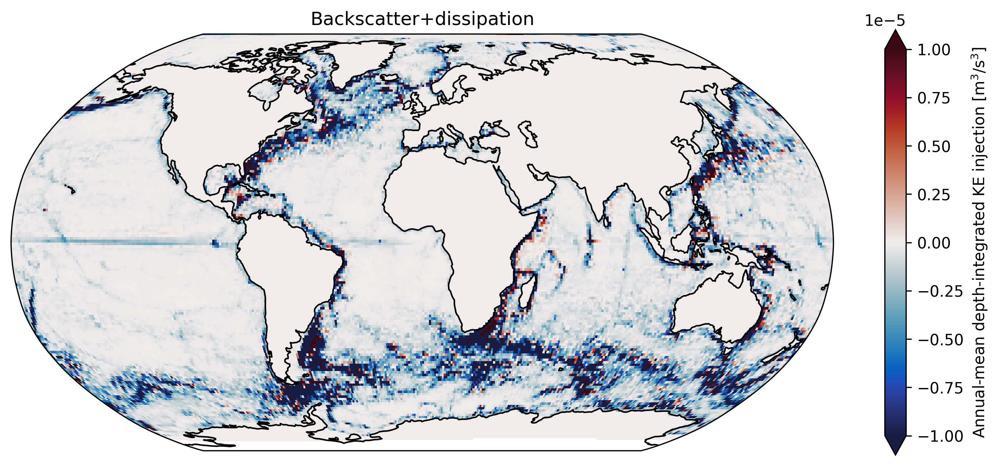

In [25]:
plot(KE_horvisc.sum('zl'), regridder_1x1, vmin=-1e-5, vmax=1e-5, cmap=cmocean.cm.balance, label='Annual-mean depth-integrated KE injection [$\mathrm{m^{3}}/\mathrm{s}^3$]')
plt.title('Backscatter+dissipation')

Text(0.5, 1.0, 'Backscatter+dissipation')

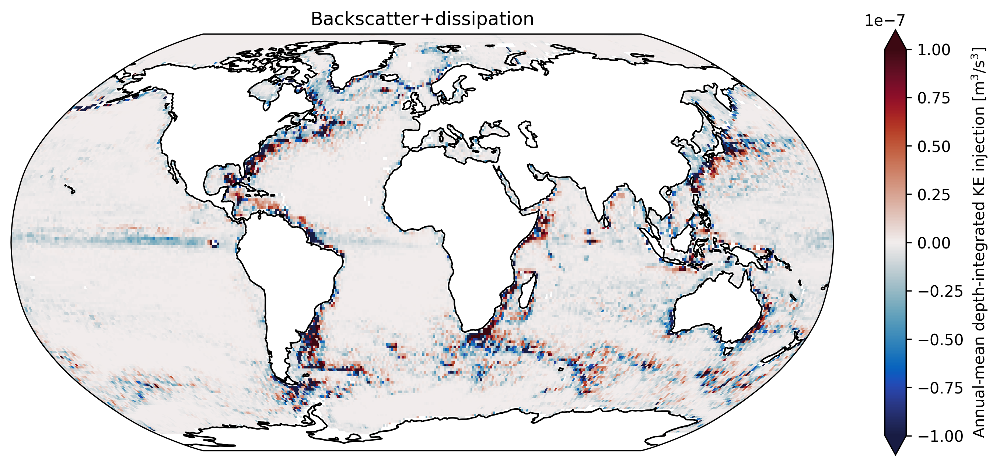

In [28]:
plot(KE_horvisc.isel(zl=0), regridder_1x1, vmin=-1e-7, vmax=1e-7, cmap=cmocean.cm.balance, label='Annual-mean depth-integrated KE injection [$\mathrm{m^{3}}/\mathrm{s}^3$]')
plt.title('Backscatter+dissipation')

<GeoAxes: xlabel='longitude', ylabel='latitude'>

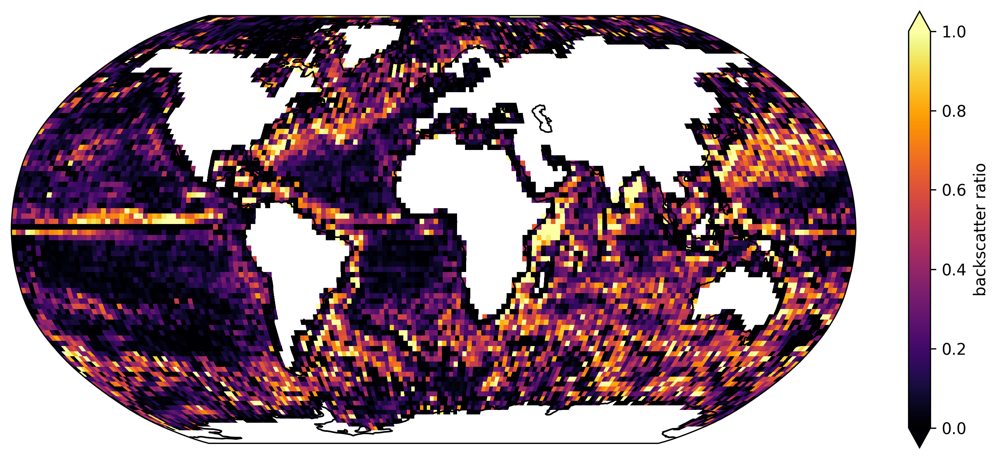

In [121]:
# Local backscatter ratio
ratio = -regridder_2x2((KE_ZB20).sum('zl')) /  regridder_2x2((KE_horvisc - KE_ZB20).sum('zl'))
plot(ratio, lambda x: x, vmin=0, vmax=1, cmap=plt.cm.inferno, label='backscatter ratio')

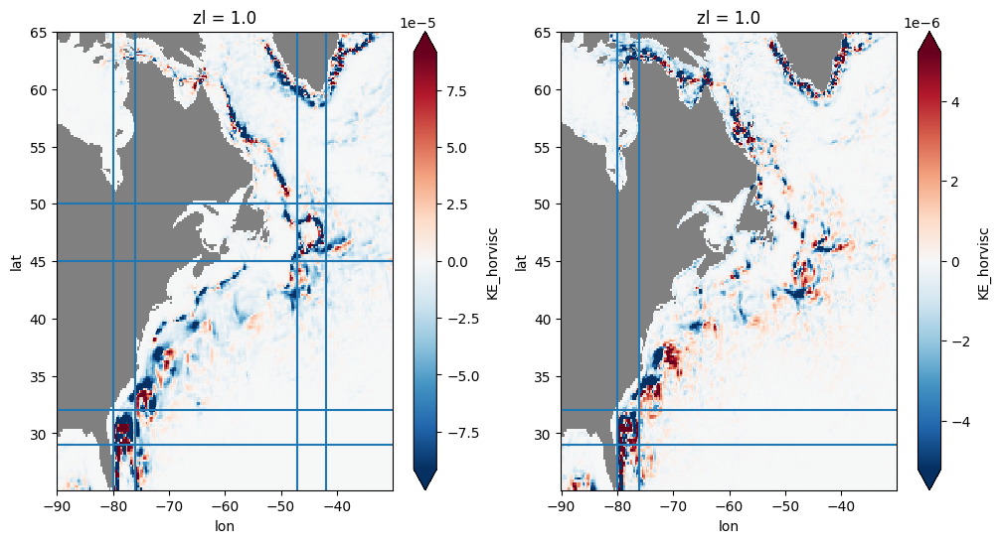

In [125]:
KE_local = KE_horvisc.sel(lon=slice(-90,-30),lat=slice(25,65))

mask = xr.where(np.isnan(KE_local.isel(zl=0)),np.nan,1.)

plt.figure(figsize=(12,6))
plt.subplot(1,2,1)
(KE_local.sum('zl')*mask).plot(robust=True)
plt.gca().set_facecolor('gray')
plt.axvline(x=-80)
plt.axvline(x=-76)
plt.axhline(y=32)
plt.axhline(y=29)

plt.axhline(y=45)
plt.axhline(y=50)
plt.axvline(x=-47)
plt.axvline(x=-42)


plt.subplot(1,2,2)
(KE_local[0:12].sum('zl')*mask).plot(robust=True)
plt.gca().set_facecolor('gray')
plt.axvline(x=-80)
plt.axvline(x=-76)
plt.axhline(y=32)
plt.axhline(y=29)


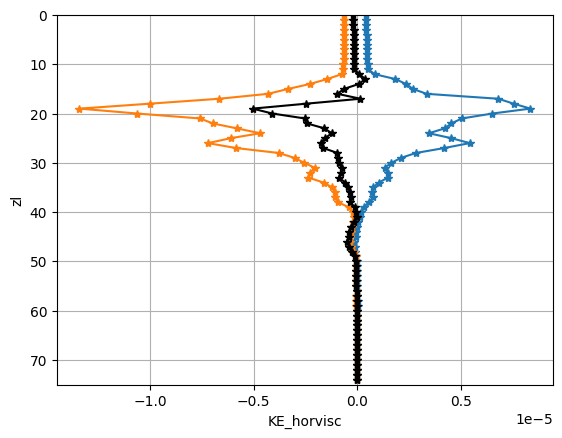

In [123]:
sel = lambda x: x.sel(lon=slice(-80,-76),lat=slice(29,32)).mean(['lon','lat']).drop_vars(['zl'])
sel(KE_ZB20).plot(y='zl', marker='*', label='Backscatter')
sel(KE_horvisc-KE_ZB20).plot(y='zl', marker='*', label='Dissipation')
sel(KE_horvisc).plot(y='zl', color='k', marker='*', label='Backscatter+Dossipation')
plt.ylim([0,75])
plt.gca().invert_yaxis()
plt.grid()

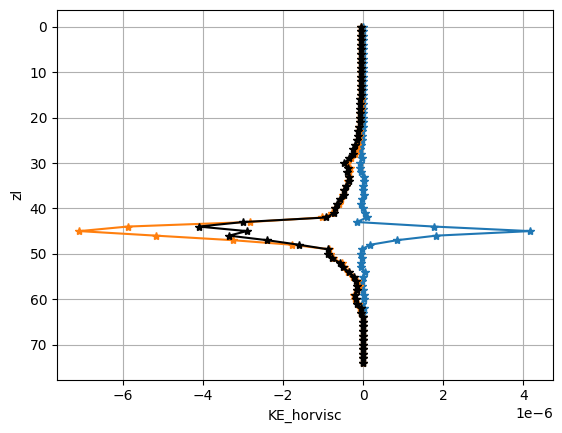

In [124]:
sel = lambda x: x.sel(lon=slice(-47,-42),lat=slice(45,50)).mean(['lon','lat']).drop_vars(['zl'])
sel(KE_ZB20).plot(y='zl', marker='*', label='Backscatter')
sel(KE_horvisc-KE_ZB20).plot(y='zl', marker='*', label='Dissipation')
sel(KE_horvisc).plot(y='zl', color='k', marker='*', label='Backscatter+Dossipation')
plt.gca().invert_yaxis()
plt.grid()

# Now show distirbution of subgrid forcing STD

In [4]:
%%time
from dask.diagnostics import ProgressBar
with ProgressBar():
    ZB20u_std = data.ZB2020u.chunk({'zl':1,'yh':100}).std('time').compute()
    ZB20v_std = data.ZB2020v.chunk({'zl':1,'yq':100}).std('time').compute()

[########################################] | 100% Completed | 112.40 s
[########################################] | 100% Completed | 109.50 s
CPU times: user 20min 11s, sys: 1min 52s, total: 22min 4s
Wall time: 4min 1s


In [7]:
ZB20std = grid.interp(ZB20u_std, 'X') + grid.interp(ZB20v_std, 'Y')

In [13]:
with ProgressBar():
    h_mean = h.mean('time').compute() # Time-averaged grid spacing for averaging

[########################################] | 100% Completed | 56.27 s


In [18]:
h_mean.astype('float32').to_netcdf('some-data/h_mean.nc')

In [19]:
def ave_z(x):
    return (x * h_mean).sum('zl') / (h_mean).sum('zl')

In [20]:
ZB20std_z = ave_z(ZB20std)

In [48]:
ZB20std_z.astype('float32').to_netcdf('some-data/ZB20std_z.nc')

# Comparison of std to energy injection on different grids

In [29]:
import cartopy.feature as cfeature
def plot(x, regrid=None, cmap=plt.cm.viridis,vmin=0,vmax=None, polar='False', label=None, land=False, gridlines=False, norm=None, central_longitude=0, psi=False):
    plt.figure(figsize=(12, 5), dpi=300)
    #cmap.set_bad('gray')
    if polar != 'False':
        if polar == 'North':
            ax = plt.axes(projection=ccrs.NorthPolarStereo())
            ax.set_extent([-300,60,50,90],ccrs.PlateCarree())
        elif polar == 'South':
            ax = plt.axes(projection=ccrs.SouthPolarStereo())
            ax.set_extent([-300,60,-90,-40],ccrs.PlateCarree())
    else:
        ax = plt.axes(projection=ccrs.Robinson(central_longitude=central_longitude))
    regrid(x).plot(ax=ax,x='lon', y='lat',robust=True, vmin=vmin, cmap=cmap, vmax=vmax, transform=ccrs.PlateCarree(), cbar_kwargs={'label':label}, norm=norm)
    if psi:
        ds['unparameterized'].barotropic_streamfunction.rename({'xq':'lon', 'yq':'lat'}).plot.contour(ax=ax, transform=ccrs.PlateCarree(),x='lon',y='lat',levels=np.arange(-200,200,10), colors='k', linewidths=0.5)
    if land:
        ax.add_feature(cfeature.LAND, color='gray', zorder=100)
    ax.coastlines(zorder=101)
    if gridlines:
        gl = ax.gridlines(draw_labels=True, linewidth=1,alpha=1.0, linestyle='-')
    return ax

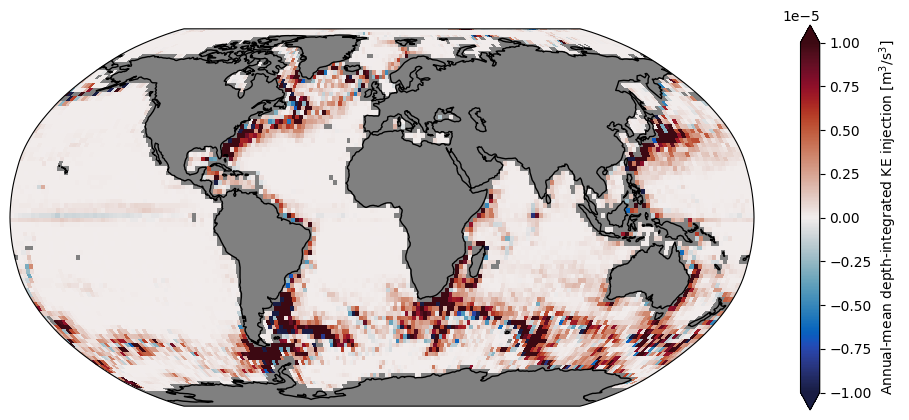

In [161]:
plot(KE_ZB20, regridder_2x2, vmin=-1e-5, vmax=1e-5, cmap=cmocean.cm.balance, label='Annual-mean depth-integrated KE injection [$\mathrm{m^{3}}/\mathrm{s}^3$]')

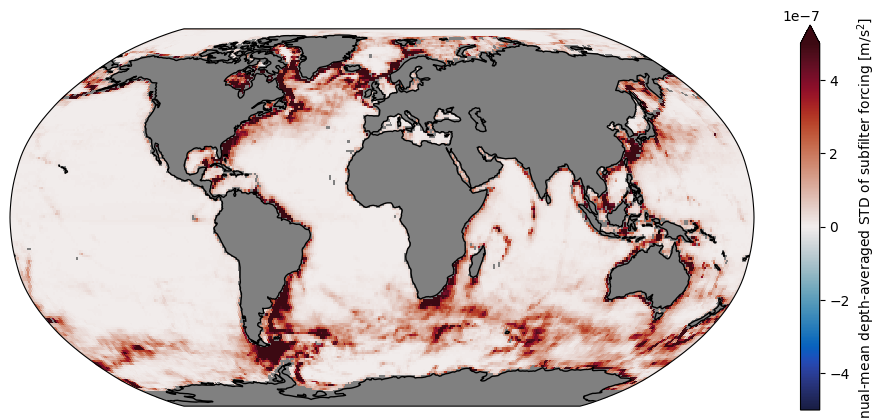

In [162]:
plot(ZB20std_z, regridder_1x1, cmap=cmocean.cm.balance, vmin=-5e-7, vmax=5e-7, label='Annual-mean depth-averaged STD of subfilter forcing [$\mathrm{m}/\mathrm{s}^2$]')

# KE budget

In [197]:
%%time
budget = {} # KE budget terms in Tera Watts (TW)
rho_ref = 1000. # Reference density in kg/m^3
tera_inverse = 1e-12 # Conversion of Watts to Tera Watts
with ProgressBar():
    for exp in ['unparameterized', 'ANN']:
        for key in ['dKE_dt', 'PE_to_KE', 'KE_BT', 'KE_Coradv', 'KE_adv', 'KE_visc', 'KE_stress', 'KE_horvisc', 'KE_dia', 'KE_ZB2020']:
            try:
                %time budget[f'{exp}-{key}'] = tera_inverse * rho_ref * float((ds[exp].budget[key] * ds[exp].param.dxt * ds[exp].param.dyt).sum(['zl', 'xh', 'yh']).mean('time'))
            except:
                pass

[########################################] | 100% Completed | 7.94 ss
CPU times: user 16.6 s, sys: 8.4 s, total: 25 s
Wall time: 8.01 s
[########################################] | 100% Completed | 6.73 ss
CPU times: user 16.8 s, sys: 8.39 s, total: 25.2 s
Wall time: 6.83 s
[########################################] | 100% Completed | 8.14 ss
CPU times: user 16.6 s, sys: 8.39 s, total: 25 s
Wall time: 8.24 s
[########################################] | 100% Completed | 7.53 ss
CPU times: user 16.6 s, sys: 8.43 s, total: 25 s
Wall time: 7.65 s
[########################################] | 100% Completed | 8.34 ss
CPU times: user 16.3 s, sys: 8.45 s, total: 24.8 s
Wall time: 8.41 s
[########################################] | 100% Completed | 8.34 ss
CPU times: user 16.4 s, sys: 8.4 s, total: 24.8 s
Wall time: 8.44 s
[########################################] | 100% Completed | 7.63 ss
CPU times: user 16.7 s, sys: 8.47 s, total: 25.1 s
Wall time: 7.7 s
[###################################

KeyError: "No variable named 'KE_ZB2020'. Variables on the dataset include ['dKE_dt', 'PE_to_KE', 'KE_BT', 'KE_Coradv', 'KE_adv', ..., 'zl', 'time', 'nv', 'xq', 'yq']"

[########################################] | 100% Completed | 7.83 ss
CPU times: user 16.5 s, sys: 8.47 s, total: 25 s
Wall time: 7.9 s
[########################################] | 100% Completed | 8.24 ss
CPU times: user 16.5 s, sys: 8.36 s, total: 24.8 s
Wall time: 8.34 s
[########################################] | 100% Completed | 8.34 ss
CPU times: user 16.5 s, sys: 8.43 s, total: 24.9 s
Wall time: 8.41 s
[########################################] | 100% Completed | 7.33 ss
CPU times: user 16.7 s, sys: 8.45 s, total: 25.1 s
Wall time: 7.41 s
[########################################] | 100% Completed | 7.94 ss
CPU times: user 16.5 s, sys: 8.44 s, total: 24.9 s
Wall time: 8.01 s
[########################################] | 100% Completed | 7.93 ss
CPU times: user 16.5 s, sys: 8.4 s, total: 24.9 s
Wall time: 8.01 s
[########################################] | 100% Completed | 7.74 ss
CPU times: user 16.8 s, sys: 8.39 s, total: 25.2 s
Wall time: 7.81 s
[##############################

In [255]:
xr.Dataset(budget).to_netcdf('some-data/budget.nc')

In [2]:
budget = xr.open_dataset('some-data/budget.nc')

In [3]:
x = []
keys = ['PE_to_KE', 'KE_visc', 'KE_horvisc']
for key in keys:
    x.append(budget[f'unparameterized-{key}'])

In [4]:
y = []
keys = ['PE_to_KE', 'KE_visc','KE_horvisc', 'KE_ZB2020']
for key in keys:
    if key == 'KE_horvisc':
        y.append(budget['ANN-KE_horvisc']-budget['ANN-KE_ZB2020'])
    else:
        y.append(budget[f'ANN-{key}'])

In [5]:
# PE_to_KE is a fair term coming from pressure acceleration
# dKE_dt includes contributions from thickness, so it cannot be a sum of remaining terms
# KE_adv, KE_BT are small
# KE_dia is zero
# KE_Coradv contains contribution to KE from continuity equation, and so its role is unclear
# KE_stress is included to KE_visc, and so we filter it out
# Having baroclinic accelerations to be
# u_bc_accel(I,j,k) = (CS%CAu_pred(I,j,k) + CS%PFu(I,j,k)) + CS%diffu(I,j,k)
# We probably need and accurate computation of CAu (Coriolis)

(-1.0, 4.0)

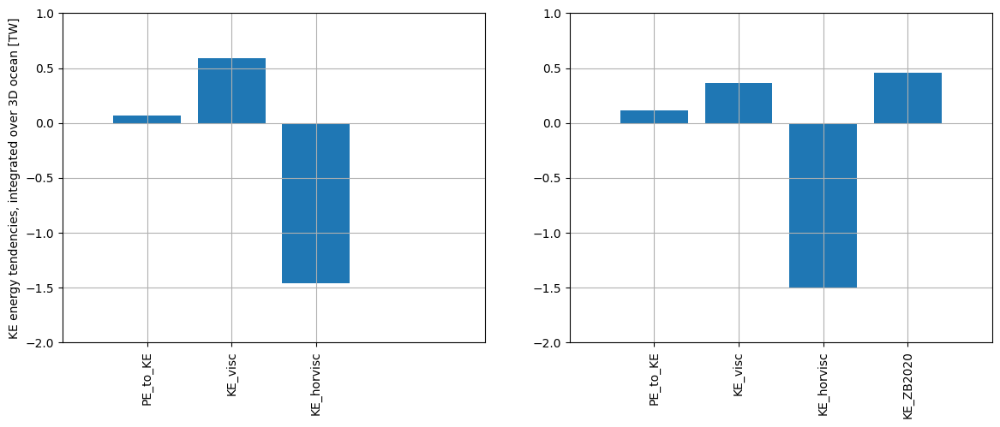

In [6]:
plt.figure(figsize=(14,5))
plt.subplot(1,2,1)
plt.bar(np.arange(len(x)), x)
plt.xticks(np.arange(len(x)), keys[:-1], rotation=90);
plt.ylabel("KE energy tendencies, integrated over 3D ocean [TW]")
plt.grid()
plt.ylim([-2,1])
plt.xlim([-1,4])

plt.subplot(1,2,2)
plt.bar(np.arange(len(y)), y)
plt.xticks(np.arange(len(y)), keys, rotation=90);
#plt.ylabel("KE energy tendencies, integrated over 3D ocean [TW]")
plt.grid()
plt.ylim([-2,1])
plt.xlim([-1,4])
# PearsonBachman2017 -  KE dissipation bu biharmonic operator is slightly lower than 1TW, but it was higher-resolution model (1/10)s 

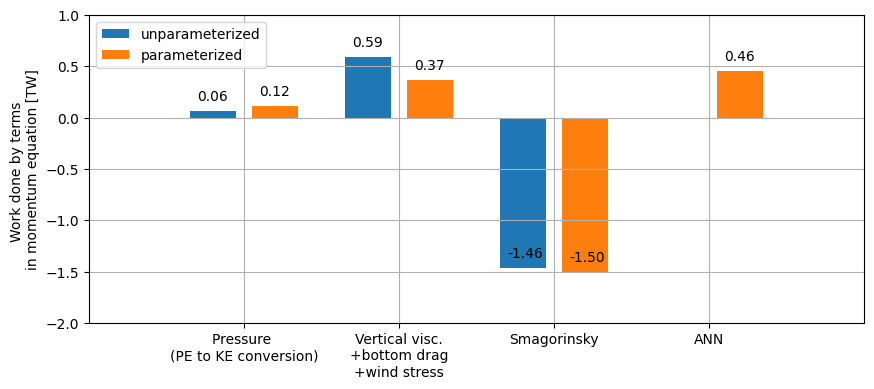

In [36]:
plt.figure(figsize=(10,4))
plt.bar(np.arange(0,3)-0.2, x, width=0.3, label='unparameterized')    
plt.bar(np.arange(0,4)+0.2, y, width=0.3, label='parameterized')
for j, xx in enumerate(x):
    plt.text(j-0.3, xx+0.1, '%.2f'%float(xx))
for j, xx in enumerate(y):
    plt.text(j+0.1, xx+0.1, '%.2f'%float(xx))

plt.legend()


plt.xticks(np.arange(len(y)), ['Pressure \n(PE to KE conversion)', 'Vertical visc.\n+bottom drag\n+wind stress', 'Smagorinsky', 'ANN']);
plt.ylabel('Work done by terms \nin momentum equation [TW]')
plt.ylim([-2,1])
plt.xlim([-1,4])
plt.grid()

# Increase of EKE

In [4]:
from helpers.computational_tools import create_grid_global
grid = create_grid_global(ds['ANN'].param)
param = ds['ANN'].param

In [10]:
def energy(data):
    data = data.chunk({'zl':1})
    h = (data.e.isel(zi=slice(0,-1)).drop_vars('zi') - data.e.isel(zi=slice(1,None)).drop_vars('zi')).rename({'zi': 'zl'})
    out = xr.Dataset()

    KEu = (data.uo**2 * grid.interp(h,'X') * 0.5).chunk({'yh':100}).mean('time').compute()
    KEv = (data.vo**2 * grid.interp(h,'Y') * 0.5).chunk({'xh':100}).mean('time').compute()
    
    out['KE'] = (grid.interp(KEu,'X') + grid.interp(KEv,'Y')).sum('zl')

    uom = data.uo.chunk({'yh':100}).mean('time').compute()
    vom = data.vo.chunk({'yq':100}).mean('time').compute()
    hm = h.chunk({'yh':100}).mean('time').compute()

    KEu = (uom**2 * grid.interp(hm,'X') * 0.5)
    KEv = (vom**2 * grid.interp(hm,'Y') * 0.5)

    out['MKE'] = (grid.interp(KEu,'X') + grid.interp(KEv,'Y')).sum('zl')

    out['EKE'] = out['KE'] - out['MKE']

    return out

In [26]:
%%time
from dask.diagnostics import ProgressBar
with ProgressBar():
    energy_ctrl = energy(ds['unparameterized'].ocean3d)

[########################################] | 100% Completed | 137.34 s
[########################################] | 100% Completed | 105.71 s
[########################################] | 100% Completed | 67.00 s
[########################################] | 100% Completed | 82.74 s
[########################################] | 100% Completed | 45.16 s
CPU times: user 26min 43s, sys: 6min 9s, total: 32min 53s
Wall time: 8min 23s


In [5]:
#energy_ctrl.astype('float32').to_netcdf('energy_ctrl.nc')
energy_ctrl = xr.open_dataset('energy_ctrl.nc')

In [35]:
%%time
from dask.diagnostics import ProgressBar
with ProgressBar():
    energy_ann = energy(ds['ANN'].ocean3d)

[########################################] | 100% Completed | 1.72 ss
[########################################] | 100% Completed | 115.07 s
[########################################] | 100% Completed | 100.64 s
[########################################] | 100% Completed | 90.38 s
[########################################] | 100% Completed | 71.26 s
[########################################] | 100% Completed | 44.05 s
CPU times: user 23min 55s, sys: 5min 53s, total: 29min 49s
Wall time: 8min 9s


In [6]:
#energy_ann.astype('float32').to_netcdf('energy_ann.nc')
energy_ann = xr.open_dataset('energy_ann.nc')

Text(0.5, 1.0, '$\\Delta$EKE')

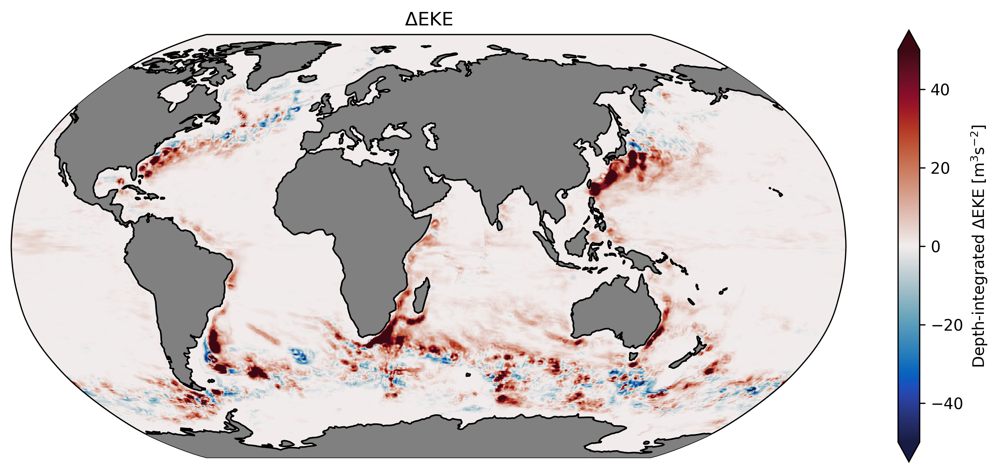

In [96]:
import matplotlib as mpl
#norm = mpl.colors.SymLogNorm(linthresh=1e+0, linscale=0.1, vmin=-1e+3, vmax=1e+3)
ax = plot(energy_ann['EKE']-energy_ctrl['EKE'], regrid=regridder_simple, vmin=-50,vmax=50, norm=None, cmap=cmocean.cm.balance,
    label='Depth-integrated $\Delta$EKE [m$^3$s$^{-2}$]', psi=False, land=True, central_longitude=50)
ax.set_title('$\Delta$EKE')

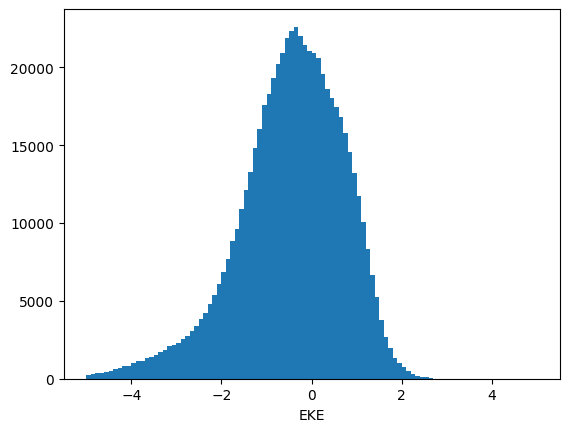

In [31]:
np.log10(energy_ann['EKE']-energy_ctrl['EKE']).plot.hist(range=(-5,5), bins=100);

Text(0.5, 1.0, '$\\Delta$MKE')

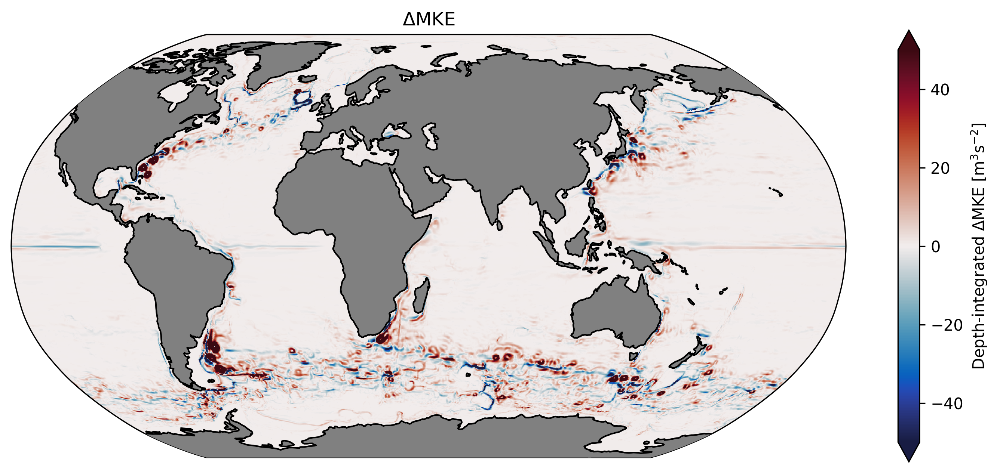

In [97]:
#norm = mpl.colors.SymLogNorm(linthresh=1e+0, linscale=0.1, vmin=-1e+3, vmax=1e+3)
ax = plot(energy_ann['MKE']-energy_ctrl['MKE'], regrid=regridder_simple, vmin=-50,vmax=50, norm=None, cmap=cmocean.cm.balance,
    label='Depth-integrated $\Delta$MKE [m$^3$s$^{-2}$]', psi=False, land=True, central_longitude=50)
ax.set_title('$\Delta$MKE')

In [56]:
# Eddies extract APE

In [60]:
with ProgressBar():
    PE_extraction_ann = ds['ANN'].budget.PE_to_KE.mean('time').sum('zl').compute()

[########################################] | 100% Completed | 12.77 s


In [61]:
with ProgressBar():
    PE_extraction_ctrl = ds['unparameterized'].budget.PE_to_KE.mean('time').sum('zl').compute()

[########################################] | 100% Completed | 511.04 ms
[########################################] | 100% Completed | 15.71 s


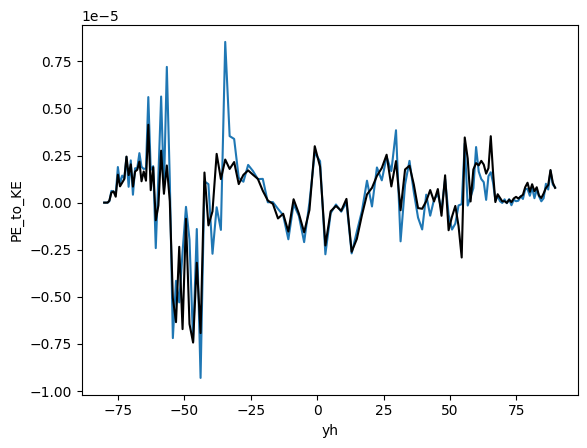

In [81]:
PE_extraction_ann.coarsen({'yh':8}).mean().mean('xh').plot()
PE_extraction_ctrl.coarsen({'yh':8}).mean().mean('xh').plot(color='k')

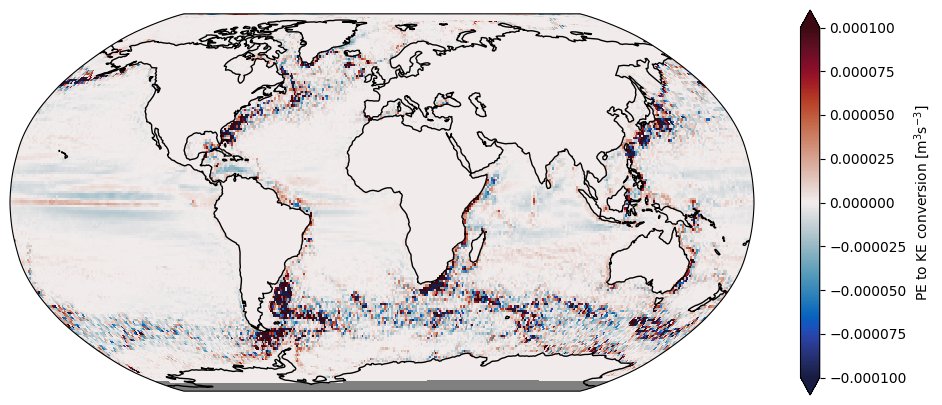

In [90]:
plot(PE_extraction_ann, regrid=regridder_1x1, vmin=-1e-4, cmap=cmocean.cm.balance,
    label='PE to KE conversion [m$^3$s$^{-3}$]')

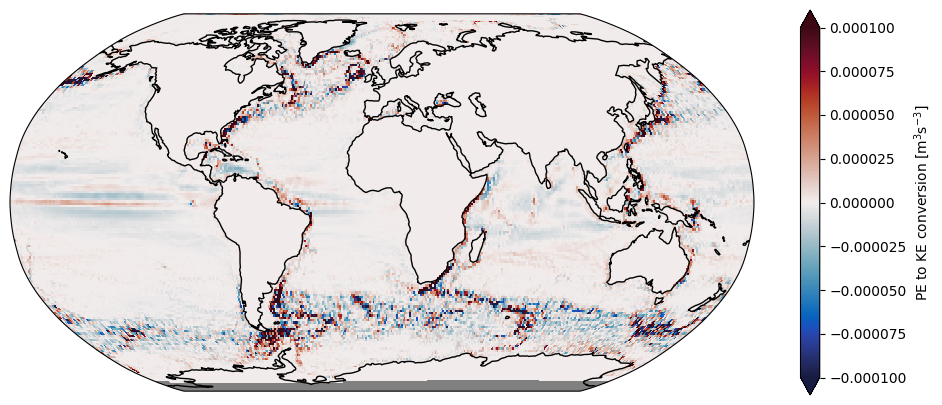

In [91]:
plot(PE_extraction_ctrl, regrid=regridder_1x1, vmin=-1e-4, cmap=cmocean.cm.balance,
    label='PE to KE conversion [m$^3$s$^{-3}$]')

# Direct computation of APE extraction is difficult. But can we estimate distribution of where APE changed? 

In [3]:
Z0 = -xr.open_dataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/unparameterized/diagnostics/ocean.stats.nc', decode_times=False).H0
reference_height = Z0[:-1].coarsen({'Time':20}).mean().drop_vars('Time').rename({'Time': 'time', 'Interface': 'zi'})
reference_height['time'] = ds['unparameterized'].ocean3d.time

In [4]:
Z0 = -xr.open_dataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/ANN/diagnostics/ocean.stats.nc', decode_times=False).H0
reference_height_ann = Z0[:-1].coarsen({'Time':20}).mean().drop_vars('Time').rename({'Time': 'time', 'Interface': 'zi'})
reference_height_ann['time'] = ds['ANN'].ocean3d.time

In [5]:
eta = ds['unparameterized'].ocean3d.e
eta_ann = ds['ANN'].ocean3d.e

In [48]:
# Computing reduced gravity
# I assume that the target densities can be taken from MOM_paramered.doc.all
#TARGET_DENSITIES = xr.DataArray([1010.0, 1014.3034, 1017.8088, 1020.843, 1023.5566, 1025.813, 1027.0275, 1027.9114, 1028.6422, 1029.2795, 1029.852, 1030.3762, 1030.8626, 1031.3183, 1031.7486, 1032.1572, 1032.5471, 1032.9207, 1033.2798, 1033.6261, 1033.9608, 1034.2519, 1034.4817, 1034.6774, 1034.8508, 1035.0082, 1035.1533, 1035.2886, 1035.4159, 1035.5364, 1035.6511, 1035.7608, 1035.8661, 1035.9675, 1036.0645, 1036.1554, 1036.2411, 1036.3223, 1036.3998, 1036.4739, 1036.5451, 1036.6137, 1036.68, 1036.7441, 1036.8062, 1036.8526, 1036.8874, 1036.9164, 1036.9418, 1036.9647, 1036.9857, 1037.0052, 1037.0236, 1037.0409, 1037.0574, 1037.0738, 1037.0902, 1037.1066, 1037.123, 1037.1394, 1037.1558, 1037.1722, 1037.1887, 1037.206, 1037.2241, 1037.2435, 1037.2642, 1037.2866, 1037.3112, 1037.3389, 1037.3713, 1037.4118, 1037.475, 1037.6332, 1037.8104, 1038.0], dims='zl')
#print(len(TARGET_DENSITIES))

In [6]:
TARGET_DENSITIES = xr.open_dataset('/scratch/pp2681/mom6/OM4_SIS2/zip-60-years/INPUT/layer_coord.nc').Layer

In [7]:
RHO0 = 1035.
GFS = 9.8
G_prime = np.zeros(76)
G_prime[0] = GFS
G_prime[-1] = 0. # There is no energy of bottom layer
G_prime[1:-1] = GFS * np.diff(TARGET_DENSITIES) / RHO0
G_prime = xr.DataArray(G_prime, dims='zi')

In [8]:
print(G_prime.shape)
G_prime

(76,)


<xarray.DataArray (zi: 76)> Size: 608B
array([9.80000000e+00, 3.28844444e-02, 3.28844444e-02, 3.28844444e-02,
       3.28749758e-02, 3.28844444e-02, 3.20512077e-02, 7.07304348e-03,
       5.68115942e-03, 4.53545894e-03, 3.66434783e-03, 3.08676329e-03,
       2.71748792e-03, 2.45236715e-03, 2.30086957e-03, 2.19671498e-03,
       2.09256039e-03, 2.00734300e-03, 1.93159420e-03, 1.81797101e-03,
       1.72328502e-03, 1.63806763e-03, 1.53391304e-03, 1.43922705e-03,
       1.34454106e-03, 1.23091787e-03, 1.12676329e-03, 1.04154589e-03,
       9.56328502e-04, 8.80579710e-04, 8.23768116e-04, 7.57487923e-04,
       7.10144928e-04, 6.62801932e-04, 6.34396135e-04, 6.05990338e-04,
       5.87053140e-04, 5.68115942e-04, 5.58647343e-04, 5.39710145e-04,
       5.39710145e-04, 5.20772947e-04, 5.01835749e-04, 4.45024155e-04,
       3.88212560e-04, 3.50338164e-04, 3.12463768e-04, 2.74589372e-04,
       2.46183575e-04, 2.17777778e-04, 1.89371981e-04, 1.70434783e-04,
       1.60966184e-04, 1.42028986e-04, 1.32560386e-04, 1.23091787e-04,
       1.32560386e-04, 1.23091787e-04, 1.32560386e-04, 1.23091787e-04,
       1.23091787e-04, 1.32560386e-04, 1.23091787e-04, 1.42028986e-04,
       1.51497585e-04, 1.79903382e-04, 2.17777778e-04, 2.74589372e-04,
       3.97681159e-04, 5.49178744e-04, 6.72270531e-04, 8.52173913e-04,
       1.01314010e-03, 1.11729469e-03, 1.10782609e-03, 0.00000000e+00])
Dimensions without coordinates: zi

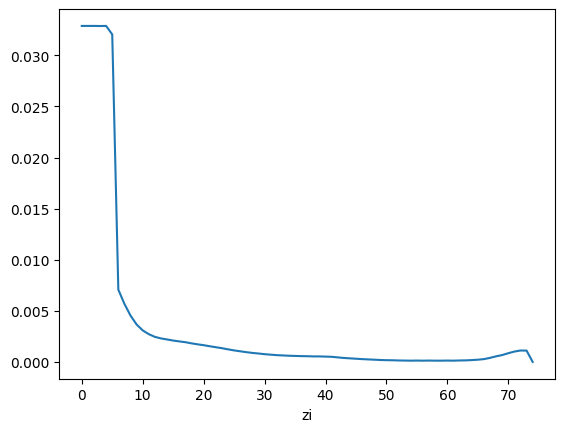

In [9]:
G_prime[1:].plot()

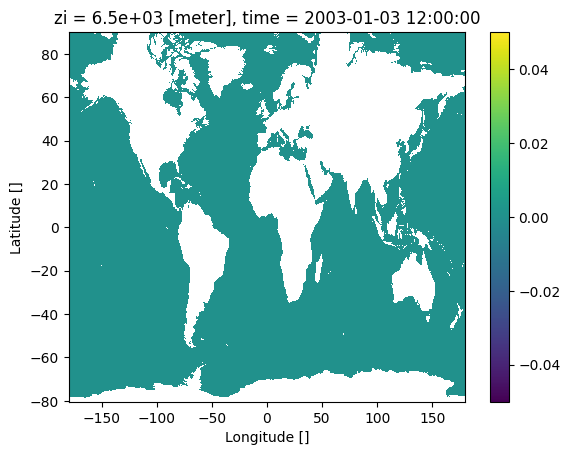

In [44]:
# Lowest interface is indeed the depth of the ocean
(param.deptho + eta.isel(time=0,zi=-1)).plot()

In [10]:
def APE(interface, interface_rest, g):
    coordinate_of_bottom = interface.isel(zi=-1).drop_vars(['zi'])
    
    hint = interface - interface_rest
    
    # Where bottom is upper than the rest interface
    hbot = np.maximum(coordinate_of_bottom - interface_rest,0)
    
    APE_instant = (0.5 * g * (hint**2))
    APE_constant = (0.5 * g * (hbot**2))
    
    return (APE_instant - APE_constant)

In [12]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    APE_ctrl = APE(eta, reference_height, G_prime).mean('time').compute()

[########################################] | 100% Completed | 98.93 s


In [14]:
param = ds['ANN'].param
APE_vertical = (RHO0 * APE_ctrl * param.dxt * param.dyt).sum(['xh', 'yh'])
APE_from_series = xr.open_dataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/unparameterized/diagnostics/ocean.stats.nc', decode_times=False).APE.mean('Time')

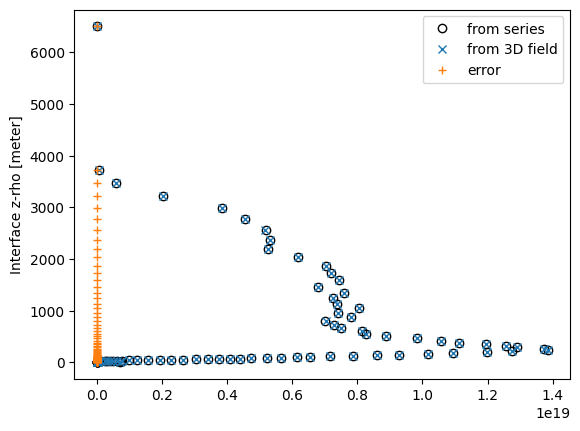

In [15]:
APE_from_series.plot(y='Interface', ls='', marker='o', markerfacecolor='none', color='k', label='from series')
APE_vertical.plot(y='zi',ls='', marker='x', label='from 3D field')
(APE_from_series.values-APE_vertical).plot(y='zi',ls='', marker='+', label='error')
plt.legend()

In [16]:
APE_from_series.sum()

<xarray.DataArray 'APE' ()> Size: 8B
array(3.90697415e+20)

In [17]:
APE_vertical.sum()

<xarray.DataArray ()> Size: 8B
array(3.90750051e+20)

In [18]:
APE_ctrl.to_netcdf('APE_ctrl.nc')

In [19]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    APE_ann = APE(eta_ann, reference_height_ann, G_prime).mean('time').compute()

[########################################] | 100% Completed | 100.42 s


In [20]:
APE_vertical = (RHO0 * APE_ann * param.dxt * param.dyt).sum(['xh', 'yh'])
APE_from_series = xr.open_dataset('/scratch/js15017/OM4_storage/CORE-AIF-runs/ANN/diagnostics/ocean.stats.nc', decode_times=False).APE.mean('Time')

<xarray.DataArray 'APE' ()> Size: 8B
array(3.63857047e+20)
<xarray.DataArray ()> Size: 8B
array(3.63875163e+20)


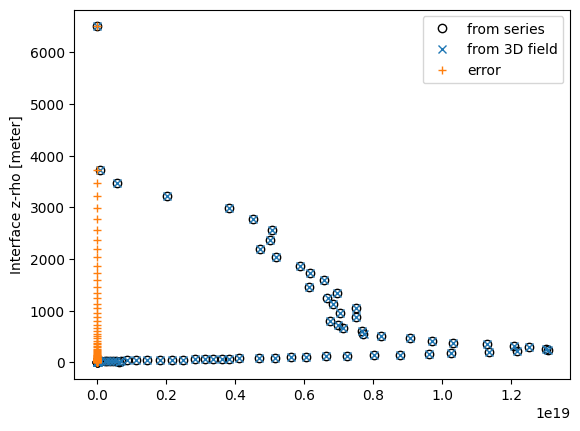

In [22]:
APE_from_series.plot(y='Interface', ls='', marker='o', markerfacecolor='none', color='k', label='from series')
APE_vertical.plot(y='zi',ls='', marker='x', label='from 3D field')
(APE_from_series.values-APE_vertical).plot(y='zi',ls='', marker='+', label='error')
plt.legend()
print(APE_from_series.sum())
print(APE_vertical.sum())

In [24]:
APE_ann.to_netcdf('APE_ann.nc')

Text(0.5, 1.0, '$\\Delta$APE')

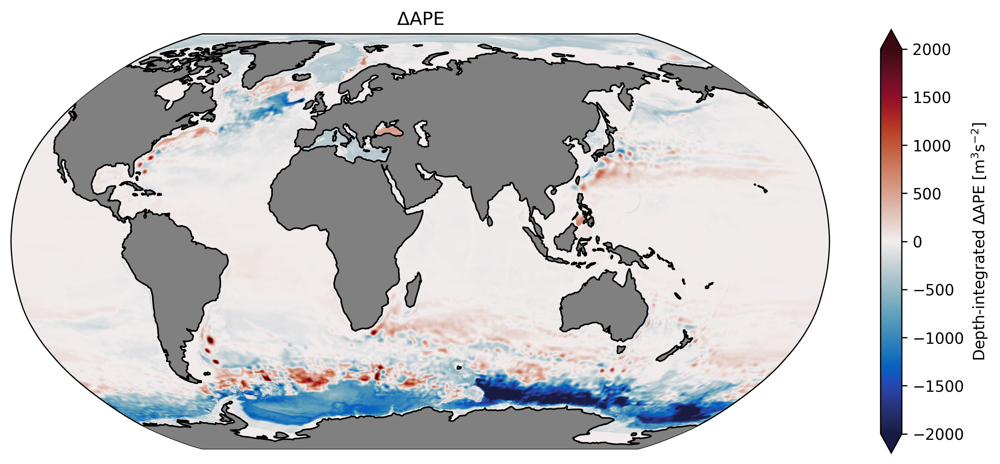

In [30]:
#norm = mpl.colors.SymLogNorm(linthresh=1e+2, linscale=0.1, vmin=-1e+4, vmax=1e+4)
ax = plot((APE_ann - APE_ctrl).sum('zi'), regrid=regridder_simple, vmin=-2000,vmax=2000, norm=None, cmap=cmocean.cm.balance,
    label='Depth-integrated $\Delta$APE [m$^3$s$^{-2}$]', psi=False, land=True, central_longitude=50)
ax.set_title('$\Delta$APE')

# Does it impact the mean flow

In [90]:
dpsi = ds['ANN'].barotropic_streamfunction - ds['unparameterized'].barotropic_streamfunction

<GeoAxes: xlabel='longitude', ylabel='latitude'>

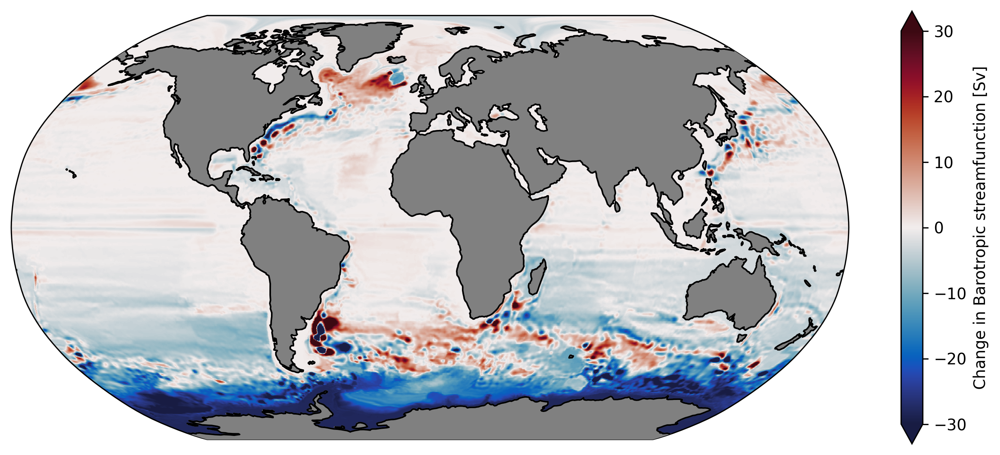

In [96]:
plot(dpsi, regrid=regridder_simple,vmin=-30, cmap=cmocean.cm.balance, label='Change in Barotropic streamfunction [Sv]', land=True)
#regridder_simple(ds['unparameterized'].barotropic_streamfunction).plot.contour(x='lon',y='lat',levels=np.arange(-200,200), colors='k')

Text(0.5, 1.0, '$\\Delta \\Psi$')

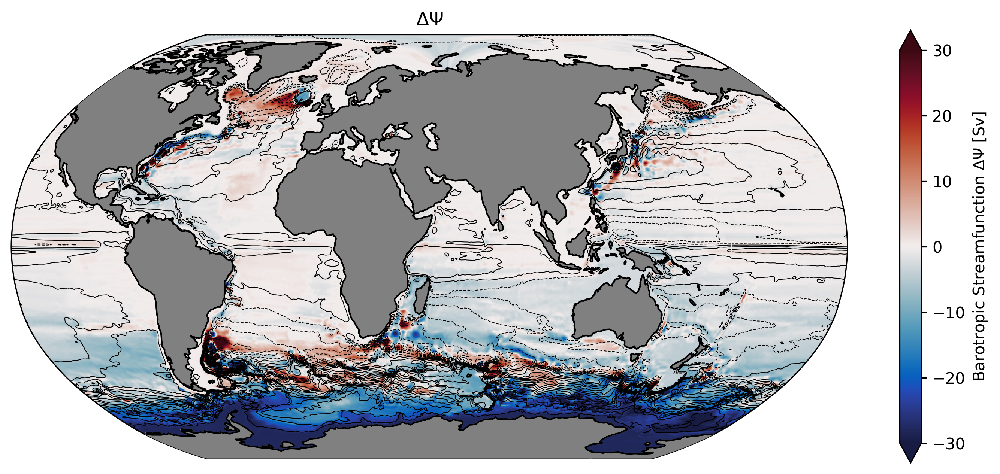

In [103]:
#norm = mpl.colors.SymLogNorm(linthresh=1e+0, linscale=0.1, vmin=-1e+2, vmax=1e+2)
ax = plot(dpsi, regrid=regridder_simple, vmin=-30,vmax=30, norm=None, cmap=cmocean.cm.balance,
    label='Barotropic Streamfunction $\Delta\Psi$ [Sv]', psi=True, land=True, central_longitude=50)
ax.set_title('$\Delta \Psi$')

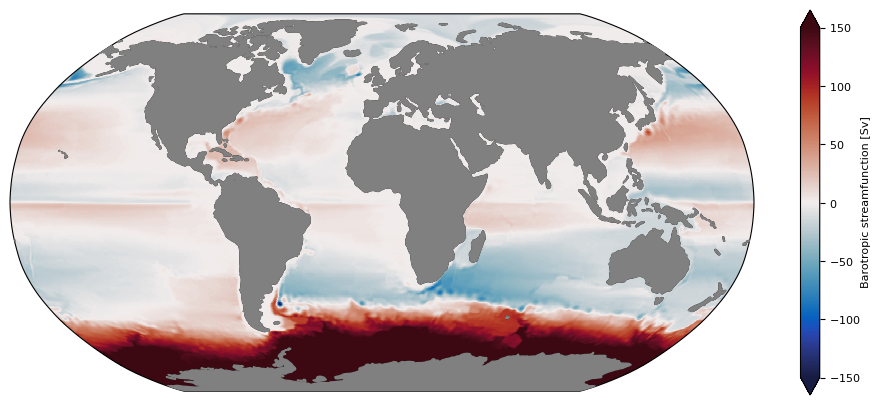

In [143]:
plot(ds['unparameterized'].barotropic_streamfunction, regrid=regridder_simple,vmin=-150, cmap=cmocean.cm.balance, label='Barotropic streamfunction [Sv]', land=True)

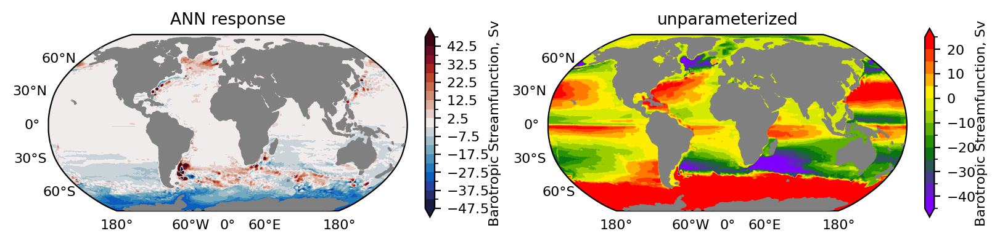

In [157]:
ds.plot_psi(['ANN', 'unparameterized'], plot_type='response', select=select_globe, projection='3D')

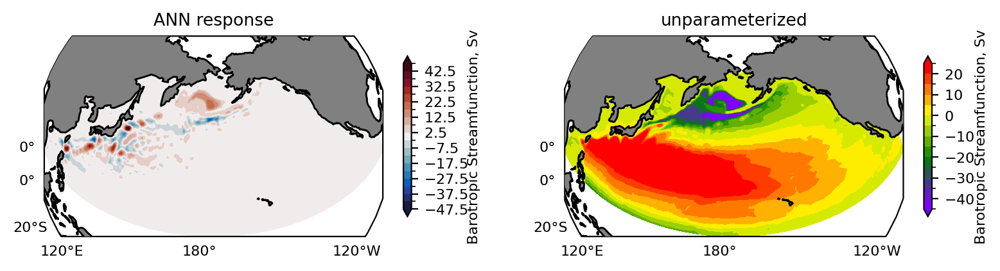

In [158]:
ds.plot_psi(['ANN', 'unparameterized'], plot_type='response', select=select_Pacific, projection='3D')

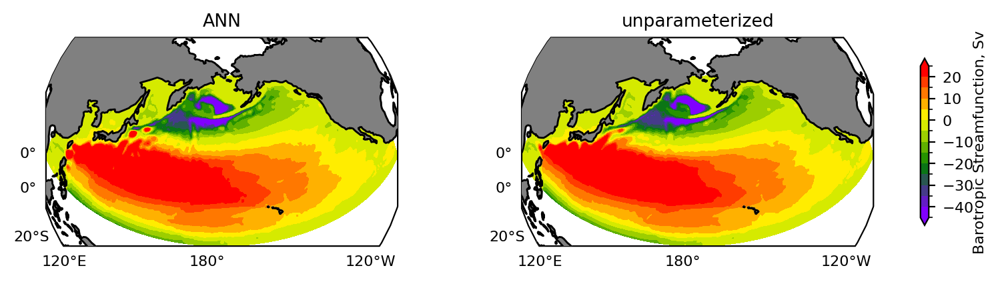

In [159]:
ds.plot_psi(['ANN', 'unparameterized'], plot_type='default', select=select_Pacific, projection='3D')

# Eddy-induced streamfunction

In [3]:
from helpers.computational_tools import create_grid_global
grid = create_grid_global(ds['unparameterized'].param)
param = ds['unparameterized'].param

In [60]:
data = ds['ANN'].ocean3d
e = data.e
h = (e.isel(zi=slice(0,-1)).drop_vars('zi') - e.isel(zi=slice(1,None)).drop_vars('zi')).rename({'zi': 'zl'})
vh = data.vh
vo = data.vo

In [61]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    h_mean = h.chunk({'zl':1, 'yh':100}).mean('time').compute()

[########################################] | 100% Completed | 80.63 s


In [62]:
with ProgressBar():
    e_mean = e.chunk({'zi':1, 'yh':100}).mean('time').compute()

[########################################] | 100% Completed | 68.32 s


In [63]:
with ProgressBar():
    vo_mean = vo.chunk({'zl':1, 'yq':100}).mean('time').compute()

[########################################] | 100% Completed | 68.34 s


In [64]:
with ProgressBar():
    vh_mean = vh.chunk({'zl':1, 'yq':100}).mean('time').compute()

[########################################] | 100% Completed | 70.48 s


In [65]:
vh_euler = vo_mean * grid.interp(h_mean,'Y') * param.dxCv
vh_eddy = vh_mean - vh_euler

In [66]:
_data = ds['ANN'].ocean_annual_z[['umo', 'vmo', 'z_i']].sel(time='2003').drop_vars('time').squeeze()
vmo_read = _data['vmo']

In [67]:
zi = ds['unparameterized'].ocean_annual_z.z_i
zl = ds['unparameterized'].ocean_annual_z.zl
depth_coord = - grid.interp((e_mean[0:-1].drop_vars('zi') + e_mean[1:None].drop_vars('zi'))*0.5,'Y').rename({'zi':'zl'})
rho0 = 1035.


In [68]:
%%time
vmo_euler = xr.zeros_like(vmo_read).copy()
for j in range(len(zl)):
    vmo_euler[j,:,:] = xr.where(np.logical_and(depth_coord>zi[j], depth_coord<=zi[j+1]),vh_euler,0.).sum('zl')
vmo_euler = (vmo_euler * rho0).compute()

CPU times: user 18.8 s, sys: 12.2 s, total: 31 s
Wall time: 31 s


In [69]:
%%time
vmo_eddy = xr.zeros_like(vmo_read).copy()
for j in range(len(zl)):
    vmo_eddy[j,:,:] = xr.where(np.logical_and(depth_coord>zi[j], depth_coord<=zi[j+1]),vh_eddy,0.).sum('zl')
vmo_eddy = (vmo_eddy * rho0).compute()

CPU times: user 18.8 s, sys: 12.2 s, total: 30.9 s
Wall time: 31 s


In [70]:
%%time
vmo_mean = xr.zeros_like(vmo_read).copy()
for j in range(len(zl)):
    vmo_mean[j,:,:] = xr.where(np.logical_and(depth_coord>zi[j], depth_coord<=zi[j+1]),vh_mean,0.).sum('zl')
vmo_mean = (vmo_mean * rho0).compute()

CPU times: user 18.7 s, sys: 12.2 s, total: 30.9 s
Wall time: 31 s


In [71]:
vmo_euler.astype('float32').to_netcdf('some-data/ann_vmo_euler.nc')

In [72]:
vmo_mean.astype('float32').to_netcdf('some-data/ann_vmo_mean.nc')

In [73]:
vmo_eddy.astype('float32').to_netcdf('some-data/ann_vmo_eddy.nc')

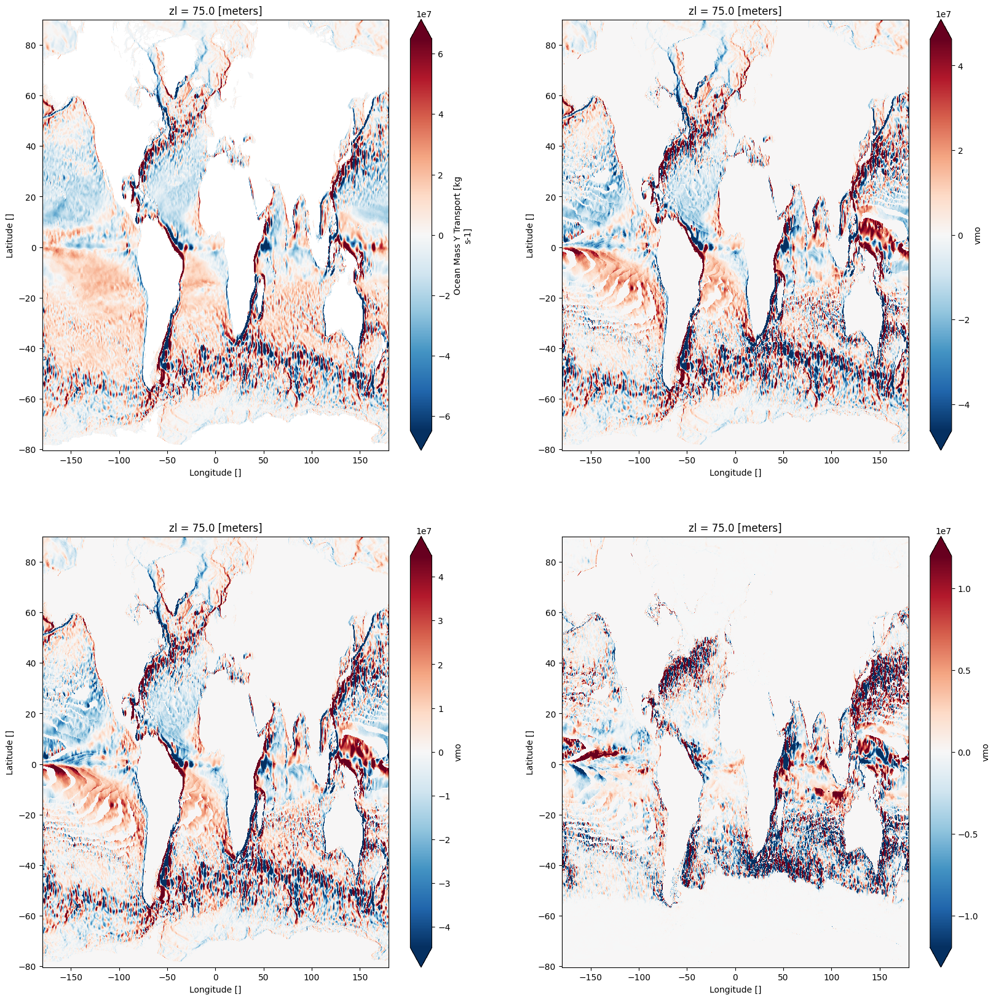

In [74]:
plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
(vmo_read.isel(zl=5)).plot(robust=True)
plt.subplot(2,2,2)
((vmo_mean).isel(zl=5)).plot(robust=True)
plt.subplot(2,2,3)
((vmo_euler).isel(zl=5)).plot(robust=True)
plt.subplot(2,2,4)
((vmo_eddy).isel(zl=5)).plot(robust=True)

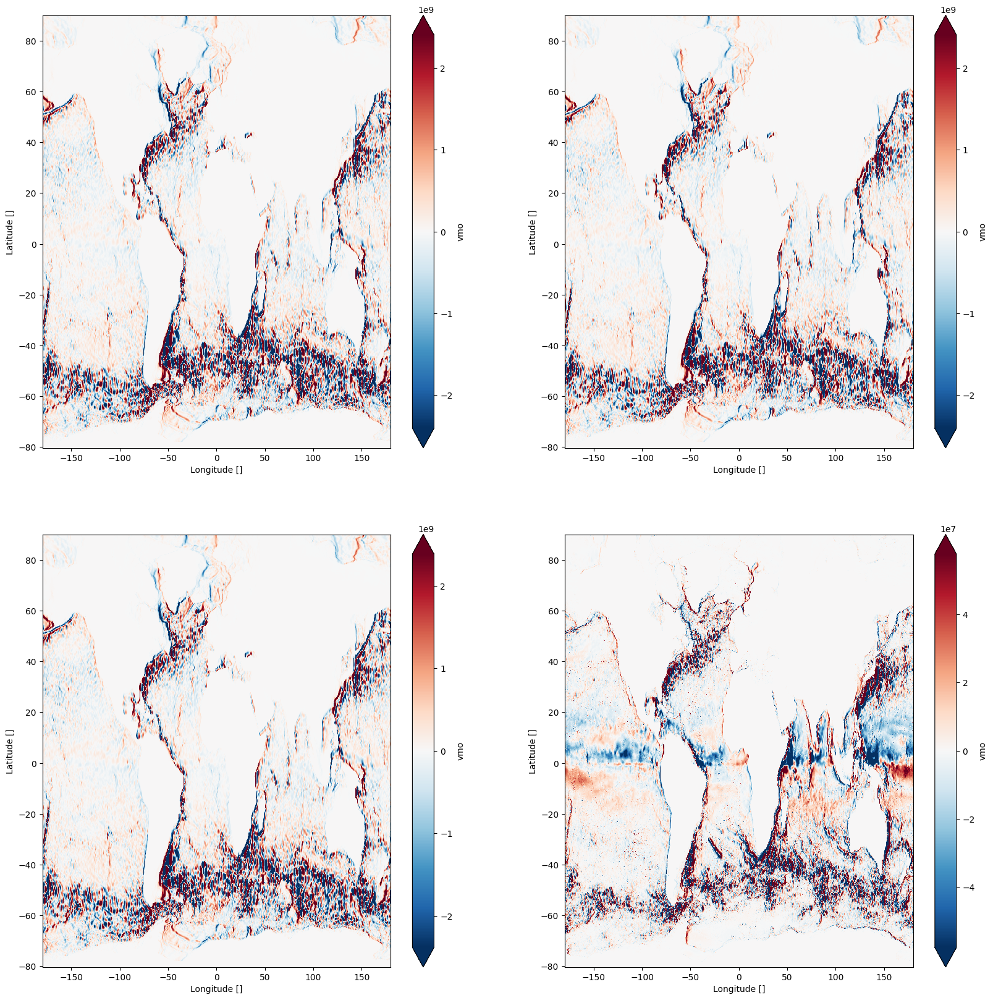

In [75]:
plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
(vmo_read.sum('zl')).plot(robust=True)
plt.subplot(2,2,2)
((vmo_mean).sum('zl')).plot(robust=True)
plt.subplot(2,2,3)
((vmo_euler).sum('zl')).plot(robust=True)
plt.subplot(2,2,4)
((vmo_eddy).sum('zl')).plot(robust=True)

In [76]:
from xoverturning import calcmoc
_data['umo'] = _data['umo'] * 0


_data['vmo'] = vmo_read
amoc_read = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='atl-arc').compute()

_data['vmo'] = vmo_mean
amoc_mean = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='atl-arc').compute()

_data['vmo'] = vmo_eddy
amoc_eddy = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='atl-arc').compute()

_data['vmo'] = vmo_euler
amoc_euler = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='atl-arc').compute()

generating basin codes
generating basin codes
generating basin codes
generating basin codes


Text(0.5, 1.0, 'Eddy-induced')

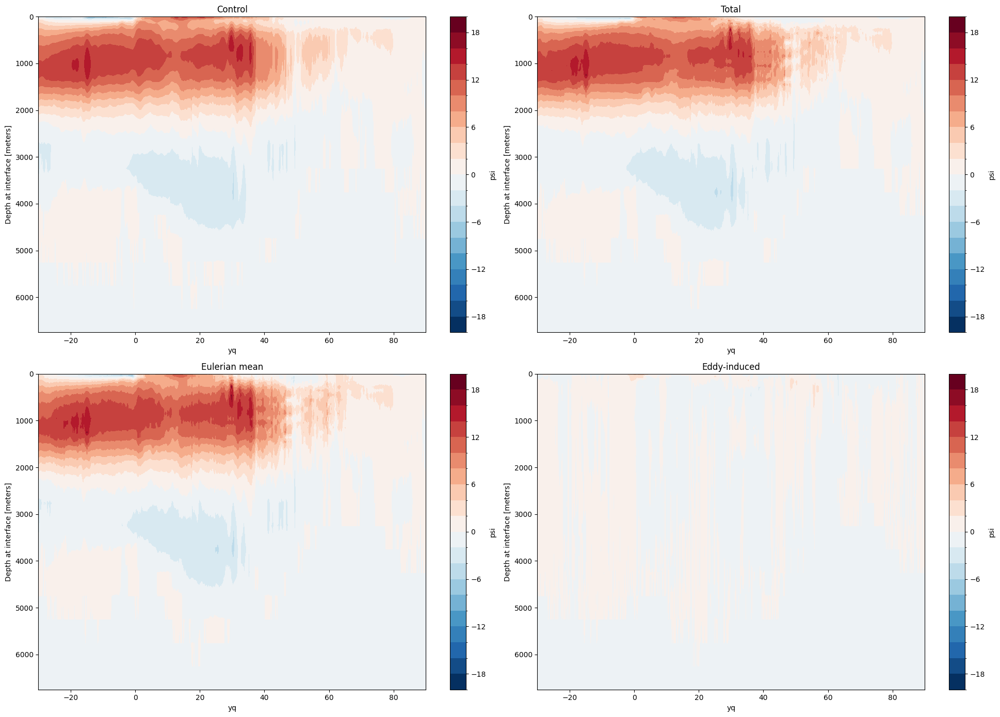

In [78]:
plt.figure(figsize=(20,14))
plt.subplot(2,2,1)
amoc_read.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])
plt.title('Control')

plt.subplot(2,2,2)
amoc_mean.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])
plt.title('Total')

plt.subplot(2,2,3)
amoc_euler.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])
plt.title('Eulerian mean')

plt.subplot(2,2,4)
amoc_eddy.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])
plt.title('Eddy-induced')

In [79]:
from xoverturning import calcmoc
_data['umo'] = _data['umo'] * 0


_data['vmo'] = vmo_read
amoc_read = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='global').compute()

_data['vmo'] = vmo_mean
amoc_mean = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='global').compute()

_data['vmo'] = vmo_eddy
amoc_eddy = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='global').compute()

_data['vmo'] = vmo_euler
amoc_euler = calcmoc(_data.rename({'zl':'z_l'}), dsgrid=param, basin='global').compute()

generating basin codes
generating basin codes
generating basin codes
generating basin codes


Text(0.5, 1.0, 'Eddy-induced')

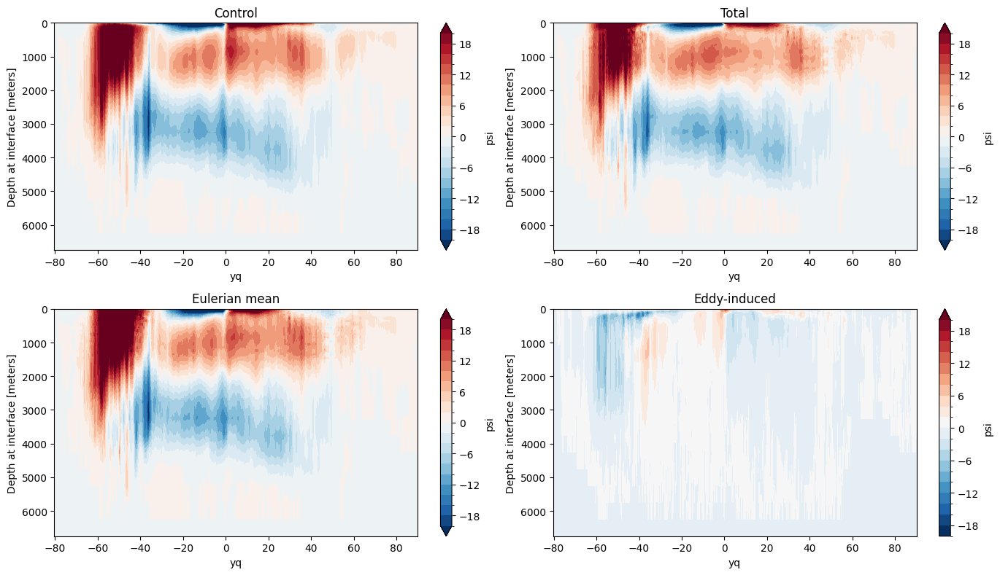

In [80]:
plt.figure(figsize=(14,8))
plt.subplot(2,2,1)
amoc_read.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.title('Control')

plt.subplot(2,2,2)
amoc_mean.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.title('Total')

plt.subplot(2,2,3)
amoc_euler.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.title('Eulerian mean')

plt.subplot(2,2,4)
amoc_eddy.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.title('Eddy-induced')

# Mixed Layer Depth

In [82]:
MLD_winter_restart_file = sort_longitude(xr.open_mfdataset('/scratch/pp2681/mom6/OM4_SIS2/unparameterized/output/*ocean_month*').MLD_003.sel(time='1978').max('time'))

In [83]:
MLD_winter_om5_gfdl = sort_longitude(xr.open_mfdataset('/vast/pp2681/cross-vesri-folder-MLDs/om5b04control/*MLD_003.*')).MLD_003.groupby('time.month').mean().max('month').compute()

In [94]:
ML_winter_from_WOA=ds['ZB20-from-WOA'].ocean_month.MLD_003.sel(time='1948').max('time')

In [84]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    MLD_winter_ctrl = ds['unparameterized'].ocean_month.MLD_003.sel(time=slice('1981', '2007')).groupby('time.month').mean().max('month').compute()

[########################################] | 100% Completed | 12.96 s
[########################################] | 100% Completed | 21.29 s


In [85]:
with ProgressBar():
    MLD_summer_ctrl = ds['unparameterized'].ocean_month.MLD_003.sel(time=slice('1981', '2007')).groupby('time.month').mean().min('month').compute()

[########################################] | 100% Completed | 4.73 sms


In [86]:
MLD_winter_obs = ds['unparameterized'].MLD_winter_obs
MLD_summer_obs = ds['unparameterized'].MLD_summer_obs

In [87]:
MLD_winter_ann = ds['ANN'].ocean_month.MLD_003.sel(time=slice('1981', '2007')).groupby('time.month').mean().max('month').compute()

In [88]:
MLD_summer_ann = ds['ANN'].ocean_month.MLD_003.sel(time=slice('1981', '2007')).groupby('time.month').mean().min('month').compute()

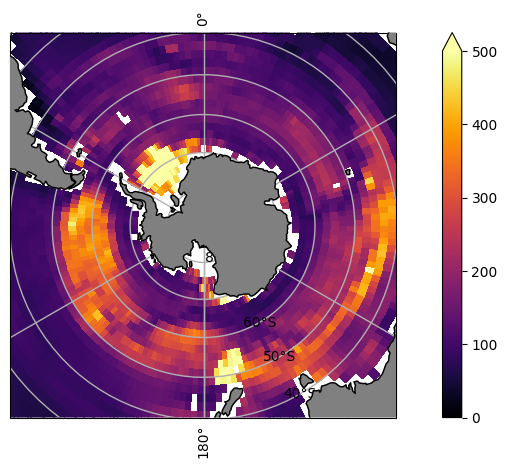

In [29]:
plot(MLD_winter_ctrl, regridder_2x2, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

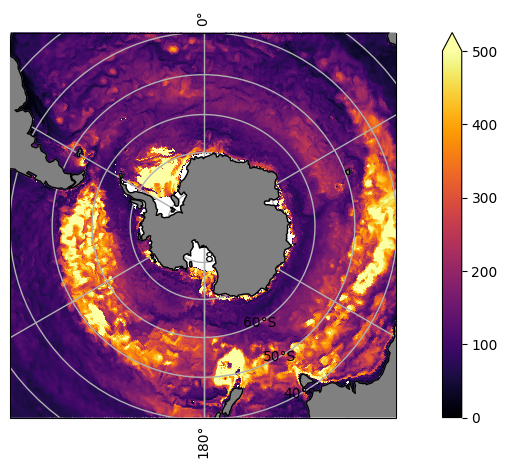

In [175]:
plot(MLD_winter_restart_file, regridder_simple, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

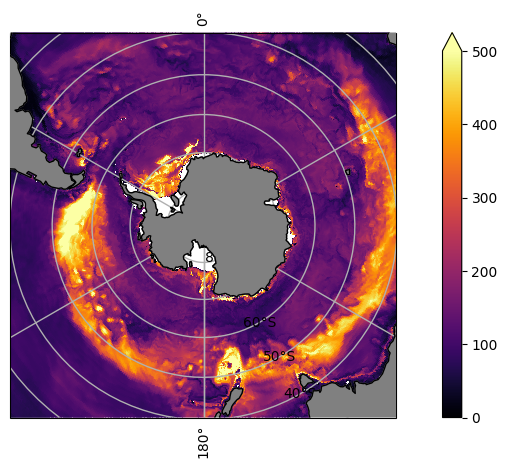

In [97]:
plot(ML_winter_from_WOA, regridder_simple, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

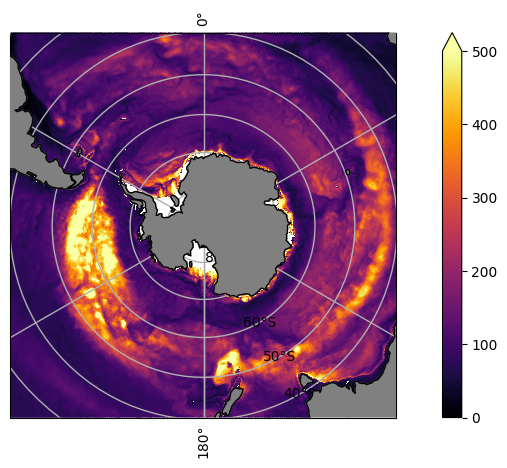

In [176]:
plot(MLD_winter_om5_gfdl, lambda x: x.rename({'xh':'lon', 'yh':'lat'}), vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

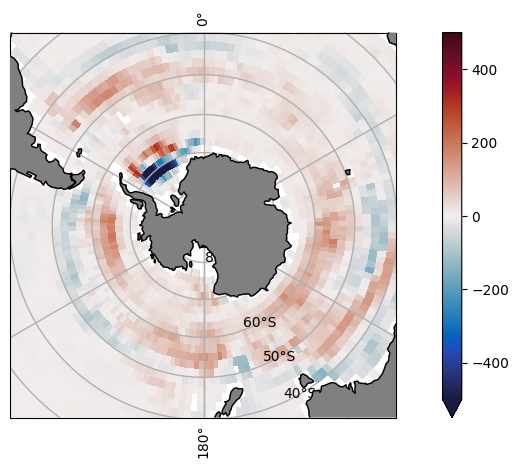

In [35]:
plot(MLD_winter_ann - MLD_winter_ctrl, regridder_2x2, vmin=-500, vmax=500, cmap=cmocean.cm.balance, polar='South', gridlines=True, land=True)

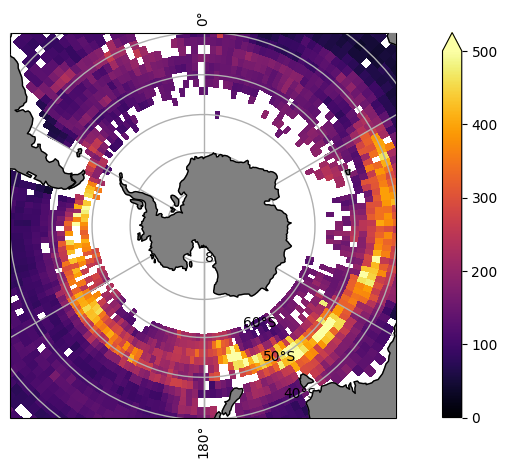

In [33]:
plot(MLD_winter_obs, lambda x: x.rename({'xh':'lon', 'yh':'lat'}), vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

In [91]:
def subtract(x,obs, regrid=regridder_2x2):
    xc = regrid(x)
    return xc - MLD_winter_obs.interp(yh=xc.lat[:,0]).drop_vars(['xh','lon','lat','yh']).rename({'xh':'x'})

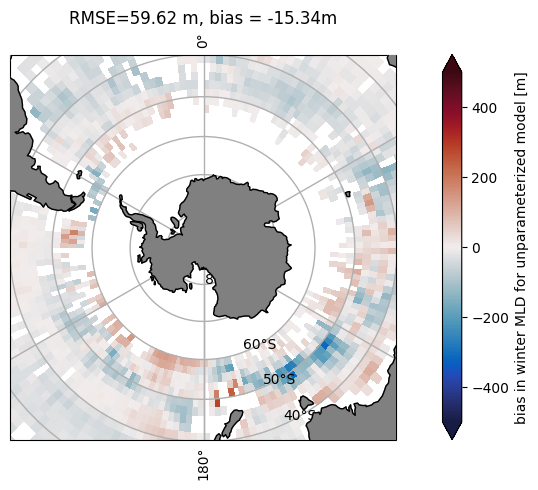

In [137]:
error = subtract(MLD_winter_ctrl, MLD_winter_obs)
plot(error, lambda x: x, vmin=-500, vmax=500, cmap=cmocean.cm.balance, polar='South', gridlines=True, land=True, label='bias in winter MLD for unparameterized model [m]')
RMSE = np.sqrt(np.nanmean(xr.where(error.lat<-40, error, np.nan)**2))
bias = np.nanmean(xr.where(error.lat<-40, error, np.nan))
plt.title('RMSE=%.2f m, bias = %.2fm' % (RMSE, bias));

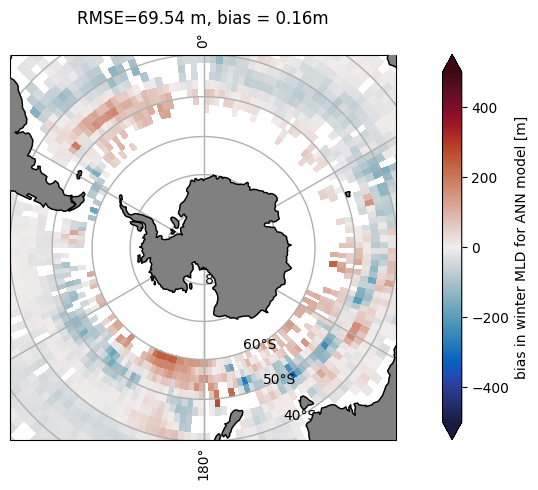

In [139]:
error = subtract(MLD_winter_ann, MLD_winter_obs)
plot(error, lambda x: x, vmin=-500, vmax=500, cmap=cmocean.cm.balance, polar='South', gridlines=True, land=True,  label='bias in winter MLD for ANN model [m]')
RMSE = np.sqrt(np.nanmean(xr.where(error.lat<-40, error, np.nan)**2))
bias = np.nanmean(xr.where(error.lat<-40, error, np.nan))
plt.title('RMSE=%.2f m, bias = %.2fm' % (RMSE, bias));

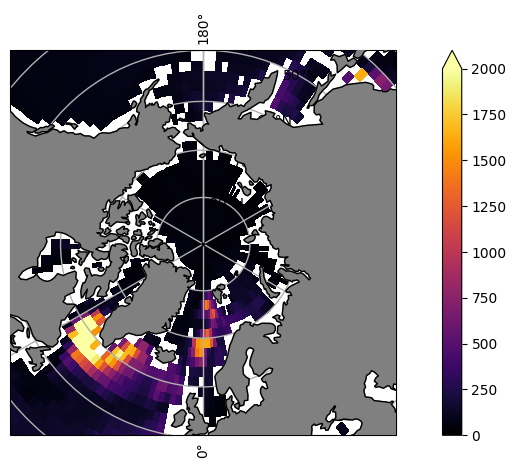

In [158]:
plot(MLD_winter_ctrl, regridder_2x2, vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

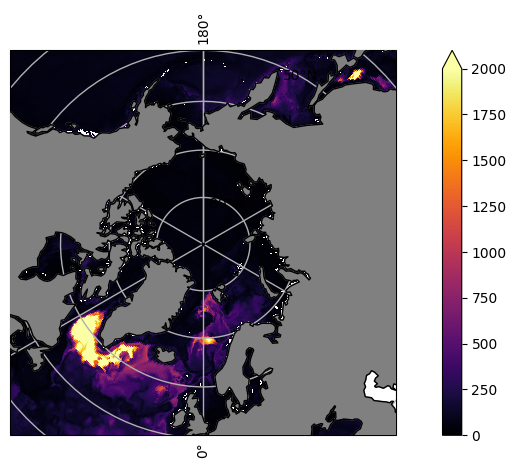

In [174]:
plot(MLD_winter_restart_file, regridder_simple, vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

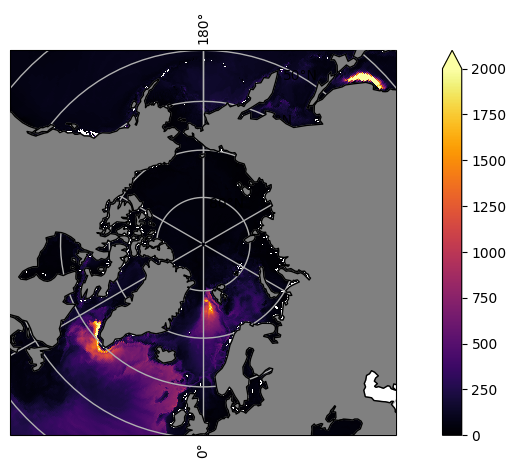

In [101]:
plot(ML_winter_from_WOA, regridder_simple, vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

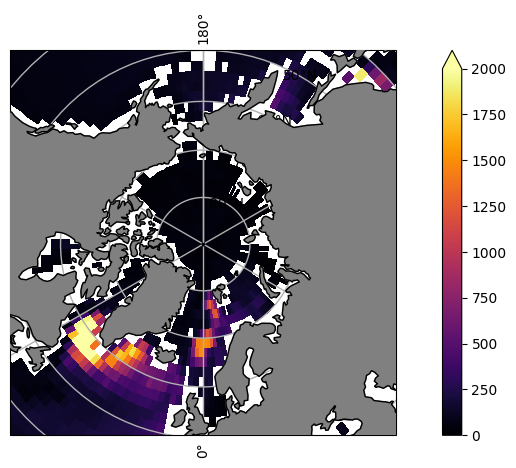

In [159]:
plot(MLD_winter_ann, regridder_2x2, vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

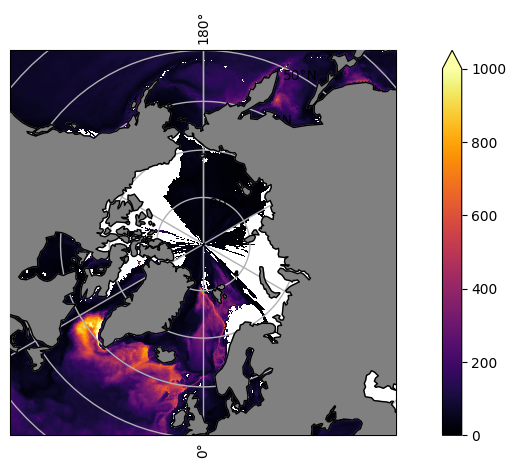

In [178]:
plot(MLD_winter_om5_gfdl, lambda x: x.rename({'xh':'lon', 'yh':'lat'}), vmax=1000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

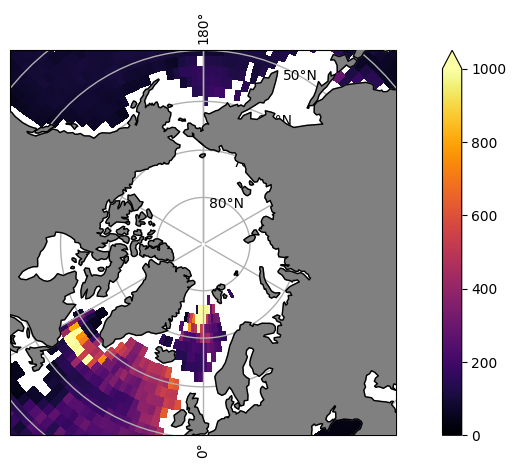

In [179]:
plot(MLD_winter_obs, lambda x: x.rename({'xh':'lon', 'yh':'lat'}), vmax=1000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

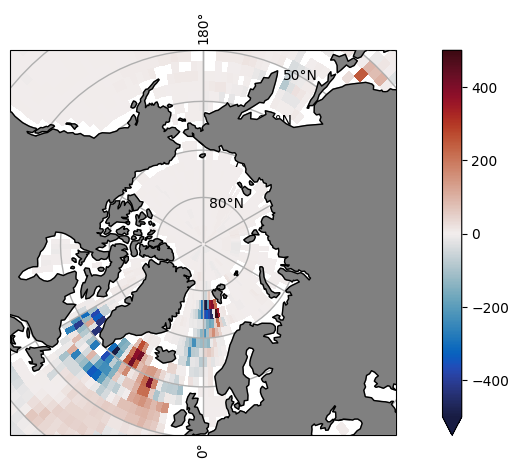

In [181]:
plot(MLD_winter_ann - MLD_winter_ctrl, regridder_2x2, vmax=500, vmin=-500, cmap=cmocean.cm.balance, polar='North', gridlines=True, land=True)

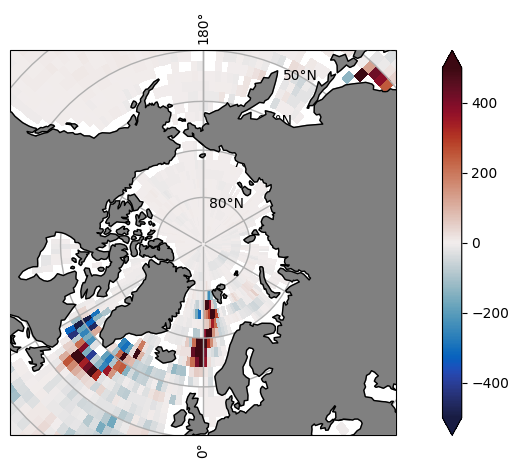

In [182]:
plot(MLD_winter_ctrl - MLD_winter_restart_file, regridder_2x2, vmax=500, vmin=-500, cmap=cmocean.cm.balance, polar='North', gridlines=True, land=True)

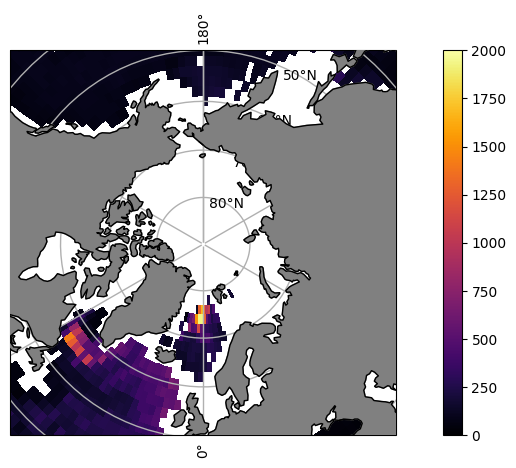

In [127]:
plot(MLD_winter_obs, lambda x: x.rename({'xh':'lon', 'yh':'lat'}), vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

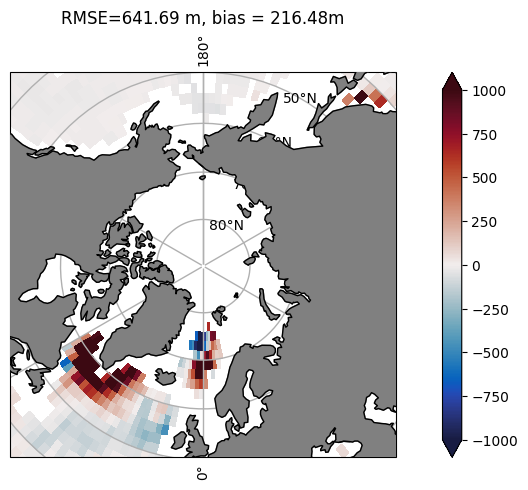

In [186]:
error = subtract(MLD_winter_ctrl, MLD_winter_obs)
plot(error, lambda x: x, vmin=-1000, vmax=1000, cmap=cmocean.cm.balance, polar='North', gridlines=True, land=True)
RMSE = np.sqrt(np.nanmean(xr.where(error.lat>50, error, np.nan)**2))
bias = np.nanmean(xr.where(error.lat>50, error, np.nan))
plt.title('RMSE=%.2f m, bias = %.2fm' % (RMSE, bias));

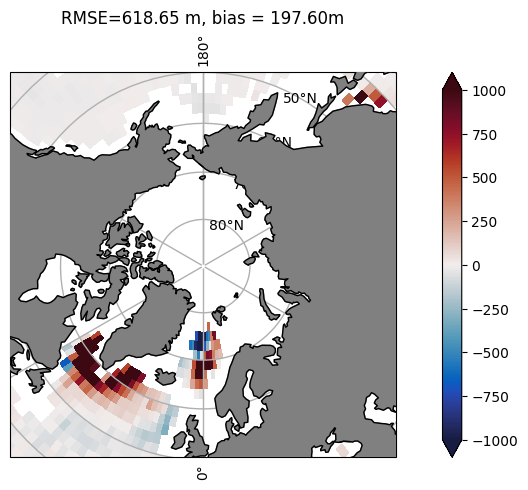

In [187]:
error = subtract(MLD_winter_ann, MLD_winter_obs)
plot(error, lambda x: x, vmin=-1000, vmax=1000, cmap=cmocean.cm.balance, polar='North', gridlines=True, land=True)
RMSE = np.sqrt(np.nanmean(xr.where(error.lat>50, error, np.nan)**2))
bias = np.nanmean(xr.where(error.lat>50, error, np.nan))
plt.title('RMSE=%.2f m, bias = %.2fm' % (RMSE, bias));

# Is WOA temperature potential or not? 

In [67]:
woa_temp = ds['unparameterized'].woa_temp
dz = ds['unparameterized'].dz
R = 6.378e+6 # Earth radius
dy = R * 1./360. * 2 * np.pi
dx = dy * np.cos(woa_temp.yh * np.pi/180.)

In [68]:
((woa_temp * dz * dy * dx).sum() / (xr.where(np.isnan(woa_temp),0.0,1.0) * dz * dy * dx).sum()).compute()

<xarray.DataArray ()> Size: 8B
array(3.66323056)

In [69]:
# Value is too low. Probably, temperature is not potential

In [70]:
temp = ds['unparameterized'].thetao
ave_temp = ((temp * dz * dy * dx).sum(['xh', 'yh', 'zl']) / (xr.where(np.isnan(temp),0.0,1.0) * dz * dy * dx).sum(['xh', 'yh', 'zl'])).compute()

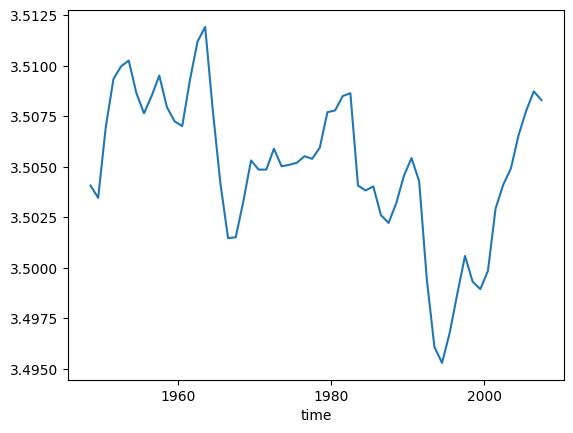

In [71]:
ave_temp.plot()

In [72]:
from dask.diagnostics import ProgressBar
temp = ds['unparameterized'].ocean_annual_z.thetao
dx = ds['unparameterized'].param.dxt
dy = ds['unparameterized'].param.dyt
with ProgressBar():
    ave_temp = ((temp * dz * dy * dx).sum(['xh', 'yh', 'zl']) / (xr.where(np.isnan(temp),0.0,1.0) * dz * dy * dx).sum(['xh', 'yh', 'zl'])).compute()

[########################################] | 100% Completed | 23.05 s


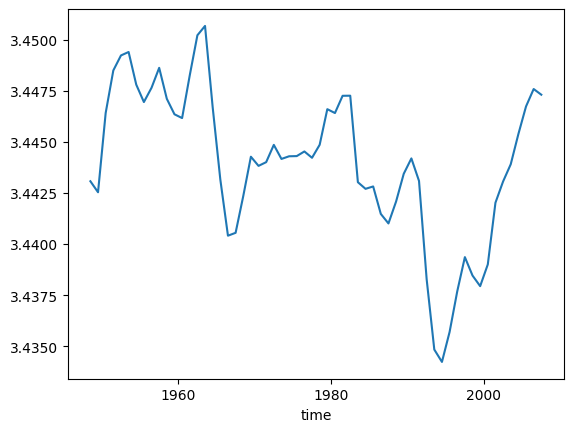

In [73]:
ave_temp.plot()

In [74]:
data = ds['unparameterized'].ocean3d.isel(time=0)
temp = data.thetao
dz = (data.e.isel(zi=slice(0,-1)).drop_vars('zi') - data.e.isel(zi=slice(1,None)).drop_vars('zi')).rename({'zi': 'zl'})
dx = ds['unparameterized'].param.dxt
dy = ds['unparameterized'].param.dyt
with ProgressBar():
    ave_temp = ((temp * dz * dy * dx).sum(['xh', 'yh', 'zl']) / (xr.where(np.isnan(temp),0.0,1.0) * dz * dy * dx).sum(['xh', 'yh', 'zl'])).compute()

[########################################] | 100% Completed | 4.02 sms


In [75]:
ave_temp

<xarray.DataArray ()> Size: 8B
array(3.57689164)
Coordinates:
    time     object 8B 2003-01-03 12:00:00

In [78]:
data = ds['ANN'].ocean3d.isel(time=0)
temp = data.thetao
dz = (data.e.isel(zi=slice(0,-1)).drop_vars('zi') - data.e.isel(zi=slice(1,None)).drop_vars('zi')).rename({'zi': 'zl'})
dx = ds['unparameterized'].param.dxt
dy = ds['unparameterized'].param.dyt
with ProgressBar():
    ave_temp = ((temp * dz * dy * dx).sum(['xh', 'yh', 'zl']) / (xr.where(np.isnan(temp),0.0,1.0) * dz * dy * dx).sum(['xh', 'yh', 'zl'])).compute()

[########################################] | 100% Completed | 3.92 sms


In [102]:
ave_temp

<xarray.DataArray ()> Size: 8B
array(3.46046278)
Coordinates:
    time     object 8B 2003-01-03 12:00:00

# Comparison to potential temperature in EN4 dataset

In [104]:
en4 = xr.open_mfdataset('/vast/pp2681/EN4_dataset/*.nc')

In [154]:
R = 6.378e+6 # Earth radius
dy = R * 1./360. * 2 * np.pi
dx = dy * np.cos(en4.lat * np.pi/180.)
dz = xr.DataArray(np.diff(en4.depth_bnds.isel(time=0),axis=-1).squeeze(), dims='depth')
en4_temp = en4.temperature -273.15 # Convert to celsius

In [155]:
ave_temp = ((en4_temp * dz * dy * dx).sum(['lon', 'lat', 'depth']) / (xr.where(np.isnan(en4_temp),0.0,1.0) * dz * dy * dx).sum(['lon', 'lat', 'depth'])).compute()

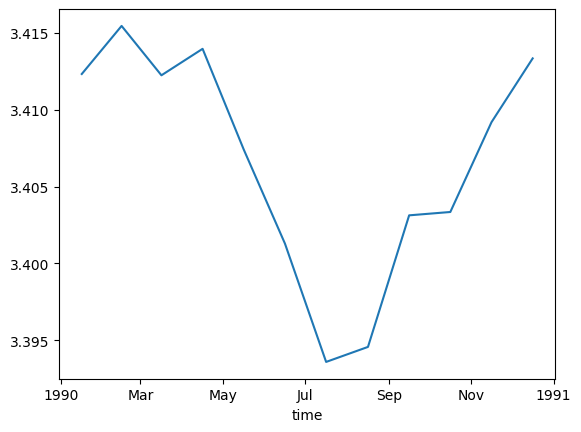

In [156]:
ave_temp.plot()

Text(0.5, 1.0, 'WOA and EN4 are pretty close to each other, \nand so both of them are potential temperatures')

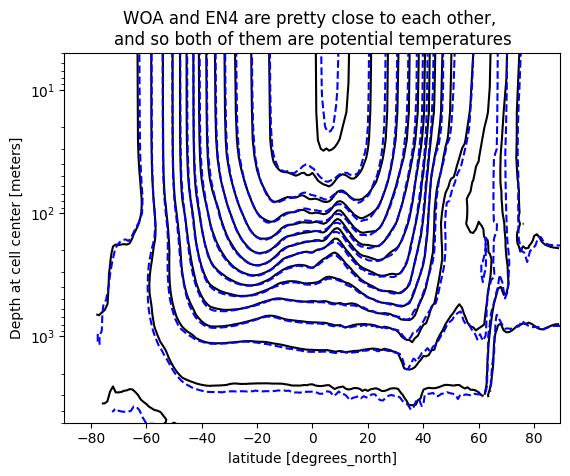

In [182]:
en4_temp.mean('time').mean('lon').plot.contour(levels=np.arange(-10,50,2), colors='k')
woa_temp.mean('xh').plot.contour(levels=np.arange(-10,50,2), colors='b', linestyles='--')
plt.ylim([5,5000])
plt.yscale('log')
plt.gca().invert_yaxis()
plt.title('WOA and EN4 are pretty close to each other, \nand so both of them are potential temperatures')

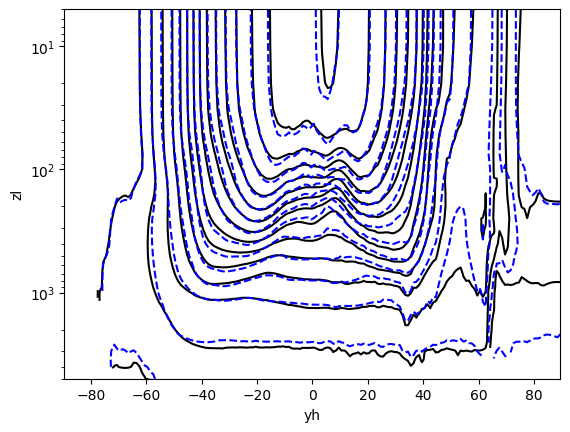

In [185]:
woa_temp.mean('xh').plot.contour(levels=np.arange(-10,50,2), colors='k')
ds['unparameterized'].thetao.sel(time=slice('1981','2007')).mean('time').mean('xh').plot.contour(levels=np.arange(-10,50,2), colors='b', linestyles='--')
plt.ylim([5,5000])
plt.yscale('log')
plt.gca().invert_yaxis()

In [190]:
np.sqrt(((woa_temp.mean('xh') - ds['unparameterized'].thetao.sel(time=slice('1981','2007')).mean('time').mean('xh'))**2).mean()).compute()

<xarray.DataArray ()> Size: 4B
array(0.5095006, dtype=float32)

In [191]:
np.sqrt(((woa_temp.mean('xh') - ds['ANN'].thetao.sel(time=slice('1981','2007')).mean('time').mean('xh'))**2).mean()).compute()

<xarray.DataArray ()> Size: 4B
array(0.53571624, dtype=float32)

In [193]:
np.sqrt(((woa_temp.mean('xh') - ds['ZB20-from-WOA'].thetao.sel(time=slice('1948')).mean('time').mean('xh'))**2).mean()).compute()

<xarray.DataArray ()> Size: 4B
array(0.22291714, dtype=float32)

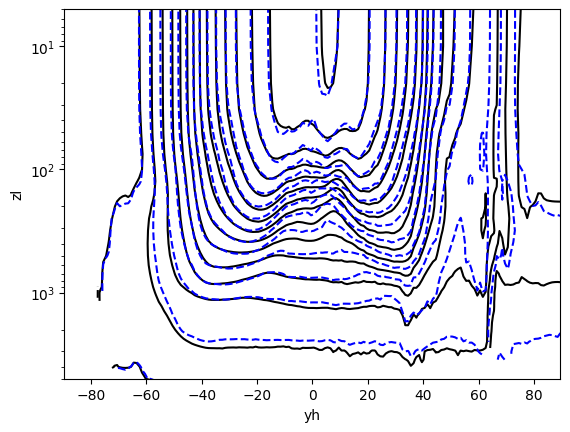

In [186]:
woa_temp.mean('xh').plot.contour(levels=np.arange(-10,50,2), colors='k')
ds['ANN'].thetao.sel(time=slice('1981','2007')).mean('time').mean('xh').plot.contour(levels=np.arange(-10,50,2), colors='b', linestyles='--')
plt.ylim([5,5000])
plt.yscale('log')
plt.gca().invert_yaxis()

In [197]:
RMSE_ZB_from_WOA = np.sqrt(((woa_temp.mean('xh') - ds['ZB20-from-WOA'].thetao.mean('xh'))**2).mean(['yh','zl'])).compute()
RMSE_ZB = np.sqrt(((woa_temp.mean('xh') - ds['ZB20'].thetao.mean('xh'))**2).mean(['yh','zl'])).compute()
RMSE_ANN = np.sqrt(((woa_temp.mean('xh') - ds['ANN'].thetao.mean('xh'))**2).mean(['yh','zl'])).compute()
RMSE_ctrl = np.sqrt(((woa_temp.mean('xh') - ds['unparameterized'].thetao.mean('xh'))**2).mean(['yh','zl'])).compute()

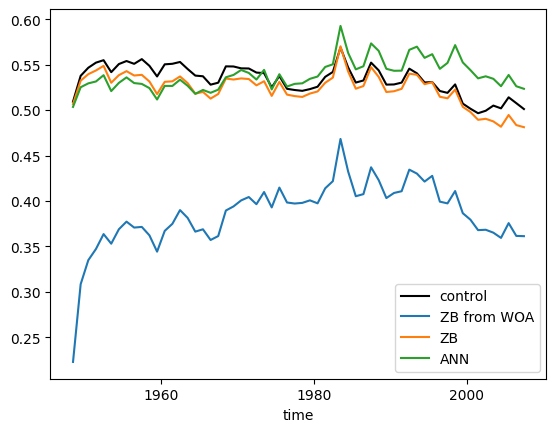

In [203]:
RMSE_ctrl.plot(color='k', label='control')
RMSE_ZB_from_WOA.plot(label='ZB from WOA')
RMSE_ZB.plot(label='ZB')
RMSE_ANN.plot(label='ANN')
plt.legend()

In [211]:
dz = ds['unparameterized'].dz
R = 6.378e+6 # Earth radius
dy = R * 1./360. * 2 * np.pi
dx = dy * np.cos(woa_temp.yh * np.pi/180.)
def ave(x):
    return ((x * dz * dy * dx).sum(['xh','yh','zl']) / (xr.where(np.isnan(x),0.0,1.0) * dz * dy * dx).sum(['xh','yh','zl'])).compute()

In [213]:
ave_ZB_from_WOA = ave(ds['ZB20-from-WOA'].thetao).compute()
ave_ZB = ave(ds['ZB20'].thetao).compute()
ave_ANN = ave(ds['ANN'].thetao).compute()
ave_ctrl = ave(ds['unparameterized'].thetao).compute()
ave_woa = ave(woa_temp).compute()

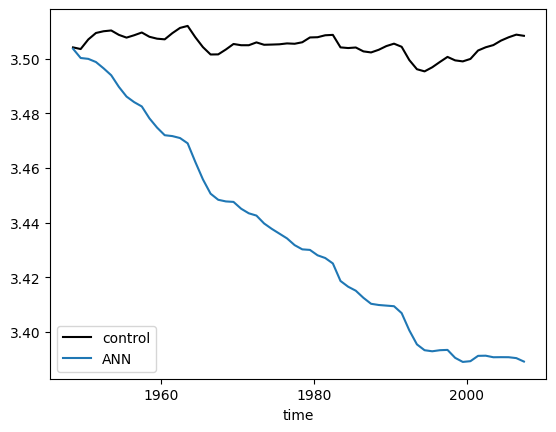

In [454]:
ave_ctrl.plot(color='k', label='control')
#ave_ZB_from_WOA.plot(label='ZB from WOA')
#ave_ZB.plot(label='ZB')
ave_ANN.plot(label='ANN')
plt.legend()

# Potential denisty and MLD

In [256]:
temp = en4.temperature-273.15
salt = en4.salinity
dz_en4 = xr.DataArray(np.diff(en4.depth_bnds.isel(time=0),axis=-1).squeeze(), dims='depth')

In [236]:
import gsw

In [254]:
sigma0_en4 = gsw.sigma0(salt, temp).compute()

In [264]:
MLD_003 = xr.where(np.abs(sigma0_en4.isel(depth=0) - sigma0_en4) < 0.03, dz_en4, 0.).sum('depth')
MLD_003 = xr.where(MLD_003==0., np.nan, MLD_003)

In [265]:
MLD_winter_en4 = MLD_003.max('time')

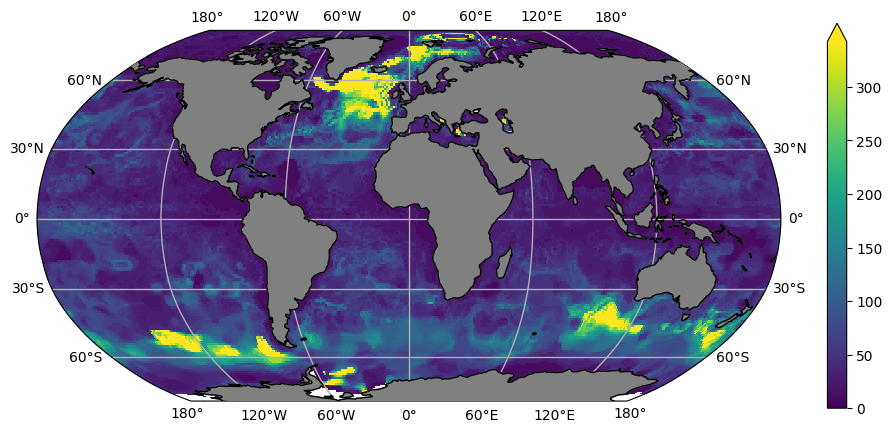

In [268]:
plot(MLD_winter_en4, regrid=lambda x:x, gridlines=True, land=True)

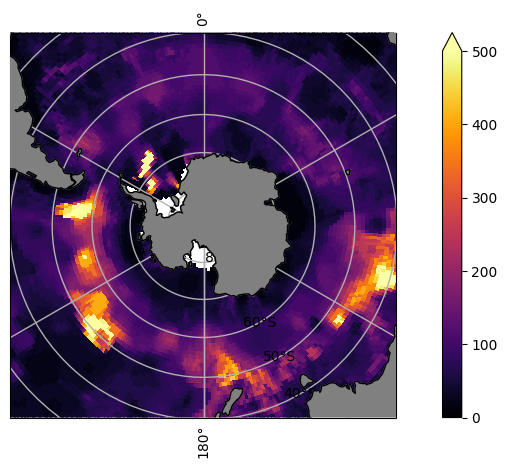

In [270]:
plot(MLD_winter_en4, regrid=lambda x:x, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

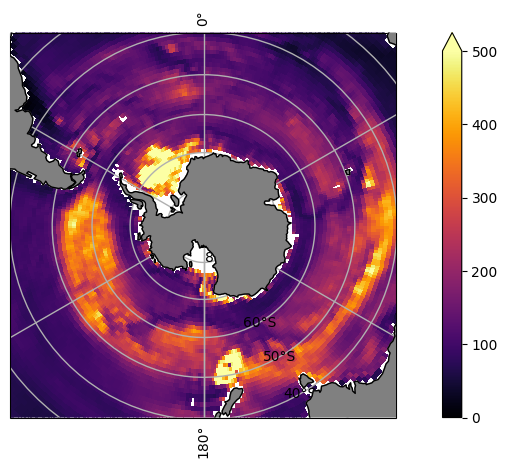

In [276]:
plot(MLD_winter_ctrl, regridder_1x1, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

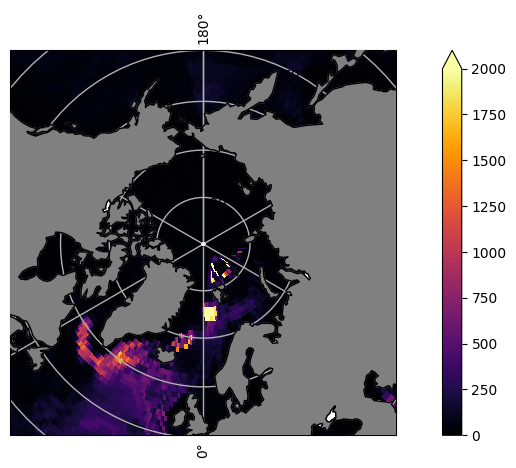

In [279]:
plot(MLD_winter_en4, regrid=lambda x:x, vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

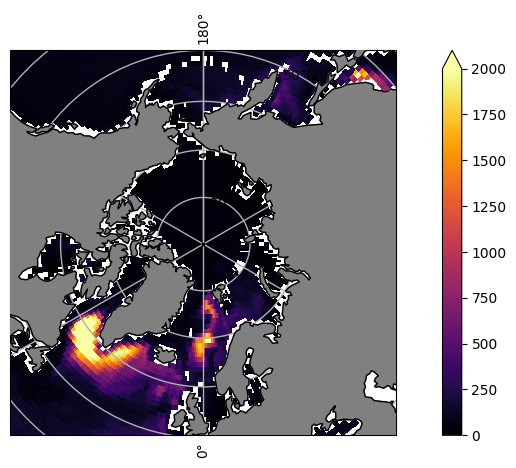

In [278]:
plot(MLD_winter_ctrl, regrid=regridder_1x1, vmax=2000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

# MLD from WOA climatology

In [4]:
temp = xr.open_mfdataset('/vast/pp2681/WOA/woa_monthly_climatology/temp/*.nc', decode_times=False)
salt = xr.open_mfdataset('/vast/pp2681/WOA/woa_monthly_climatology/salt/*.nc', decode_times=False)

In [6]:
import gsw
sigma0_woa = gsw.sigma0(salt.s_an, temp.t_an).compute()

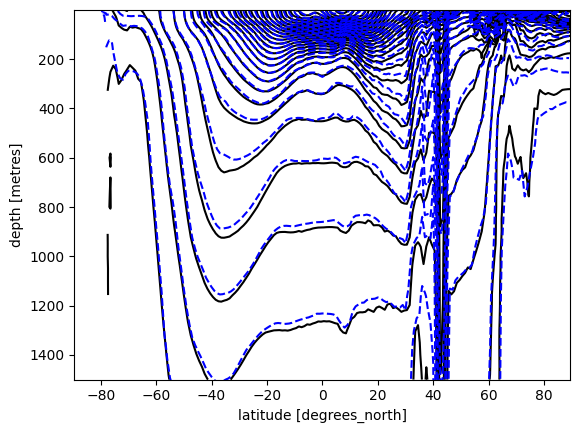

In [332]:
sigma0_woa.mean('time').mean('lon').plot.contour(levels=np.arange(21,28,0.2), colors='k')
sigma0_en4.mean('time').mean('lon').plot.contour(levels=np.arange(21,28,0.2), colors='b', linestyles='--')
plt.ylim([1,1500])
plt.gca().invert_yaxis()


In [342]:
temp.depth_bnds.isel(time=0)[0:3].values

array([[ 0. ,  2.5],
       [ 2.5,  7.5],
       [ 7.5, 12.5]], dtype=float32)

In [7]:
dz = xr.DataArray(np.diff(temp.depth_bnds.isel(time=0),axis=-1).squeeze(), dims='depth')

In [8]:
MLD_003 = xr.where(np.abs(sigma0_woa.isel(depth=0) - sigma0_woa) < 0.03, dz, 0.).sum('depth')
MLD_003 = xr.where(MLD_003==0., np.nan, MLD_003)

In [9]:
MLD_winter_woa = MLD_003.max('time')

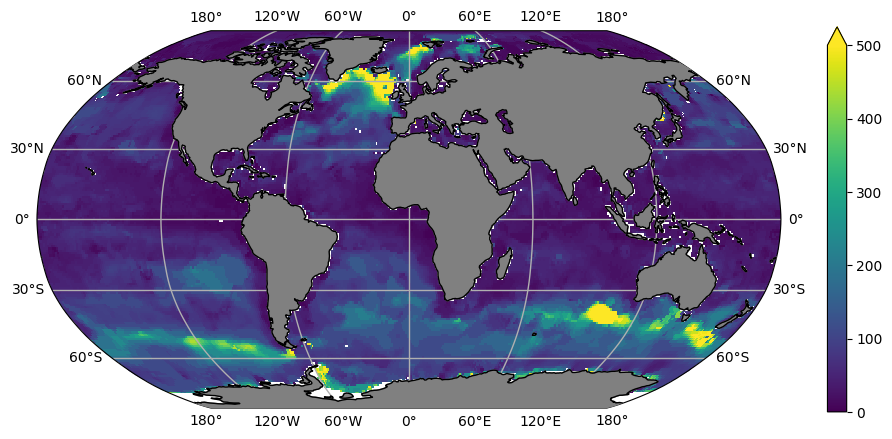

In [364]:
plot(MLD_winter_woa, lambda x: x, gridlines=True, land=True, vmax=500)

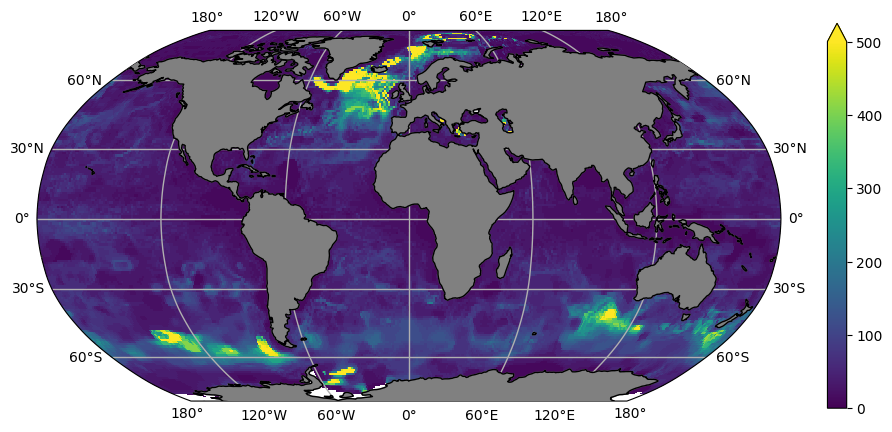

In [365]:
plot(MLD_winter_en4, lambda x: x, gridlines=True, land=True, vmax=500)

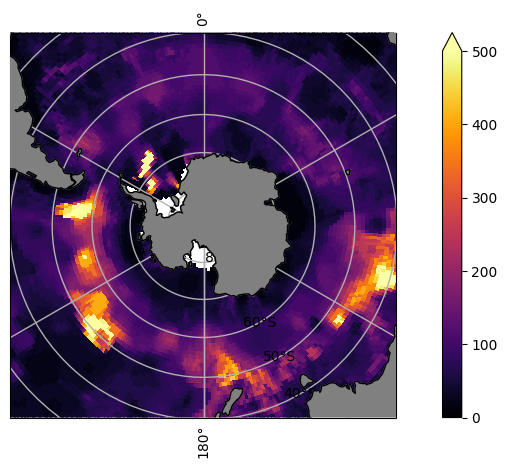

In [366]:
plot(MLD_winter_en4, regrid=lambda x:x, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

In [10]:
plot(MLD_winter_woa, regrid=lambda x:x, vmax=500, cmap=plt.cm.inferno, polar='South', gridlines=True, land=True)

NameError: name 'plot' is not defined

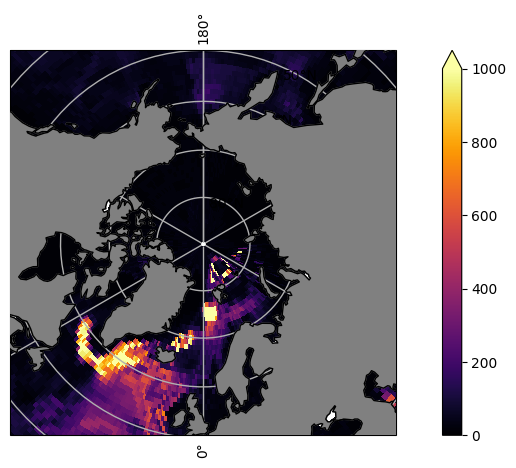

In [370]:
plot(MLD_winter_en4, regrid=lambda x:x, vmax=1000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

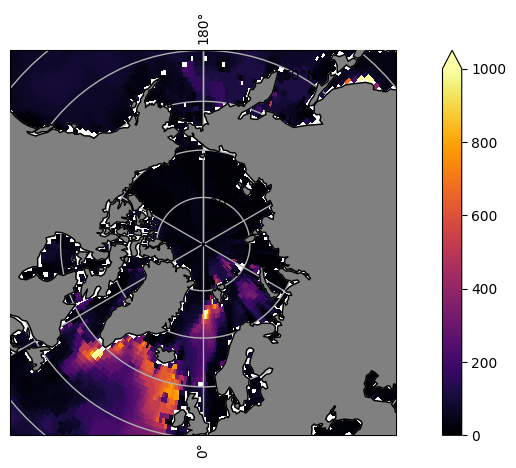

In [375]:
plot(MLD_winter_woa, regrid=lambda x:x, vmax=1000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

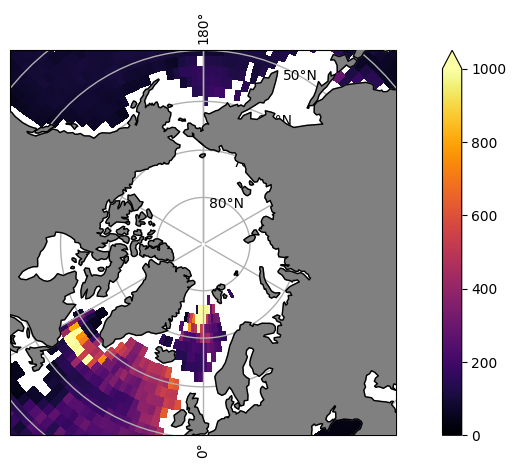

In [373]:
plot(MLD_winter_obs, regrid=lambda x:x.rename({'xh':'lon', 'yh':'lat'}), vmax=1000, cmap=plt.cm.inferno, polar='North', gridlines=True, land=True)

Text(0.5, 1.0, 'Control-WOA, Winter MLD [m]')

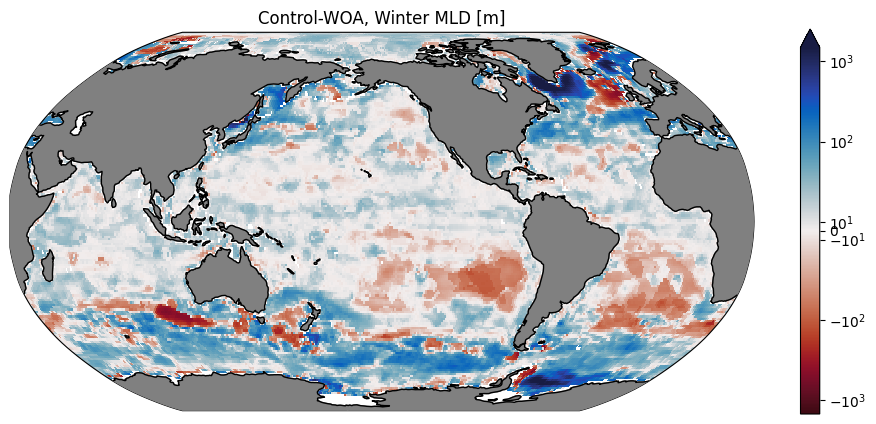

In [395]:
import matplotlib.colors as mcolors
norm = mcolors.SymLogNorm(linthresh=10, linscale=0.1, vmin=-1500, vmax=1500)
plot(regridder_1x1(MLD_winter_ctrl) - MLD_winter_woa.values, regrid=lambda x:x, vmin=None, vmax=None, norm=norm, cmap=cmocean.cm.balance_r, land=True, central_longitude=-150)
plt.title('Control-WOA, Winter MLD [m]')

Text(0.5, 1.0, 'ANN-Control, Winter MLD [m]')

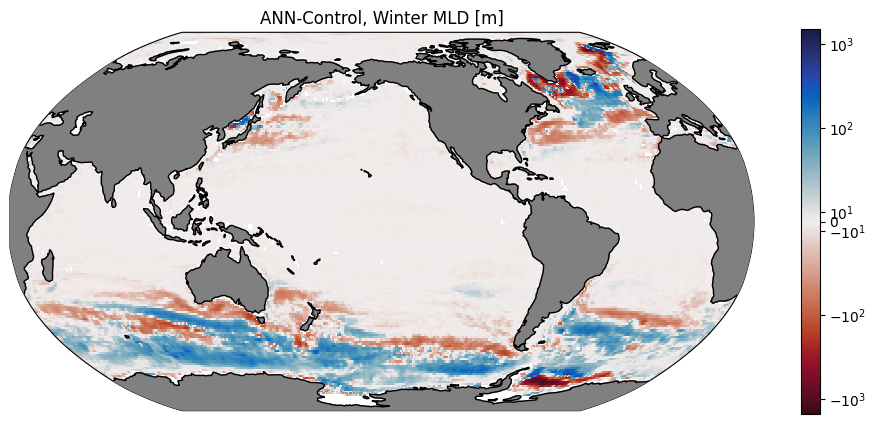

In [397]:
import matplotlib.colors as mcolors
norm = mcolors.SymLogNorm(linthresh=10, linscale=0.1, vmin=-1500, vmax=1500)
plot(regridder_1x1(MLD_winter_ann-MLD_winter_ctrl), regrid=lambda x:x, vmin=None, vmax=None, norm=norm, cmap=cmocean.cm.balance_r, land=True, central_longitude=-150)
plt.title('ANN-Control, Winter MLD [m]')

# Density Structure

In [404]:
sigma0_ctrl = gsw.sigma0(ds['unparameterized'].salto.sel(time=slice('1981', '2007')).mean('time'),ds['unparameterized'].thetao.sel(time=slice('1981', '2007')).mean('time')).compute()

In [433]:
sigma0_ann = gsw.sigma0(ds['ANN'].salto.sel(time=slice('1981', '2007')).mean('time'),ds['ANN'].thetao.sel(time=slice('1981', '2007')).mean('time')).compute()

In [432]:
sigma0_zb = gsw.sigma0(ds['ZB20'].salto.sel(time=slice('1981', '2007')).mean('time'),ds['ZB20'].thetao.sel(time=slice('1981', '2007')).mean('time')).compute()

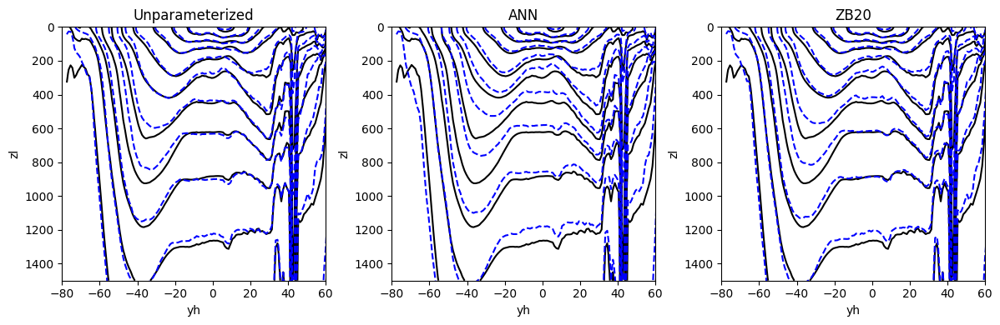

In [443]:
plt.figure(figsize=(12,4))

levels=[22, 23, 24, 25, 26, 26.5, 26.8, 27, 27.2, 27.4, 27.6]

plt.subplot(1,3,1)
sigma0_woa.mean('time').mean('lon').plot.contour(levels=levels, colors='k')
sigma0_ctrl.mean('xh').plot.contour(levels=levels, colors='b', linestyles='--')
plt.ylim([0,1500])
plt.gca().invert_yaxis()
plt.title('Unparameterized')
plt.xlim([-80,60])

plt.subplot(1,3,2)
sigma0_woa.mean('time').mean('lon').plot.contour(levels=levels, colors='k')
sigma0_ann.mean('xh').plot.contour(levels=levels, colors='b', linestyles='--')
plt.ylim([0,1500])
plt.gca().invert_yaxis()
plt.title('ANN')
plt.xlim([-80,60])

plt.subplot(1,3,3)
sigma0_woa.mean('time').mean('lon').plot.contour(levels=levels, colors='k')
sigma0_zb.mean('xh').plot.contour(levels=levels, colors='b', linestyles='--')
plt.ylim([0,1500])
plt.gca().invert_yaxis()
plt.title('ZB20')
plt.xlim([-80,60])

plt.tight_layout()

# MOC/AMOC weakening

In [447]:
amoc_ctrl = ds['unparameterized'].AMOC
moc_ctrl = ds['unparameterized'].MOC

generating basin codes
generating basin codes


In [448]:
amoc_ann = ds['ANN'].AMOC
moc_ann = ds['ANN'].MOC

generating basin codes
generating basin codes


Text(0.5, 1.0, 'MOC ANN')

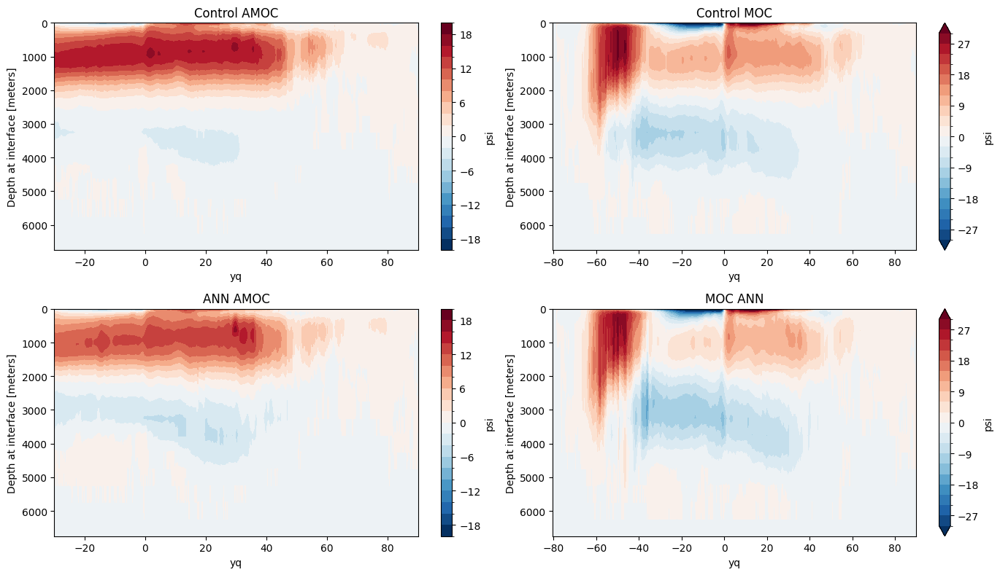

In [453]:
plt.figure(figsize=(14,8))
plt.subplot(2,2,1)
amoc_ctrl.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])
plt.title('Control AMOC')

plt.subplot(2,2,3)
amoc_ann.plot.contourf(levels=np.arange(-20,22,2))
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlim([-30,None])
plt.title('ANN AMOC')

plt.subplot(2,2,2)
moc_ctrl.plot.contourf(levels=np.arange(-30,33,3))
plt.gca().invert_yaxis()
plt.tight_layout()
#plt.xlim([-30,None])
plt.title('Control MOC')

plt.subplot(2,2,4)
moc_ann.plot.contourf(levels=np.arange(-30,33,3))
plt.gca().invert_yaxis()
plt.tight_layout()
#plt.xlim([-30,None])
plt.title('MOC ANN')

# Stratification in Waddel Sea and Subpolar Gyre

(-80.0, 60.0)

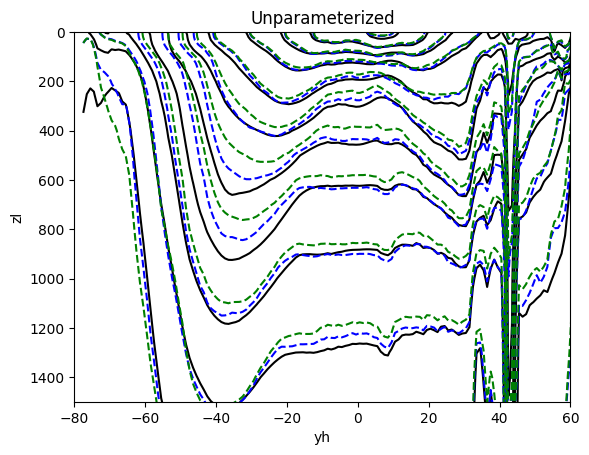

In [9]:
levels=[22, 23, 24, 25, 26, 26.5, 26.8, 27, 27.2, 27.4, 27.6]
ds['unparameterized'].woa_sigma0.mean('xh').plot.contour(levels=levels, colors='k')
ds['unparameterized'].sigma0.sel(time=slice('1981','2007')).mean('time').mean('xh').plot.contour(levels=levels, colors='b', linestyles='--')
ds['ANN'].sigma0.sel(time=slice('1981','2007')).mean('time').mean('xh').plot.contour(levels=levels, colors='g', linestyles='--')
plt.ylim([0,1500])
plt.gca().invert_yaxis()
plt.title('Unparameterized')
plt.xlim([-80,60])

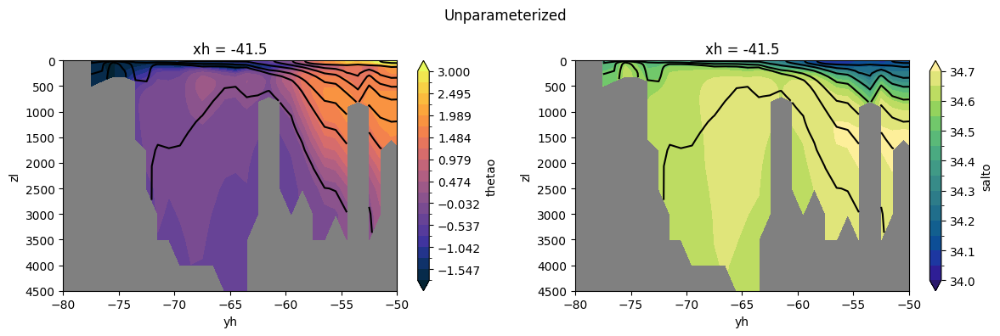

In [60]:
v

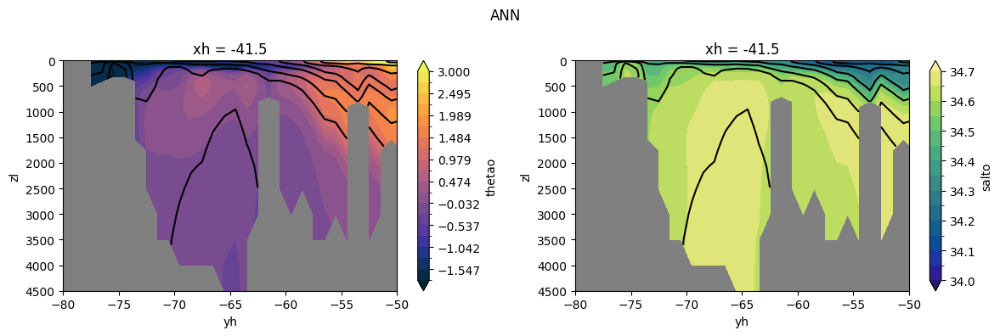

In [62]:
levels = [27, 27.2, 27.3, 27.4 ,
        27.5 ,  27.6 , 27.65, 27.7 , 27.75, 27.8 ]

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
ds['ANN'].thetao.sel(time=slice('1981','2007')).mean('time').sel(xh=-42,method='nearest').plot.contourf(cmap=cmocean.cm.thermal, vmin=-1.8, vmax=3, levels=20)
contours = ds['ANN'].sigma0.sel(time=slice('1981','2007')).mean('time').sel(xh=-42,method='nearest').plot.contour(levels=levels, colors='k')
plt.xlim([-80,-50])
plt.ylim([0,4500])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')

plt.subplot(1,2,2)
ds['ANN'].salto.sel(time=slice('1981','2007')).mean('time').sel(xh=-42,method='nearest').plot.contourf(cmap=cmocean.cm.haline, vmin=34, vmax=34.7, levels=15)
contours = ds['ANN'].sigma0.sel(time=slice('1981','2007')).mean('time').sel(xh=-42,method='nearest').plot.contour(levels=levels, colors='k')
plt.xlim([-80,-50])
plt.ylim([0,4500])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.suptitle('ANN')
plt.tight_layout()

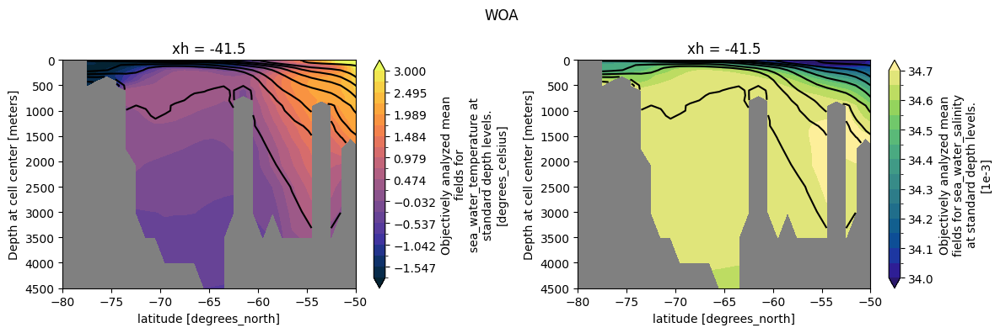

In [61]:
levels = [27, 27.2, 27.3, 27.4 ,
        27.5 ,  27.6 , 27.65, 27.7 , 27.75, 27.8 ]

plt.figure(figsize=(12,4))
plt.subplot(1,2,1)
ds['unparameterized'].woa_temp.sel(xh=-42,method='nearest').plot.contourf(cmap=cmocean.cm.thermal, vmin=-1.8, vmax=3, levels=20)
contours = ds['unparameterized'].woa_sigma0.sel(xh=-42,method='nearest').plot.contour(levels=levels, colors='k')
plt.xlim([-80,-50])
plt.ylim([0,4500])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')

plt.subplot(1,2,2)
ds['unparameterized'].woa_salt.sel(xh=-42,method='nearest').plot.contourf(cmap=cmocean.cm.haline, vmin=34, vmax=34.7, levels=15)
contours = ds['unparameterized'].woa_sigma0.sel(xh=-42,method='nearest').plot.contour(levels=levels, colors='k')
plt.xlim([-80,-50])
plt.ylim([0,4500])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.suptitle('WOA')
plt.tight_layout()

# Waddel Sea one-to-one comparison

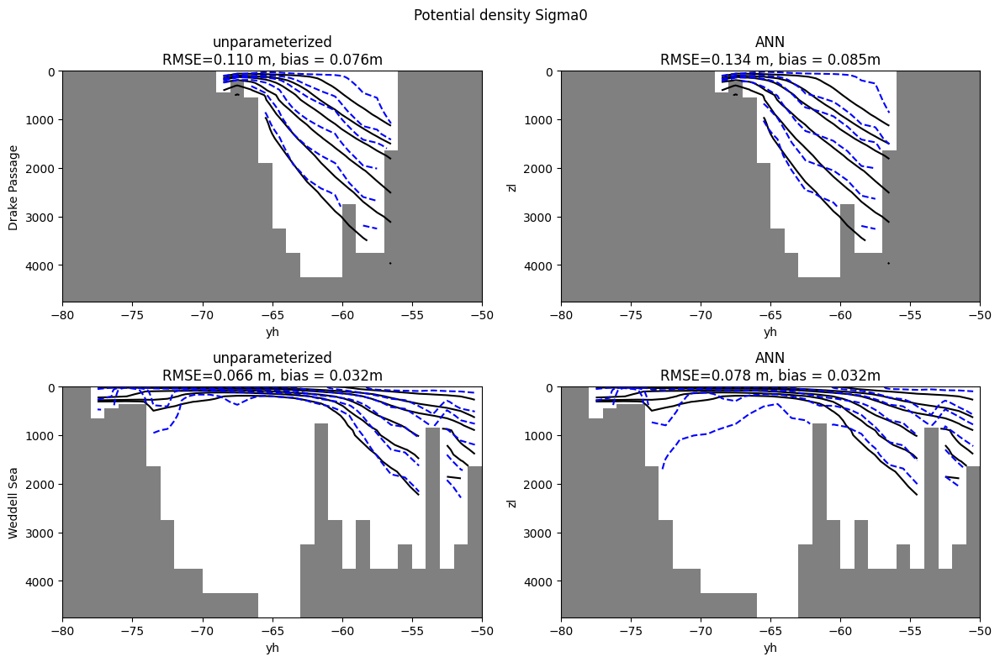

In [113]:
levels = [27.2,27.4,27.5,27.6, 27.65, 27.68]

plt.figure(figsize=(12,8))
for row, lon, region in zip([0,2], [-70, -42], ['Drake Passage', 'Weddell Sea']):
    for j, exp in zip([1,2], ['unparameterized', 'ANN']):
        plt.subplot(2,2,j+row)
        data = ds[exp].sigma0.sel(time=slice('1981','2007')).mean('time').sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        target = ds[exp].woa_sigma0.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        RMSE = np.sqrt(np.nanmean((data-target)**2))
        bias = np.nanmean(data-target)
        (~np.isnan(data)).plot(cmap='gray', vmin=-1, add_colorbar=False)
        target.plot.contour(levels=levels, colors='k')
        data.plot.contour(levels=levels, colors='b', linestyles='--')
        plt.gca().invert_yaxis()
        plt.title(f'{exp}\nRMSE=%.3f m, bias = %.3fm' % (RMSE, bias));
        if j==1:
            plt.ylabel(region)

plt.suptitle('Potential density Sigma0')
plt.tight_layout()

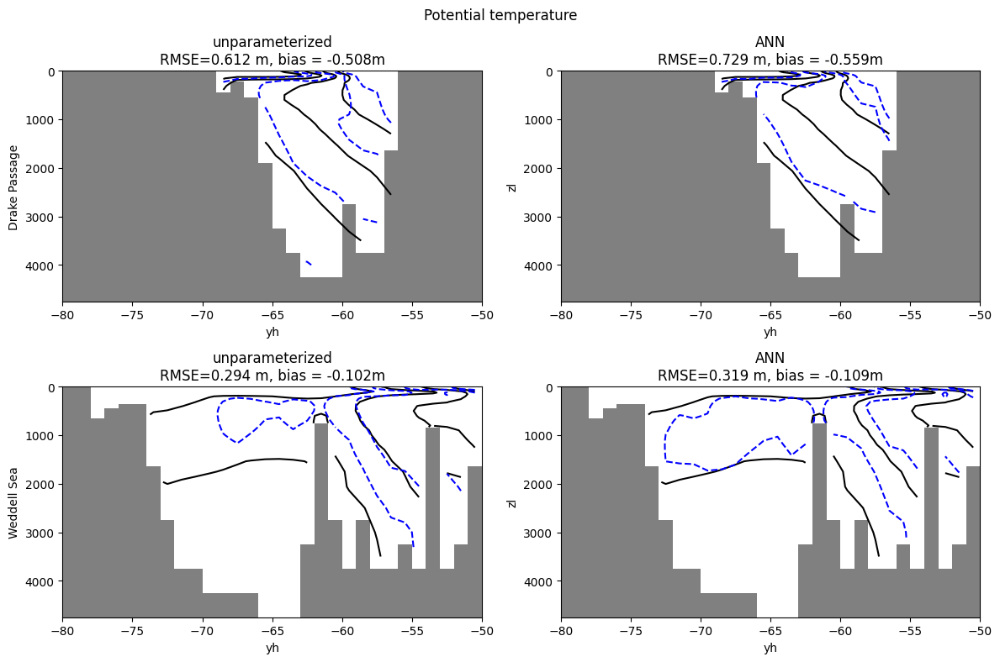

In [117]:
levels = [0, 1, 2, 3]

plt.figure(figsize=(12,8))
for row, lon, region in zip([0,2], [-70, -42], ['Drake Passage', 'Weddell Sea']):
    for j, exp in zip([1,2], ['unparameterized', 'ANN']):
        plt.subplot(2,2,j+row)
        data = ds[exp].thetao.sel(time=slice('1981','2007')).mean('time').sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        target = ds[exp].woa_temp.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        RMSE = np.sqrt(np.nanmean((data-target)**2))
        bias = np.nanmean(data-target)
        (~np.isnan(data)).plot(cmap='gray', vmin=-1, add_colorbar=False)
        target.plot.contour(levels=levels, colors='k')
        data.plot.contour(levels=levels, colors='b', linestyles='--')
        plt.gca().invert_yaxis()
        plt.title(f'{exp}\nRMSE=%.3f m, bias = %.3fm' % (RMSE, bias));
        if j==1:
            plt.ylabel(region)

plt.suptitle('Potential temperature')
plt.tight_layout()

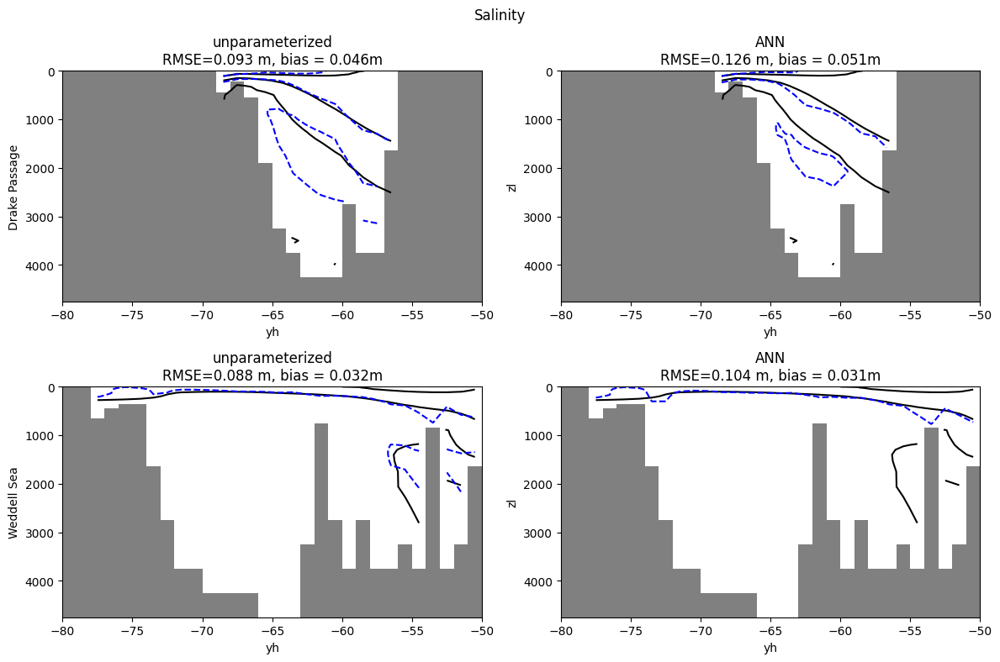

In [118]:
levels = [34,34.5,34.7]

plt.figure(figsize=(12,8))
for row, lon, region in zip([0,2], [-70, -42], ['Drake Passage', 'Weddell Sea']):
    for j, exp in zip([1,2], ['unparameterized', 'ANN']):
        plt.subplot(2,2,j+row)
        data = ds[exp].salto.sel(time=slice('1981','2007')).mean('time').sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        target = ds[exp].woa_salt.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        RMSE = np.sqrt(np.nanmean((data-target)**2))
        bias = np.nanmean(data-target)
        (~np.isnan(data)).plot(cmap='gray', vmin=-1, add_colorbar=False)
        target.plot.contour(levels=levels, colors='k')
        data.plot.contour(levels=levels, colors='b', linestyles='--')
        plt.gca().invert_yaxis()
        plt.title(f'{exp}\nRMSE=%.3f m, bias = %.3fm' % (RMSE, bias));
        if j==1:
            plt.ylabel(region)

plt.suptitle('Salinity')
plt.tight_layout()

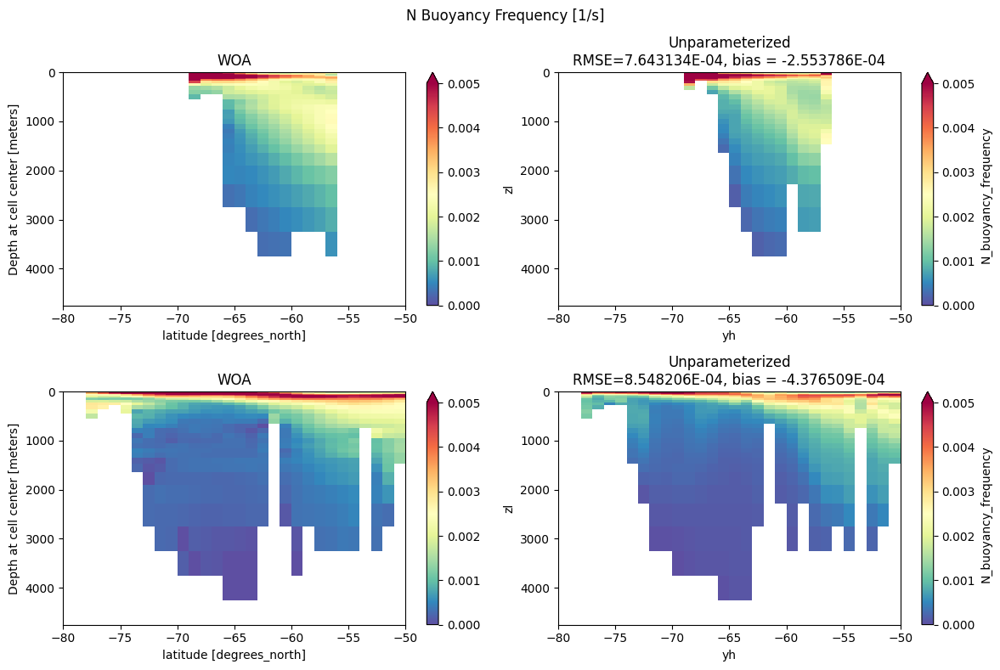

In [169]:
plt.figure(figsize=(12,8))
for row, lon, region in zip([0,2], [-70, -42], ['Drake Passage', 'Weddell Sea']):
        data = ds['unparameterized'].N_buoyancy_frequency.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500)).sel(time=slice('1981','2007')).mean('time')
        target = ds['unparameterized'].N_buoyancy_frequency_woa.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        RMSE = np.sqrt(np.nanmean((data-target)**2))
        bias = np.nanmean(data-target)
        plt.subplot(2,2,1+row)
        target.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
        plt.gca().invert_yaxis()
        plt.title('WOA')
        plt.subplot(2,2,2+row)
        data.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
        plt.gca().invert_yaxis()
        plt.title(f'Unparameterized\nRMSE=%E, bias = %E' % (RMSE, bias));
        if j==1:
            plt.ylabel(region)

plt.suptitle('N Buoyancy Frequency [1/s]')
plt.tight_layout()

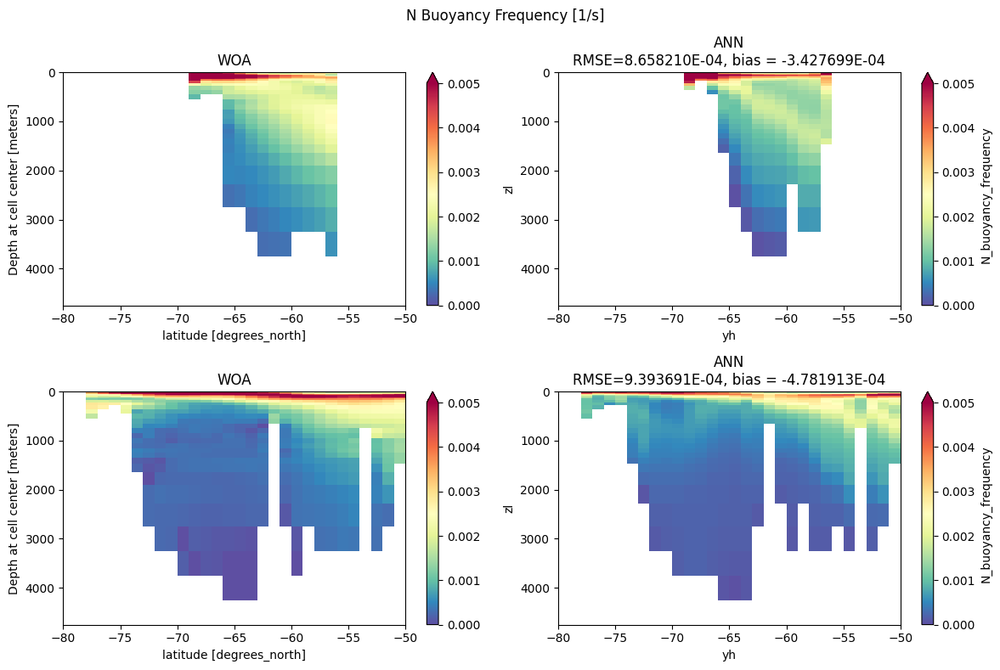

In [171]:
plt.figure(figsize=(12,8))
for row, lon, region in zip([0,2], [-70, -42], ['Drake Passage', 'Weddell Sea']):
        data = ds['ANN'].N_buoyancy_frequency.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500)).sel(time=slice('1981','2007')).mean('time')
        target = ds['ANN'].N_buoyancy_frequency_woa.sel(xh=lon,method='nearest').sel(yh=slice(-80,-50)).sel(zl=slice(None,4500))
        RMSE = np.sqrt(np.nanmean((data-target)**2))
        bias = np.nanmean(data-target)
        plt.subplot(2,2,1+row)
        target.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
        plt.gca().invert_yaxis()
        plt.title('WOA')
        plt.subplot(2,2,2+row)
        data.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
        plt.gca().invert_yaxis()
        plt.title(f'ANN\nRMSE=%E, bias = %E' % (RMSE, bias));
        if j==1:
            plt.ylabel(region)

plt.suptitle('N Buoyancy Frequency [1/s]')
plt.tight_layout()

# Zonally-averaged sigma0 and stratification

In [235]:
woa_sigma0 = ds['ANN'].woa_sigma0.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500))
woa_N_buoyancy_frequency = ds['ANN'].N_buoyancy_frequency_woa.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500))

In [236]:
ctrl_sigma0 = ds['unparameterized'].sigma0.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500)).sel(time=slice('1981','2007')).mean('time').compute()
ctrl_N_buoyancy_frequency = ds['unparameterized'].N_buoyancy_frequency.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500)).sel(time=slice('1981','2007')).mean('time').compute()

In [237]:
ann_sigma0 = ds['ANN'].sigma0.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500)).sel(time=slice('1981','2007')).mean('time').compute()
ann_N_buoyancy_frequency = ds['ANN'].N_buoyancy_frequency.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500)).sel(time=slice('1981','2007')).mean('time').compute()

In [248]:
zb20_sigma0 = ds['ZB20'].sigma0.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500)).sel(time=slice('1981','2007')).mean('time').compute()
zb20_N_buoyancy_frequency = ds['ZB20'].N_buoyancy_frequency.mean('xh').sel(yh=slice(-80,-40), zl=slice(0,5500)).sel(time=slice('1981','2007')).mean('time').compute()

Text(0.5, 1.0, 'ZB20')

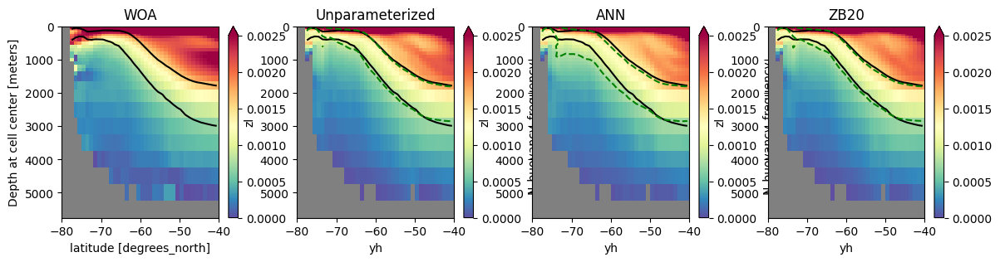

In [249]:
plt.figure(figsize=(14,3))

#levels = [27.2,27.4,27.5,27.6, 27.65, 27.68]
levels = [27.5, 27.65]

plt.subplot(1,4,1)
woa_sigma0.plot.contour(levels=levels, colors='k')
woa_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.0025, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('WOA')

plt.subplot(1,4,2)
woa_sigma0.plot.contour(levels=levels, colors='k')
ctrl_sigma0.plot.contour(levels=levels, colors='g', linestyles='--')
ctrl_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.0025, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('Unparameterized')

plt.subplot(1,4,3)
woa_sigma0.plot.contour(levels=levels, colors='k')
ann_sigma0.plot.contour(levels=levels, colors='g', linestyles='--')
ann_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.0025, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('ANN')

plt.subplot(1,4,4)
woa_sigma0.plot.contour(levels=levels, colors='k')
zb20_sigma0.plot.contour(levels=levels, colors='g', linestyles='--')
zb20_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.0025, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('ZB20')


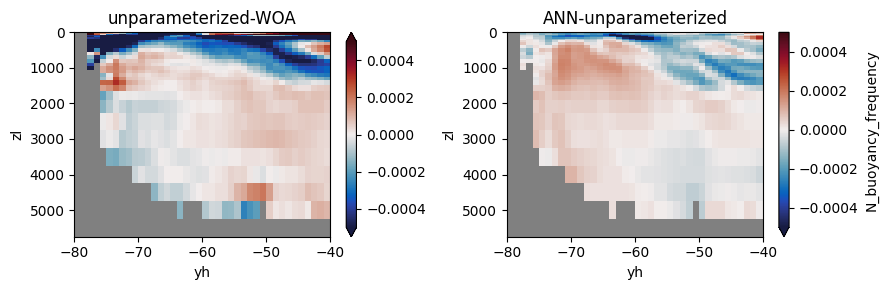

In [244]:
plt.figure(figsize=(9,3))

plt.subplot(1,2,1)
(ctrl_N_buoyancy_frequency-woa_N_buoyancy_frequency).plot.pcolormesh(vmin=-0.0005, vmax=0.0005, cmap=cmocean.cm.balance)
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('unparameterized-WOA')

plt.subplot(1,2,2)
(ann_N_buoyancy_frequency-ctrl_N_buoyancy_frequency).plot.pcolormesh(vmin=-0.0005, vmax=0.0005, cmap=cmocean.cm.balance)
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('ANN-unparameterized')

plt.tight_layout()

# Same stratification plots in North Atlantic

In [253]:
woa_sigma0 = ds['ANN'].woa_sigma0.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000))
woa_N_buoyancy_frequency = ds['ANN'].N_buoyancy_frequency_woa.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000))

In [254]:
ctrl_sigma0 = ds['unparameterized'].sigma0.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000)).sel(time=slice('1981','2007')).mean('time').compute()
ctrl_N_buoyancy_frequency = ds['unparameterized'].N_buoyancy_frequency.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000)).sel(time=slice('1981','2007')).mean('time').compute()

In [255]:
ann_sigma0 = ds['ANN'].sigma0.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000)).sel(time=slice('1981','2007')).mean('time').compute()
ann_N_buoyancy_frequency = ds['ANN'].N_buoyancy_frequency.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000)).sel(time=slice('1981','2007')).mean('time').compute()

In [256]:
zb20_sigma0 = ds['ZB20'].sigma0.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000)).sel(time=slice('1981','2007')).mean('time').compute()
zb20_N_buoyancy_frequency = ds['ZB20'].N_buoyancy_frequency.sel(xh=slice(-80,-10)).mean('xh').sel(yh=slice(20,65),zl=slice(0,6000)).sel(time=slice('1981','2007')).mean('time').compute()

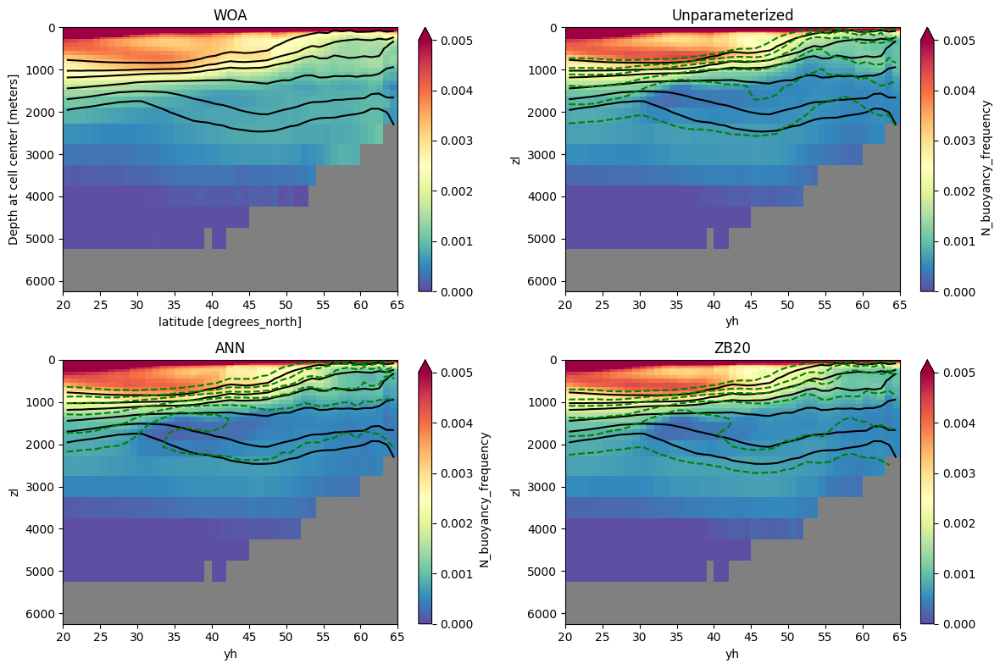

In [262]:
plt.figure(figsize=(12,8))

levels = [27.2,27.4,27.5,27.6, 27.65, 27.68]
#levels = [27.5, 27.65]

plt.subplot(2,2,1)
woa_sigma0.plot.contour(levels=levels, colors='k')
woa_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('WOA')

plt.subplot(2,2,2)
woa_sigma0.plot.contour(levels=levels, colors='k')
ctrl_sigma0.plot.contour(levels=levels, colors='g', linestyles='--')
ctrl_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('Unparameterized')

plt.subplot(2,2,3)
woa_sigma0.plot.contour(levels=levels, colors='k')
ann_sigma0.plot.contour(levels=levels, colors='g', linestyles='--')
ann_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('ANN')

plt.subplot(2,2,4)
woa_sigma0.plot.contour(levels=levels, colors='k')
zb20_sigma0.plot.contour(levels=levels, colors='g', linestyles='--')
zb20_N_buoyancy_frequency.plot.pcolormesh(vmin=0, vmax=0.005, cmap='Spectral_r')
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('ZB20')

plt.tight_layout()

# Everywhere

In [151]:
woa_sigma0 = ds['ANN'].woa_sigma0.mean('xh')
woa_N_buoyancy_frequency = ds['ANN'].N_buoyancy_frequency_woa.mean('xh')

In [152]:
ctrl_sigma0 = ds['unparameterized'].sigma0.mean('xh').sel(time=slice('1981','2007')).mean('time').compute()
ctrl_N_buoyancy_frequency = ds['unparameterized'].N_buoyancy_frequency.mean('xh').sel(time=slice('1981','2007')).mean('time').compute()

In [153]:
ann_sigma0 = ds['ANN'].sigma0.mean('xh').sel(time=slice('1981','2007')).mean('time').compute()
ann_N_buoyancy_frequency = ds['ANN'].N_buoyancy_frequency.mean('xh').sel(time=slice('1981','2007')).mean('time').compute()

In [154]:
zb20_sigma0 = ds['ZB20'].sigma0.mean('xh').sel(time=slice('1981','2007')).mean('time').compute()
zb20_N_buoyancy_frequency = ds['ZB20'].N_buoyancy_frequency.mean('xh').sel(time=slice('1981','2007')).mean('time').compute()

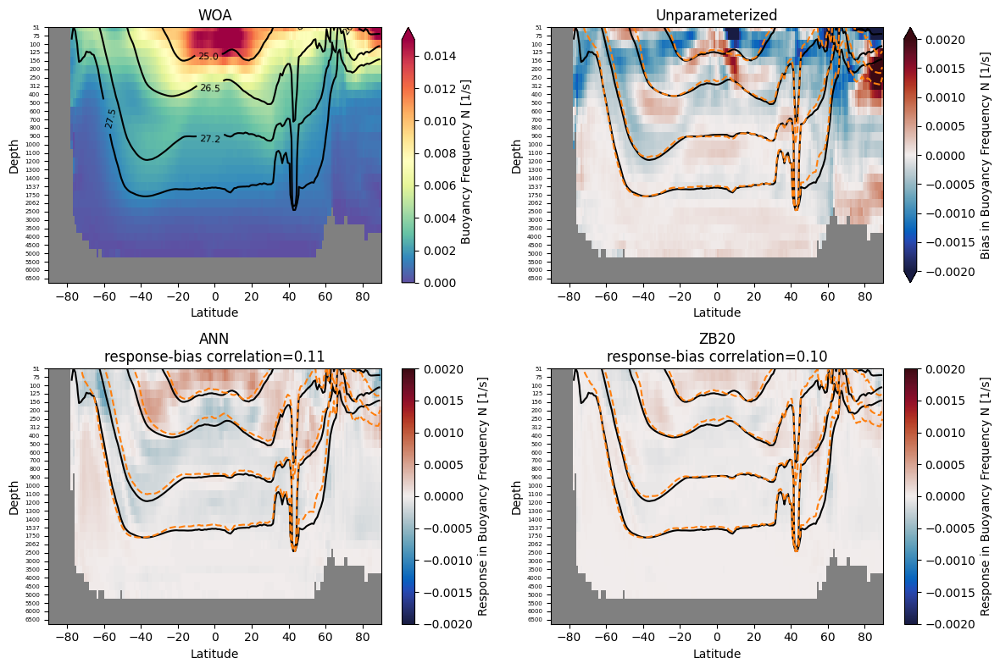

In [336]:
plt.figure(figsize=(12,8))

#levels = [22, 23,24, 25, 26, 26.5,27,27.2,27.4,27.5,27.6, 27.65]
levels = [25, 26.5,27.2,27.5]
#levels = [27.5, 27.65]
zl = np.array(woa_sigma0.zl).astype('int32')

plt.subplot(2,2,1)
contour = woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
plt.clabel(contour, fmt="\n%.1f", inline=True, fontsize=8)
(woa_N_buoyancy_frequency.drop_vars('zl')).plot.pcolormesh(vmin=0, vmax=0.015, cmap='Spectral_r', cbar_kwargs={'label': 'Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('WOA')
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.subplot(2,2,2)
woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
ctrl_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='tab:orange', linestyles='--')
(ctrl_N_buoyancy_frequency - woa_N_buoyancy_frequency).drop_vars('zl').plot.pcolormesh(cmap=cmocean.cm.balance, vmin=-0.002, cbar_kwargs={'label': 'Bias in Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('Unparameterized')
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.subplot(2,2,3)
woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
ann_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='tab:orange', linestyles='--')
(ann_N_buoyancy_frequency - ctrl_N_buoyancy_frequency).drop_vars('zl').plot.pcolormesh(cmap=cmocean.cm.balance, vmin=-0.002, cbar_kwargs={'label': 'Response in Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
pattern_correlation = float(xr.corr(ann_N_buoyancy_frequency[4:] - ctrl_N_buoyancy_frequency[4:], ctrl_N_buoyancy_frequency[4:] - woa_N_buoyancy_frequency[4:]))
plt.title('ANN\nresponse-bias correlation=%.2f' % -pattern_correlation)
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.subplot(2,2,4)
woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
zb20_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='tab:orange', linestyles='--')
(zb20_N_buoyancy_frequency - ctrl_N_buoyancy_frequency).drop_vars('zl').plot.pcolormesh(cmap=cmocean.cm.balance, vmin=-0.002, cbar_kwargs={'label': 'Response in Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
pattern_correlation = float(xr.corr(zb20_N_buoyancy_frequency[4:] - ctrl_N_buoyancy_frequency[4:], ctrl_N_buoyancy_frequency[4:] - woa_N_buoyancy_frequency[4:]))
plt.title('ZB20\nresponse-bias correlation=%.2f' % -pattern_correlation)
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.tight_layout()

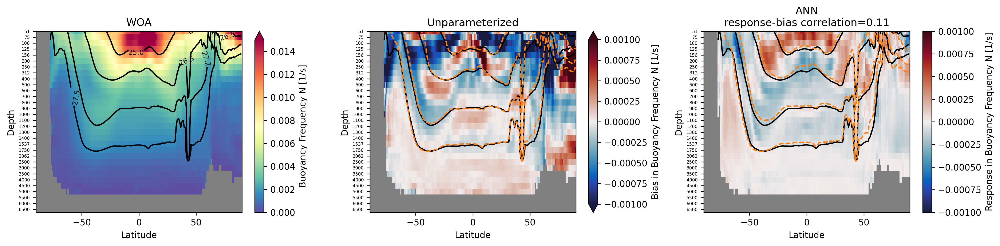

In [168]:
plt.figure(figsize=(16,4), dpi=300)

#levels = [22, 23,24, 25, 26, 26.5,27,27.2,27.4,27.5,27.6, 27.65]
levels = [25, 26.5,27.2,27.5]
#levels = [27.5, 27.65]
zl = np.array(woa_sigma0.zl).astype('int32')

plt.subplot(1,3,1)
contour = woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
plt.clabel(contour, fmt="\n%.1f", inline=True, fontsize=8)
(woa_N_buoyancy_frequency.drop_vars('zl')).plot.pcolormesh(vmin=0, vmax=0.015, cmap='Spectral_r', cbar_kwargs={'label': 'Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('WOA')
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.subplot(1,3,2)
woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
ctrl_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='tab:orange', linestyles='--')
(ctrl_N_buoyancy_frequency - woa_N_buoyancy_frequency).drop_vars('zl').plot.pcolormesh(cmap=cmocean.cm.balance, vmin=-0.001, cbar_kwargs={'label': 'Bias in Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
plt.title('Unparameterized')
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.subplot(1,3,3)
woa_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='k')
ann_sigma0.drop_vars('zl').plot.contour(levels=levels, colors='tab:orange', linestyles='--')
(ann_N_buoyancy_frequency - ctrl_N_buoyancy_frequency).drop_vars('zl').plot.pcolormesh(cmap=cmocean.cm.balance, vmin=-0.001, cbar_kwargs={'label': 'Response in Buoyancy Frequency N [1/s]'})
plt.yticks(np.arange(len(zl)),zl, fontsize=5)
plt.ylim([4,None])
plt.gca().invert_yaxis()
plt.gca().set_facecolor('gray')
pattern_correlation = float(xr.corr(ann_N_buoyancy_frequency[4:] - ctrl_N_buoyancy_frequency[4:], ctrl_N_buoyancy_frequency[4:] - woa_N_buoyancy_frequency[4:]))
plt.title('ANN\nresponse-bias correlation=%.2f' % -pattern_correlation)
plt.ylabel('Depth')
plt.xlabel('Latitude')

plt.tight_layout()
plt.savefig('OM4-stratification.png', dpi=250)

# In NW2 interface positions also were excellent? 

In [3]:
hires_NW2 = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R32/longmean*.nc', decode_times=False)

In [4]:
lores_NW2 = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-long/bare/output/longmean*.nc', decode_times=False)

In [5]:
ann_NW2 = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-ANN/May22-smooth-Coriolis/output/longmean*.nc', decode_times=False)

In [6]:
rey_NW2 = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-long/Reynolds-newest-code/output/longmean*.nc', decode_times=False)

In [7]:
yan_NW2 = xr.open_mfdataset('/scratch/pp2681/mom6/Neverworld2/simulations/R4-long/Yankovsky23-0.3/output/longmean*.nc', decode_times=False)

In [8]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    eta_hires = hires_NW2.e.mean('time').mean('xh').compute()

[########################################] | 100% Completed | 12.72 s


In [9]:
with ProgressBar():
    eta_lores = lores_NW2.e.isel(time=slice(-10,None)).mean('time').mean('xh').compute()

[########################################] | 100% Completed | 904.99 ms


In [10]:
with ProgressBar():
    eta_ann = ann_NW2.e.isel(time=slice(-10,None)).mean('time').mean('xh').compute()

[########################################] | 100% Completed | 804.06 ms


In [11]:
with ProgressBar():
    eta_rey = rey_NW2.e.isel(time=slice(-10,None)).mean('time').mean('xh').compute()

[########################################] | 100% Completed | 903.74 ms


In [12]:
with ProgressBar():
    eta_yan = yan_NW2.e.isel(time=slice(-10,None)).mean('time').mean('xh').compute()

[########################################] | 100% Completed | 903.89 ms


In [13]:
# This is reduced gravity g * (rho1-rho2)/rho0 on internal interfaces
g_prime = np.array([0.00209999999999923, 0.003900000000001, 0.00539999999999964, 
    0.00579999999999927, 0.00580000000000155, 0.00569999999999936, 
    0.00529999999999973, 0.00480000000000018, 0.00420000000000073, 
    0.00369999999999891, 0.00309999999999945, 0.00240000000000009, 
    0.00170000000000073, 0.001099999999999])
# For convenience we will interpolate this data to layers
g_prime_zl = xr.DataArray(np.zeros(15), dims='zl')
g_prime_zl[0] = g_prime[0]
g_prime_zl[-1] = g_prime[-1]
g_prime_zl[1:-1] = 0.5 * (g_prime[0:-1] + g_prime[1:None])
g_prime_zl

<xarray.DataArray (zl: 15)> Size: 120B
array([0.0021 , 0.003  , 0.00465, 0.0056 , 0.0058 , 0.00575, 0.0055 ,
       0.00505, 0.0045 , 0.00395, 0.0034 , 0.00275, 0.00205, 0.0014 ,
       0.0011 ])
Dimensions without coordinates: zl

In [147]:
N_buoyancy_frequency_hires = np.minimum(np.sqrt(g_prime_zl / hires_NW2.h.mean('time').mean('xh').compute()),0.05)

In [148]:
N_buoyancy_frequency_lores = np.minimum(np.sqrt(g_prime_zl / lores_NW2.h.isel(time=slice(-10,None)).mean('time').mean('xh').compute()),0.05)

In [149]:
N_buoyancy_frequency_ann = np.minimum(np.sqrt(g_prime_zl / ann_NW2.h.isel(time=slice(-10,None)).mean('time').mean('xh').compute()),0.05)

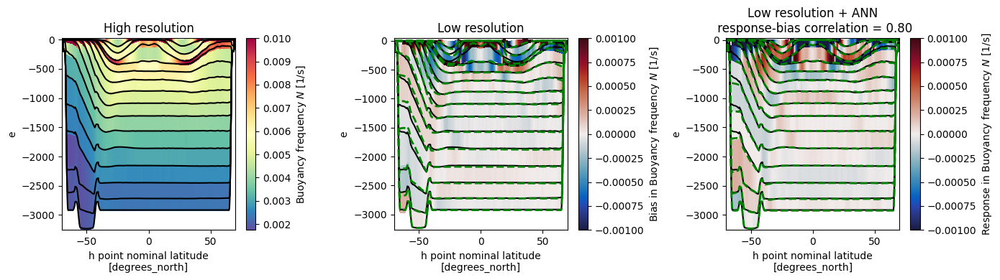

In [150]:
plt.figure(figsize=(14,4))
plt.subplot(1,3,1)

z = np.nan_to_num((eta_hires[0:-1].values + eta_hires[1:None].values) * 0.5)
im = plt.pcolormesh(eta_hires.yh, z, N_buoyancy_frequency_hires,vmax=0.01, cmap='Spectral_r')
plt.colorbar(im, label='Buoyancy frequency $N$ [1/s]')

for zi in range(1,16,1):
    eta_hires[zi].plot(color='k')

plt.title('High resolution')

plt.subplot(1,3,2)
z = np.nan_to_num((eta_lores[0:-1].values + eta_lores[1:None].values) * 0.5)
im = plt.pcolormesh(eta_lores.yh, z, N_buoyancy_frequency_lores - N_buoyancy_frequency_hires.interp(yh=N_buoyancy_frequency_lores.yh),vmin=-0.001, vmax=0.001, cmap=cmocean.cm.balance)
plt.colorbar(im, label='Bias in Buoyancy frequency $N$ [1/s]')
# z = np.nan_to_num((eta_lores[0:-1].values + eta_lores[1:None].values) * 0.5)
# im = plt.pcolormesh(eta_lores.yh, z, N_buoyancy_frequency_lores,vmax=0.01, cmap='Spectral_r')
#plt.colorbar(im)
for zi in range(1,16,1):
    eta_hires[zi].plot(color='k')
for zi in range(1,16,1):
    eta_lores[zi].plot(color='g', ls='--', lw=2)

plt.title('Low resolution')


plt.subplot(1,3,3)
z = np.nan_to_num((eta_ann[0:-1].values + eta_ann[1:None].values) * 0.5)
im = plt.pcolormesh(eta_ann.yh, z, N_buoyancy_frequency_ann - N_buoyancy_frequency_lores,vmin=-0.001, vmax=0.001, cmap=cmocean.cm.balance)
plt.colorbar(im, label='Response in Buoyancy frequency $N$ [1/s]')
# z = np.nan_to_num((eta_lores[0:-1].values + eta_lores[1:None].values) * 0.5)
# im = plt.pcolormesh(eta_lores.yh, z, N_buoyancy_frequency_lores,vmax=0.01, cmap='Spectral_r')
#plt.colorbar(im)
for zi in range(1,16,1):
    eta_hires[zi].plot(color='k')
for zi in range(1,16,1):
    eta_ann[zi].plot(color='g', ls='--', lw=2)

corr = xr.corr(N_buoyancy_frequency_ann - N_buoyancy_frequency_lores, N_buoyancy_frequency_lores - N_buoyancy_frequency_hires.interp(yh=N_buoyancy_frequency_lores.yh))
plt.title('Low resolution + ANN\n response-bias correlation = %.2f' % float(-corr))

plt.tight_layout()
plt.savefig('NW2-restratification.png', dpi=250)

# Stronger Gulfstream?

In [51]:
glorys = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/mercatorglorys12v1_gl12_mean_1993_2016_01.nc').drop_vars('time').squeeze()
glorys_grid = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/GLO-MFC_001_030_coordinates.nc').drop_vars(['depth','latitude','longitude'])

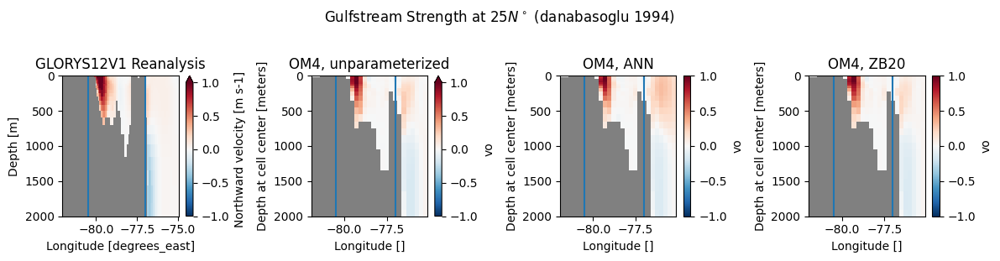

In [366]:
plt.figure(figsize=(12,3))

lon = slice(-82,-75)
lat = 26.5

plt.subplot(1,4,1)
glorys.vo.sel(longitude=lon).sel(latitude=lat, method='nearest').plot(vmin=-1)
plt.ylim(0,2000)
plt.gca().set_facecolor('gray')
plt.gca().invert_yaxis()
plt.title('GLORYS12V1 Reanalysis')
plt.axvline(x=-80.5)
plt.axvline(x=-77)


plt.subplot(1,4,2)
ds['unparameterized'].v_mean.sel(xh=lon).sel(yq=lat, method='nearest').plot(vmin=-1)
plt.ylim(0,2000)
plt.gca().set_facecolor('gray')
plt.gca().invert_yaxis()
plt.title('OM4, unparameterized')
plt.axvline(x=-80.5)
plt.axvline(x=-77)

plt.subplot(1,4,3)
ds['ANN'].v_mean.sel(xh=lon).sel(yq=lat, method='nearest').plot(vmin=-1)
plt.ylim(0,2000)
plt.gca().set_facecolor('gray')
plt.gca().invert_yaxis()
plt.title('OM4, ANN')
plt.suptitle('Gulfstream Strength at $25N^\circ$ (danabasoglu 1994)',y=1.02)
plt.axvline(x=-80.5)
plt.axvline(x=-77)
plt.tight_layout()

plt.subplot(1,4,4)
ds['ZB20'].v_mean.sel(xh=lon).sel(yq=lat, method='nearest').plot(vmin=-1)
plt.ylim(0,2000)
plt.gca().set_facecolor('gray')
plt.gca().invert_yaxis()
plt.title('OM4, ZB20')
plt.suptitle('Gulfstream Strength at $25N^\circ$ (danabasoglu 1994)',y=1.02)
plt.axvline(x=-80.5)
plt.axvline(x=-77)
plt.tight_layout()

In [385]:
1e-6 * (glorys.vo * glorys_grid.e1t * glorys_grid.e3t).sel(depth=slice(0,2000)).sel(latitude=26.5, method='nearest').sel(longitude=slice(-80.5, -77)).sum().compute()

<xarray.DataArray ()> Size: 8B
array(29.795974)
Coordinates:
    latitude  float32 4B 26.5

In [386]:
1e-9 * ds['unparameterized'].ocean_annual_z.vmo.sel(time=slice('1981','2007')).mean('time').sel(zl=slice(0,2000)).sel(yq=26.5,method='nearest').sel(xh=slice(-80.5, -77)).sum().compute()

<xarray.DataArray 'vmo' ()> Size: 8B
array(24.58668646)
Coordinates:
    yq       float64 8B 26.39

In [457]:
1e-9 * ds['ANN'].ocean_annual_z.vmo.sel(time=slice('1981','2007')).mean('time').sel(zl=slice(0,2000)).sel(yq=26.5,method='nearest').sel(xh=slice(-80.5, -77)).sum().compute()

<xarray.DataArray 'vmo' ()> Size: 8B
array(22.05048627)
Coordinates:
    yq       float64 8B 26.39

In [388]:
1e-9 * ds['ZB20'].ocean_annual_z.vmo.sel(time=slice('1981','2007')).mean('time').sel(zl=slice(0,2000)).sel(yq=26.5,method='nearest').sel(xh=slice(-80.5, -77)).sum().compute()

<xarray.DataArray 'vmo' ()> Size: 8B
array(23.89538611)
Coordinates:
    yq       float64 8B 26.39

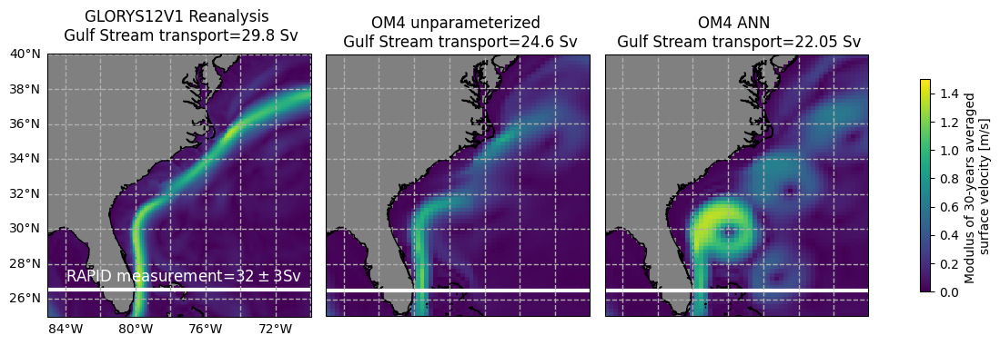

In [460]:
fig = plt.figure(figsize=(12,4))
ax = fig.add_subplot(1,3,1,projection=ccrs.PlateCarree())
v = np.sqrt(glorys.uo**2+glorys.vo**2).isel(depth=0).sel(latitude=slice(25,40), longitude=slice(-85,-70))
v.plot(ax=ax, add_colorbar=False, vmin=0, vmax=1.5)
plt.gca().set_facecolor('gray')
gl = ax.gridlines(draw_labels=True, linewidth=1,alpha=1.0, linestyle='--')
gl.right_labels = False
gl.top_labels = False
plt.title('GLORYS12V1 Reanalysis \n Gulf Stream transport=29.8 Sv')
plt.axhline(y=26.5,color='w', lw=3)
plt.text(-84,27, 'RAPID measurement=$32\pm3$Sv', color='white', fontsize=12)
ax.coastlines()

ax = fig.add_subplot(1,3,2,projection=ccrs.PlateCarree())
v = ds['unparameterized'].uabs.sel(yh=slice(25,40), xh=slice(-85,-70)).isel(zl=0)
v.plot(ax=ax, add_colorbar=False, vmin=0, vmax=1.5)
plt.gca().set_facecolor('gray')
gl = ax.gridlines(draw_labels=False, linewidth=1,alpha=1.0, linestyle='--')
plt.title('OM4 unparameterized \n Gulf Stream transport=24.6 Sv')
plt.axhline(y=26.5,color='w', lw=3)
ax.coastlines()

ax = fig.add_subplot(1,3,3,projection=ccrs.PlateCarree())
v = ds['ANN'].uabs.sel(yh=slice(25,40), xh=slice(-85,-70)).isel(zl=0)
im = v.plot(ax=ax, add_colorbar=False, vmin=0, vmax=1.5)
plt.gca().set_facecolor('gray')
gl = ax.gridlines(draw_labels=False, linewidth=1,alpha=1.0, linestyle='--')
plt.title('OM4 ANN \n Gulf Stream transport=22.05 Sv')
plt.axhline(y=26.5,color='w', lw=3)
plt.tight_layout()
ax.coastlines()

plt.colorbar(im, ax=fig.axes, shrink=0.7, label='Modulus of 30-years averaged \nsurface velocity [m/s]')
plt.savefig('Gulfstream_transport.png', dpi=250)

# Upward surface heat flux

In [3]:
area = ds['unparameterized'].param.dxt * ds['unparameterized'].param.dyt
dyt = ds['unparameterized'].param.dyt

flux = ds['unparameterized'].budget.hfds
ctrl_flux = (flux * area).compute()

flux = ds['ANN'].budget.hfds
ann_flux = (flux * area).compute()

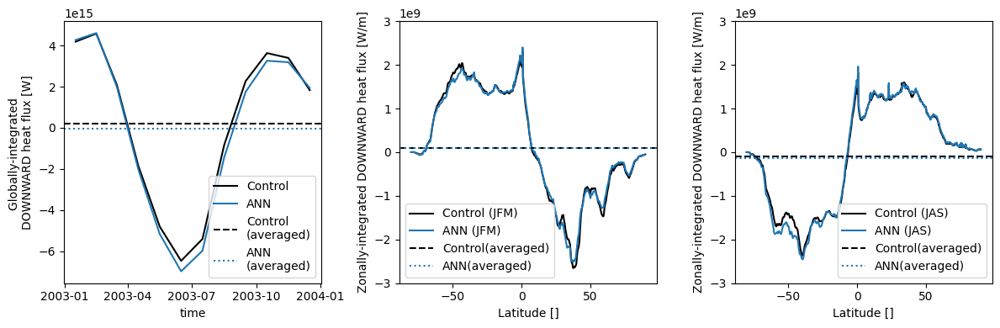

In [11]:
plt.figure(figsize=(12,4))
plt.subplot(1,3,1)
ctrl_flux.sum(['xh','yh']).plot(color='k', label='Control')
ann_flux.sum(['xh','yh']).plot(label='ANN')
plt.axhline(y=ctrl_flux.sum(['xh','yh']).mean(), color='k',ls='--', label='Control\n(averaged)')
plt.axhline(y=ann_flux.sum(['xh','yh']).mean(), ls=':', label='ANN\n(averaged)')
plt.legend()
plt.ylabel('Globally-integrated \nDOWNWARD heat flux [W]')

plt.subplot(1,3,2)
(ctrl_flux[:3]/dyt).sum('xh').mean('time').plot(color='k', label='Control (JFM)')
(ann_flux[:3]/dyt).sum('xh').mean('time').plot(label = 'ANN (JFM)')
plt.axhline(y=(ctrl_flux[:3]/dyt).sum('xh').mean('time').mean('yh'),color='k',ls='--',label='Control(averaged)')
plt.axhline(y=(ann_flux[:3]/dyt).sum('xh').mean('time').mean('yh'),ls=':',label='ANN(averaged)')
plt.ylabel('Zonally-integrated DOWNWARD heat flux [W/m]')
plt.ylim([-3e9,3e9])
plt.legend()

plt.subplot(1,3,3)
(ctrl_flux[6:9]/dyt).sum('xh').mean('time').plot(color='k', label='Control (JAS)')
(ann_flux[6:9]/dyt).sum('xh').mean('time').plot(label = 'ANN (JAS)')
plt.axhline(y=(ctrl_flux[6:9]/dyt).sum('xh').mean('time').mean('yh'),color='k',ls='--',label='Control(averaged)')
plt.axhline(y=(ann_flux[6:9]/dyt).sum('xh').mean('time').mean('yh'),ls=':',label='ANN(averaged)')
plt.ylabel('Zonally-integrated DOWNWARD heat flux [W/m]')
plt.ylim([-3e9,3e9])
plt.legend()


plt.tight_layout()

# Meridional heat transport

generating basin codes


(-2000000000000000.0, 2000000000000000.0)

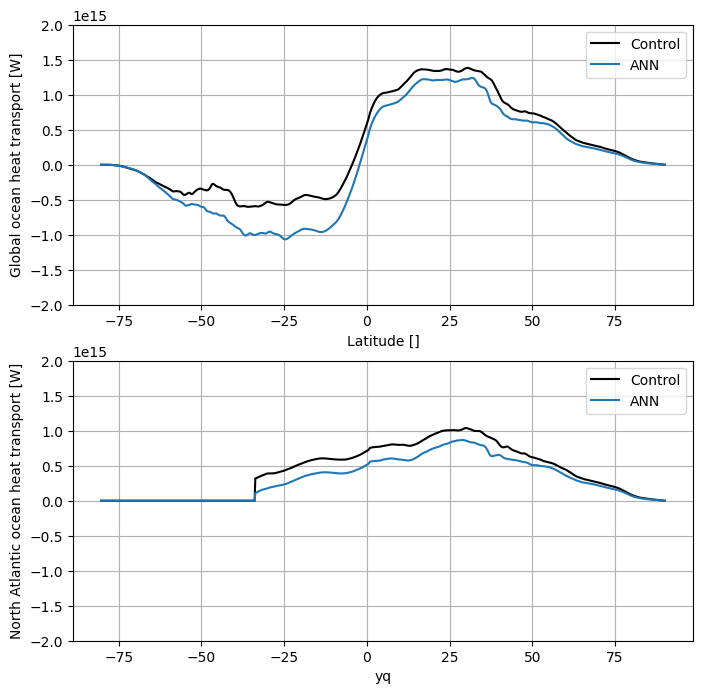

In [28]:
plt.figure(figsize=(8,8))

plt.subplot(2,1,1)
ds['unparameterized'].budget.T_ady_2d.mean('time').sum('xh').plot(color='k', label='Control')
ds['ANN'].budget.T_ady_2d.mean('time').sum('xh').plot(label='ANN')
plt.legend()
plt.grid()
plt.ylabel('Global ocean heat transport [W]')
plt.ylim([-2e+15, 2e+15])

NA_mask = ds['unparameterized'].AMOC_mask
plt.subplot(2,1,2)
(NA_mask*ds['unparameterized'].budget.T_ady_2d).mean('time').sum('xh').plot(color='k', label='Control')
(NA_mask*ds['ANN'].budget.T_ady_2d).mean('time').sum('xh').plot(label='ANN')
plt.legend()
plt.grid()
plt.ylabel('North Atlantic ocean heat transport [W]')
#plt.xlim([-30,None])
plt.ylim([-2e+15, 2e+15])

# Ice thickness

In [108]:
ice_ctrl = sort_longitude(ds['unparameterized'].ice.sithick.mean('time').rename({'xT': 'xh', 'yT': 'yh'})).compute()

In [109]:
ice_ann = sort_longitude(ds['ANN'].ice.sithick.mean('time').rename({'xT': 'xh', 'yT': 'yh'})).compute()

Text(0.5, 1.0, 'Control')

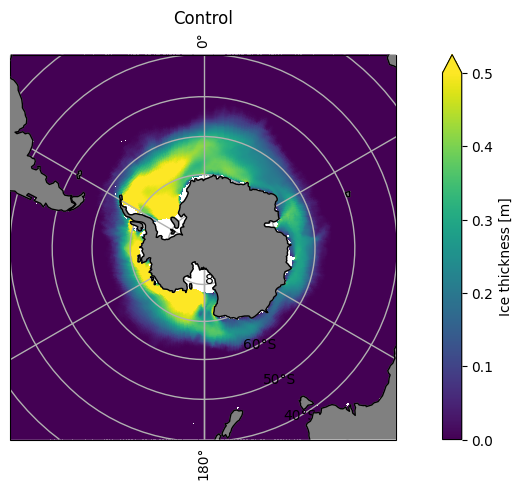

In [65]:
plot(ice_ctrl, regrid=regridder_simple, polar='South', land=True, gridlines=True, vmax=0.5, label='Ice thickness [m]')
plt.title('Control')

Text(0.5, 1.0, 'ANN')

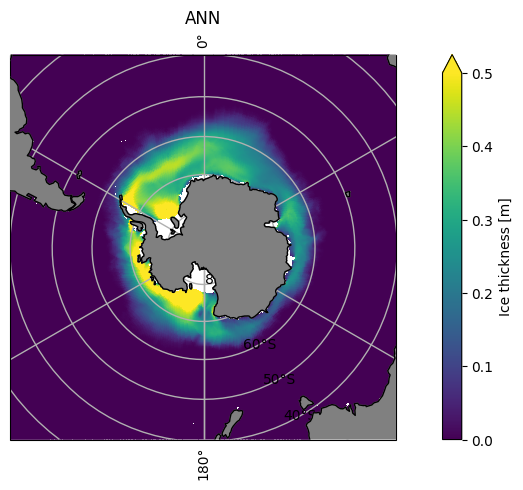

In [66]:
plot(ice_ann, regrid=regridder_simple, polar='South', land=True, gridlines=True, vmax=0.5, label='Ice thickness [m]')
plt.title('ANN')

Text(0.5, 1.0, 'ANN-Control')

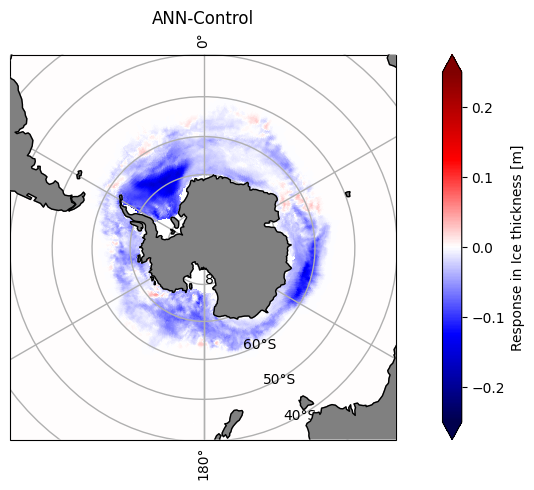

In [64]:
plot(ice_ann-ice_ctrl, regrid=regridder_simple, polar='South', cmap='seismic', land=True, gridlines=True, vmin=-0.25, vmax=0.25, label='Response in Ice thickness [m]')
plt.title('ANN-Control')

Text(0.5, 1.0, 'Control')

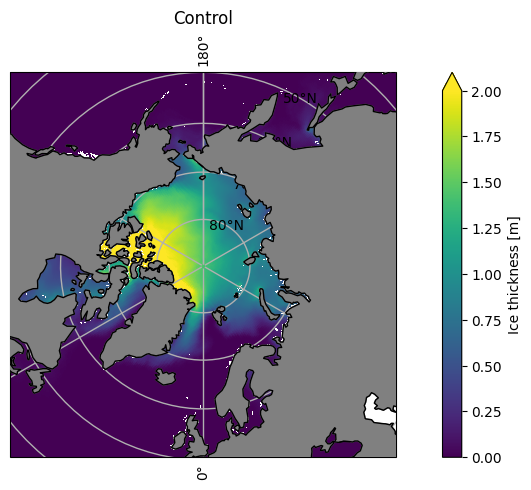

In [62]:
plot(ice_ctrl, regrid=regridder_simple, polar='North', land=True, gridlines=True, vmax=2, label='Ice thickness [m]')
plt.title('Control')

Text(0.5, 1.0, 'ANN')

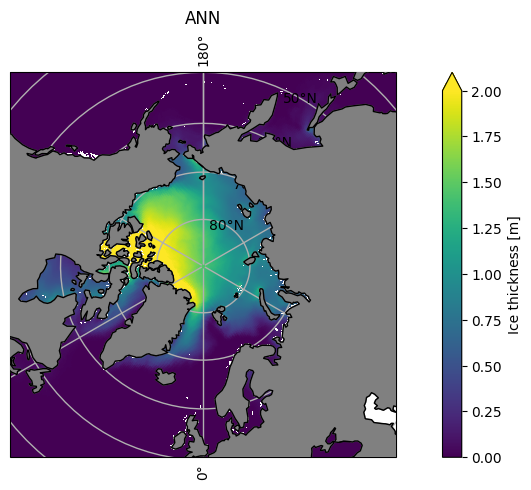

In [61]:
plot(ice_ann, regrid=regridder_simple, polar='North', land=True, gridlines=True, vmax=2, label='Ice thickness [m]')
plt.title('ANN')

Text(0.5, 1.0, 'ANN-Control')

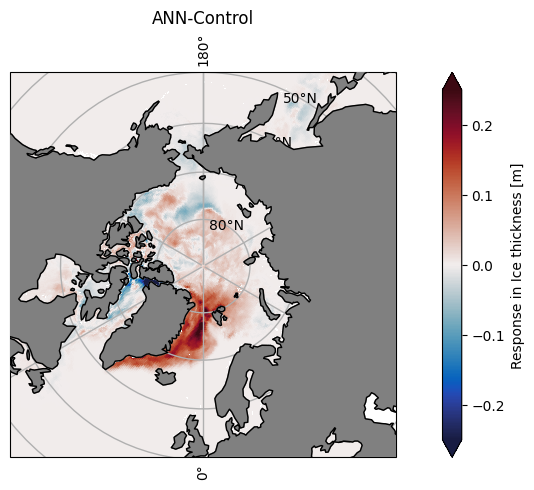

In [60]:
plot(ice_ann-ice_ctrl, regrid=regridder_simple, cmap=cmocean.cm.balance, polar='North', land=True, gridlines=True, vmin=-0.25, vmax=0.25, label='Response in Ice thickness [m]')
plt.title('ANN-Control')

# Comparison to Reanalysis

In [71]:
glorys = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/mercatorglorys12v1_gl12_mean_1993_2016_*.nc')
glorys_grid = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/GLO-MFC_001_030_coordinates.nc').drop_vars(['depth','latitude','longitude'])

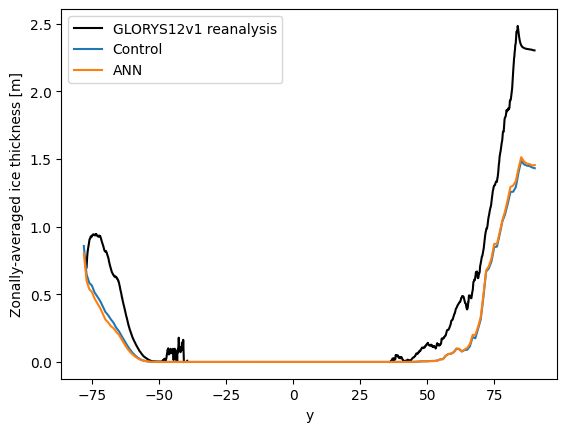

In [91]:
ice_ctrl = sort_longitude(ds['unparameterized'].ice.sithick.mean('time').rename({'xT': 'xh', 'yT': 'yh'})).compute()
ice_ann = sort_longitude(ds['ANN'].ice.sithick.mean('time').rename({'xT': 'xh', 'yT': 'yh'})).compute()

glorys.sithick.mean('time').mean('longitude').plot(color='k', label='GLORYS12v1 reanalysis')
regridder_1x1(ice_ctrl).mean('x').assign_coords({'y': np.linspace(-90,90,180)}).plot(label='Control')
regridder_1x1(ice_ann).mean('x').assign_coords({'y': np.linspace(-90,90,180)}).plot(label='ANN')
plt.ylabel('Zonally-averaged ice thickness [m]')
plt.legend()

# Movie of North Atlantic

In [3]:
glorys_tos = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/daily/sst*.nc').isel(depth=0).thetao.compute()

In [4]:
exp = ds['unparameterized']
ctrl_tos = select_NA_Marzocchi(exp.regrid(exp.ocean_daily.tos,exp.ocean_daily.tos)).compute()

In [5]:
exp = ds['ANN']
ann_tos = select_NA_Marzocchi(exp.regrid(exp.ocean_daily.tos,exp.ocean_daily.tos)).compute()

In [6]:
def plot(idx=0):
    plt.figure(figsize=(14,8))
    plt.subplot(2,2,1)
    glorys_tos.isel(time=idx).plot(vmin=-2,vmax=30, cmap=cmocean.cm.balance, add_colorbar=False)
    plt.title('GLORYS12v1 Reanalysis')
    plt.xlabel('')
    plt.ylabel('')
    plt.xlim([None,-20])
    plt.ylim([None,65])
    plt.gca().set_facecolor('gray')
    
    plt.subplot(2,2,3)
    ctrl_tos.isel(time=idx).plot(vmin=-2,vmax=30, cmap=cmocean.cm.balance, add_colorbar=False)
    plt.title('Unparameterized')
    plt.xlabel('')
    plt.ylabel('')
    plt.xlim([None,-20])
    plt.ylim([None,65])
    plt.gca().set_facecolor('gray')
    
    plt.subplot(2,2,2)
    im = ann_tos.isel(time=idx).plot(vmin=-2,vmax=30, cmap=cmocean.cm.balance, add_colorbar=False)
    plt.title('ANN')
    plt.xlabel('')
    plt.ylabel('')
    plt.xlim([None,-20])
    plt.ylim([None,65])
    plt.gca().set_facecolor('gray')
    
    plt.colorbar(im, ax=plt.gcf().axes, label='Sea Surface Temperature [$C^\circ$]')
    plt.suptitle(glorys_tos.isel(time=idx).time.values, y=0.95)

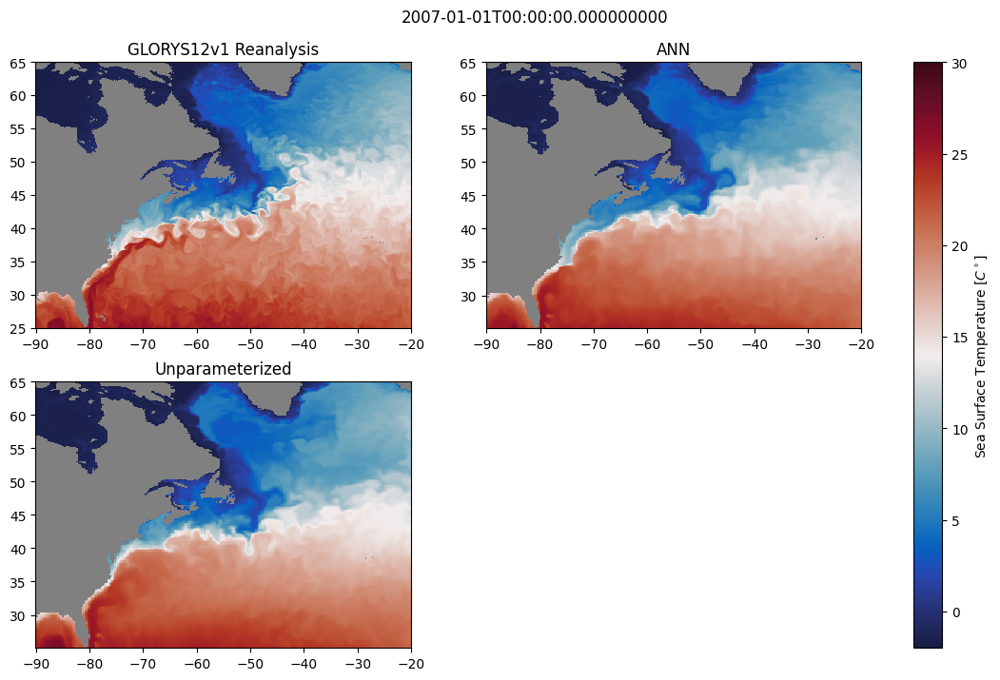

In [7]:
plot()

In [4]:
from helpers.plot_helpers import create_animation_ffmpeg
plot = lambda x: x
create_animation_ffmpeg(plot, range(365), 'SST-glorys.mp4', dpi=200, FPS=30)

Frames already exists in folder .ffmpeg/SST-glorys


Do you want to update snapshots?: [y/n] n


Frames are not updated

Native resolution of snapshots is used: 2098x1430

Animation SST-glorys.mp4 at FPS=30 will last for 12.2 seconds. The frames are saved to 
.ffmpeg/SST-glorys

Running the command:
cd /home/pp2681/global-runs/notebooks; ffmpeg -y -framerate 30 -i .ffmpeg/SST-glorys/frame-%d.png -s:v 2098x1430 -c:v libx264 -profile:v high -crf 20 -pix_fmt yuv420p SST-glorys.mp4


ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

# SSH in NA

In [98]:
glorys_zos = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/daily/NA_ssh_sso.nc').sel(longitude=slice(-85,-20),latitude=slice(25,65)).isel(depth=0).isel(time=slice(None,None,1)).zos.compute()

In [99]:
exp = ds['unparameterized']
ctrl_zos = (exp.regrid(exp.ocean_daily.zos,exp.ocean_daily.zos)).sel(xh=slice(-85,-20),yh=slice(25,65)).isel(time=slice(None,None,1)).compute()

In [100]:
exp = ds['ANN']
ann_zos = (exp.regrid(exp.ocean_daily.zos,exp.ocean_daily.zos)).sel(xh=slice(-85,-20),yh=slice(25,65)).isel(time=slice(None,None,1)).compute()

In [109]:
# Define the min, max, and center values
vmin, vmax, vcenter = -1.2, 1.2, 0.0

# Create a TwoSlopeNorm to ensure zero is at the center
from matplotlib.colors import TwoSlopeNorm
norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)

def plot(idx=0, fun=lambda x:x):
    plt.figure(figsize=(14,8))
    plt.subplot(2,2,1)
    fun(glorys_zos.isel(time=idx)).plot(norm=norm, cmap=cmocean.cm.balance, add_colorbar=False)
    plt.title('GLORYS12v1 Reanalysis')
    plt.xlabel('')
    plt.ylabel('')
    plt.gca().set_facecolor('gray')
    
    plt.subplot(2,2,3)
    fun(ctrl_zos.isel(time=idx)).plot(norm=norm, cmap=cmocean.cm.balance, add_colorbar=False)
    plt.title('Unparameterized')
    plt.xlabel('')
    plt.ylabel('')
    plt.gca().set_facecolor('gray')
    
    plt.subplot(2,2,2)
    im=fun(ann_zos.isel(time=idx)).plot(norm=norm, cmap=cmocean.cm.balance, add_colorbar=False)
    plt.title('ANN')
    plt.xlabel('')
    plt.ylabel('')
    plt.gca().set_facecolor('gray')
    
    plt.colorbar(im, ax=plt.gcf().axes, label='Sea Surface Height (ZOS) [m]')
    try:
        if fun(1)==1:
            plt.suptitle(glorys_zos.isel(time=idx).time.values, y=0.95)
    except:
        pass

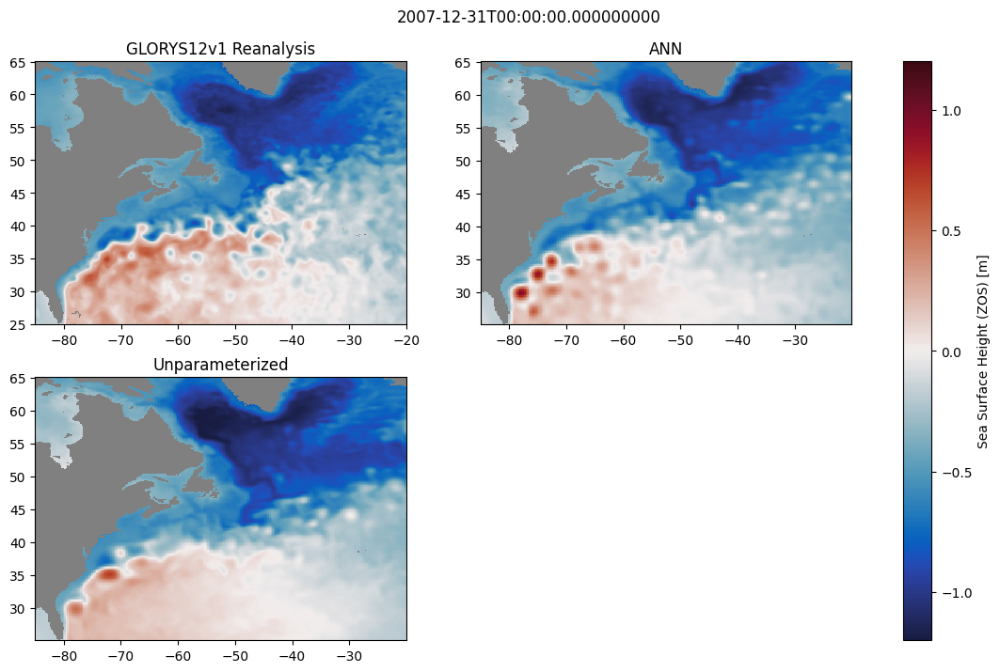

In [110]:
plot(-1)

In [11]:
# Check that vertical line above is just coordinate issue
data = select_NA(ds['ANN'].ocean_daily.zos).sel(xh=slice(-85,-65), yh=slice(25,40)).drop_vars(['xh','yh']).compute()

In [14]:
def plot(idx=-1):
    data.isel(time=idx).plot()

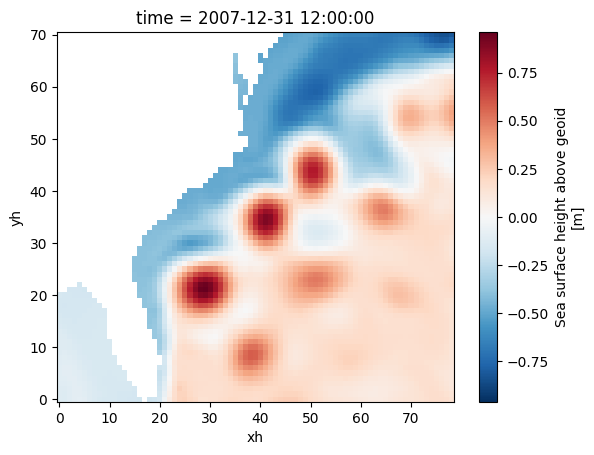

In [15]:
plot()

In [16]:
from helpers.plot_helpers import create_animation_ffmpeg
create_animation_ffmpeg(plot, range(365), 'SSH-glorys-zoom-interp.mp4', dpi=200, FPS=30)

Native resolution of snapshots is used: 1190x9081

Animation SSH-glorys-zoom-interp.mp4 at FPS=30 will last for 12.2 seconds. The frames are saved to 
.ffmpeg/SSH-glorys-zoom-interp

Running the command:
cd /home/pp2681/global-runs/notebooks; ffmpeg -y -framerate 30 -i .ffmpeg/SSH-glorys-zoom-interp/frame-%d.png -s:v 1190x908 -c:v libx264 -profile:v high -crf 20 -pix_fmt yuv420p SSH-glorys-zoom-interp.mp4


ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

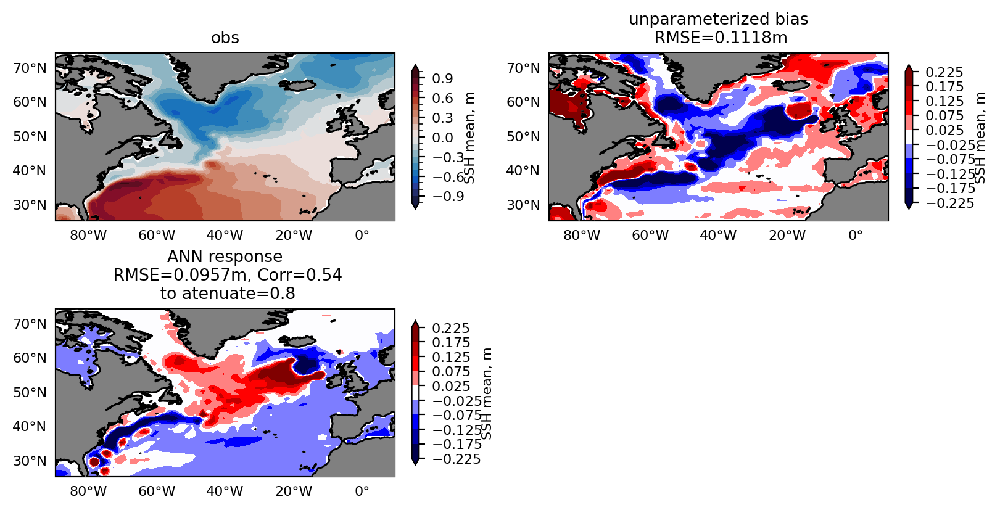

In [117]:
ds.plot_ssh_mean(['obs','unparameterized','ANN'], select=select_NA_Marzocchi, plot_type='response')

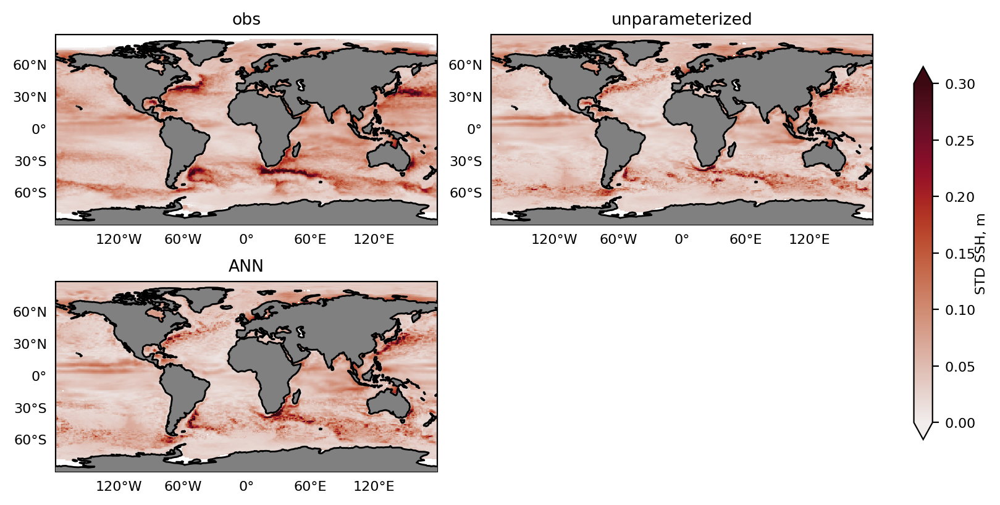

In [120]:
ds.plot_ssh_std(['obs','unparameterized','ANN'], select=select_globe, plot_type='default')

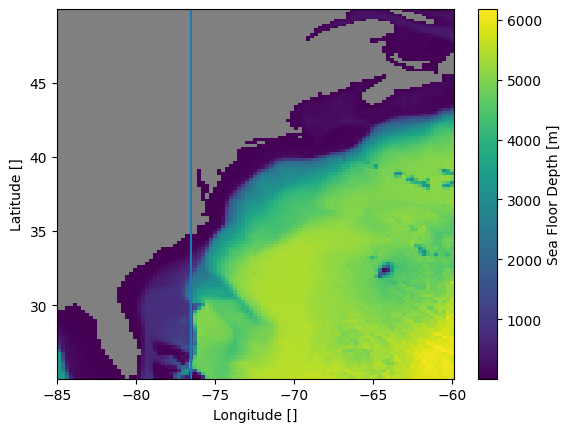

In [97]:
ds['ANN'].param.deptho.sel(xh=slice(-85,-60),yh=slice(25,50)).plot()
plt.gca().set_facecolor('gray')
plt.axvline(x=-76.5)

In [56]:
from helpers.plot_helpers import create_animation_ffmpeg
create_animation_ffmpeg(plot, range(365), 'SSH-glorys-zoom.mp4', dpi=200, FPS=30)

Frames already exists in folder .ffmpeg/SSH-glorys-zoom


Do you want to update snapshots?: [y/n] y


Native resolution of snapshots is used: 2126x1430

Animation SSH-glorys-zoom.mp4 at FPS=30 will last for 12.2 seconds. The frames are saved to 
.ffmpeg/SSH-glorys-zoom

Running the command:
cd /home/pp2681/global-runs/notebooks; ffmpeg -y -framerate 30 -i .ffmpeg/SSH-glorys-zoom/frame-%d.png -s:v 2126x1430 -c:v libx264 -profile:v high -crf 20 -pix_fmt yuv420p SSH-glorys-zoom.mp4


ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

# SSH mean, std for these movies

# Temperature in Southern ocean

In [9]:
glorys_tos = xr.open_mfdataset('/vast/pp2681/GLORYS12v1/daily/SO_sst.nc').isel(depth=0).isel(time=slice(None,None,2)).thetao.compute()

In [16]:
exp = ds['unparameterized']
ctrl_tos = exp.ocean_daily.tos.sel(yh=slice(-80,-40)).isel(time=slice(None,None,2)).compute()

In [17]:
exp = ds['ANN']
ann_tos = exp.ocean_daily.tos.sel(yh=slice(-80,-40)).isel(time=slice(None,None,2)).compute()

In [43]:
def plot(idx=0):
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(2,2,1, projection=ccrs.SouthPolarStereo())
    glorys_tos.isel(time=idx).plot(vmin=-2,vmax=20, cmap=cmocean.cm.balance, add_colorbar=False, transform=ccrs.PlateCarree())
    plt.title('GLORYS12v1 Reanalysis')

    ax = fig.add_subplot(2,2,3, projection=ccrs.SouthPolarStereo())
    ctrl_tos.isel(time=idx).plot(vmin=-2,vmax=20, cmap=cmocean.cm.balance, add_colorbar=False, transform=ccrs.PlateCarree())
    plt.title('Unparameterized')

    ax = fig.add_subplot(2,2,2, projection=ccrs.SouthPolarStereo())
    im = ann_tos.isel(time=idx).plot(vmin=-2,vmax=20, cmap=cmocean.cm.balance, add_colorbar=False, transform=ccrs.PlateCarree())
    plt.title('ANN')

    plt.colorbar(im, ax=plt.gcf().axes, label='Sea Surface Temperature [$C^\circ$]')
    plt.suptitle(glorys_tos.isel(time=idx).time.values, y=0.95)

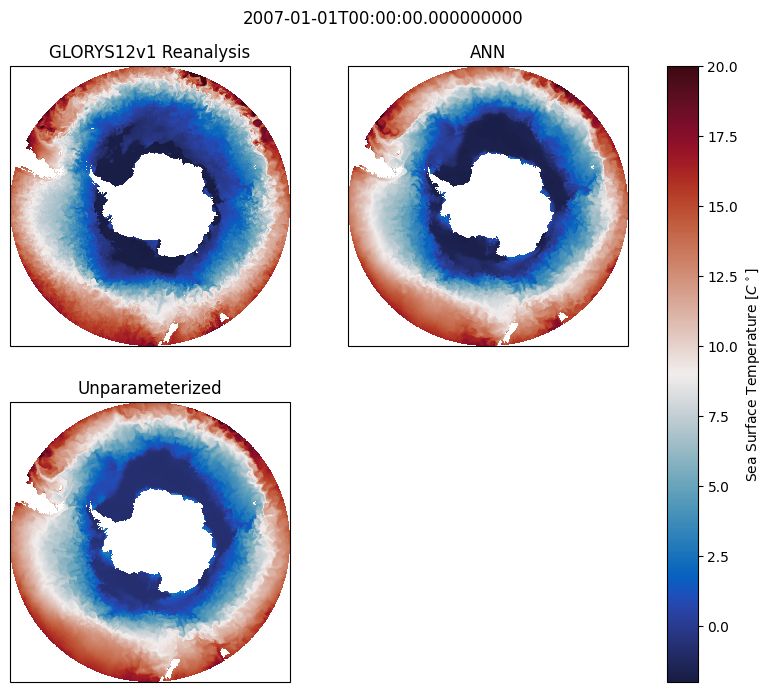

In [42]:
plot()

In [40]:
from helpers.plot_helpers import create_animation_ffmpeg
create_animation_ffmpeg(plot, range(183), 'SST-glorys-SO.mp4', dpi=200, FPS=18)

Native resolution of snapshots is used: 1540x1384

Animation SST-glorys-SO.mp4 at FPS=18 will last for 10.2 seconds. The frames are saved to 
.ffmpeg/SST-glorys-SO

Running the command:
cd /home/pp2681/global-runs/notebooks; ffmpeg -y -framerate 18 -i .ffmpeg/SST-glorys-SO/frame-%d.png -s:v 1540x1384 -c:v libx264 -profile:v high -crf 20 -pix_fmt yuv420p SST-glorys-SO.mp4


ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

# MLD versus ice thickness

In [16]:
import matplotlib.colors as mcolors
norm = mcolors.SymLogNorm(linthresh=10, linscale=0.1, vmin=-1500, vmax=1500)

In [24]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    MLD_winter_ctrl = ds['unparameterized'].ocean_month.MLD_003.sel(time=slice('1981', '2007')).groupby('time.month').mean().max('month').compute()

[########################################] | 100% Completed | 12.17 s
[########################################] | 100% Completed | 24.51 s


In [25]:
with ProgressBar():
    MLD_winter_ann = ds['ANN'].ocean_month.MLD_003.sel(time=slice('1981', '2007')).groupby('time.month').mean().max('month').compute()

[########################################] | 100% Completed | 13.36 s
[########################################] | 100% Completed | 22.90 s


Text(0.5, 1.0, 'Diagnosed from WOA')

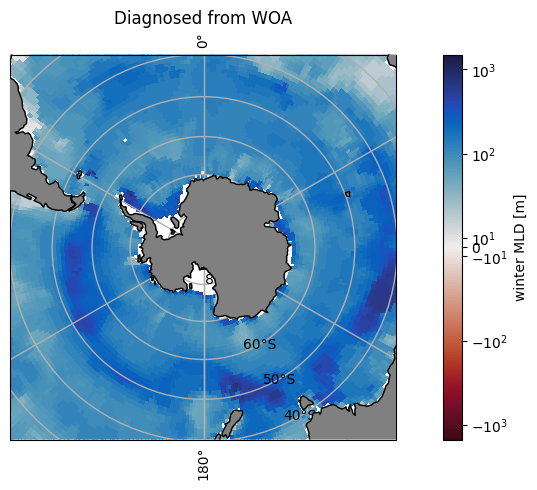

In [26]:
plot(MLD_winter_woa, regrid=lambda x:x, vmax=None,vmin=None, cmap=cmocean.cm.balance_r, polar='South', gridlines=True, land=True, norm=norm, 
     label='winter MLD [m]')
plt.title('Diagnosed from WOA')

Text(0.5, 1.0, 'Unparameterized')

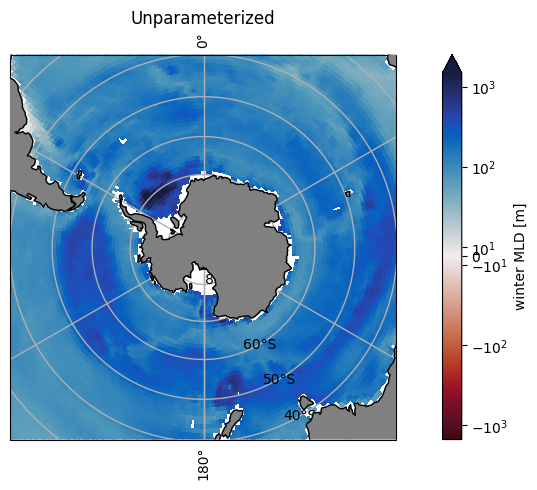

In [29]:
plot(MLD_winter_ctrl, regrid=regridder_1x1, vmax=None,vmin=None, cmap=cmocean.cm.balance_r, polar='South', gridlines=True, land=True, norm=norm,
    label='winter MLD [m]')
plt.title('Unparameterized')

Text(0.5, 1.0, 'ANN')

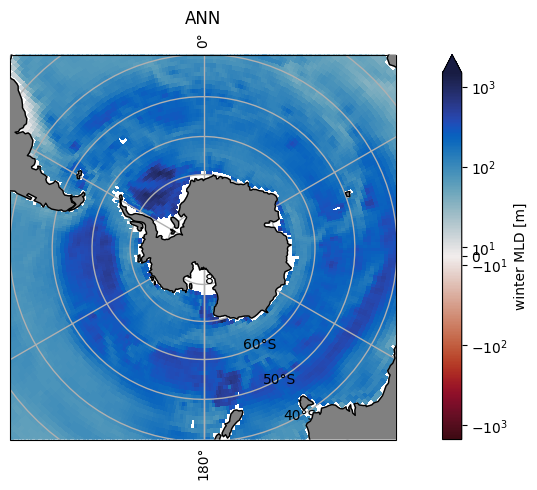

In [30]:
plot(MLD_winter_ann, regrid=regridder_1x1, vmax=None,vmin=None, cmap=cmocean.cm.balance_r, polar='South', gridlines=True, land=True, norm=norm,
    label='winter MLD [m]')
plt.title('ANN')

Text(0.5, 1.0, 'ANN-Unparameterized')

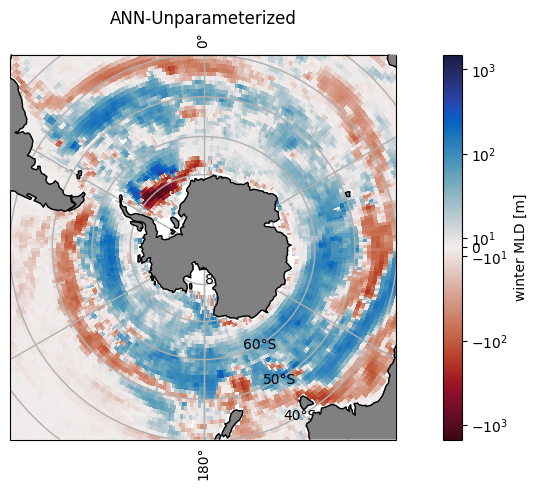

In [32]:
plot(MLD_winter_ann-MLD_winter_ctrl, regrid=regridder_1x1, vmax=None,vmin=None, cmap=cmocean.cm.balance_r, polar='South', gridlines=True, land=True, norm=norm,
    label='winter MLD [m]')
plt.title('ANN-Unparameterized')

In [42]:
from dask.diagnostics import ProgressBar
with ProgressBar():
    MLD_winter_ctrl = ds['unparameterized'].ocean_month.MLD_003.sel(time=slice('1948', '1952')).groupby('time.month').mean().max('month').compute()

[########################################] | 100% Completed | 4.33 sms


In [43]:
with ProgressBar():
    MLD_winter_ann = ds['ANN'].ocean_month.MLD_003.sel(time=slice('1948', '1952')).groupby('time.month').mean().max('month').compute()

[########################################] | 100% Completed | 1.51 sms


Text(0.5, 1.0, 'ANN-Unparameterized')

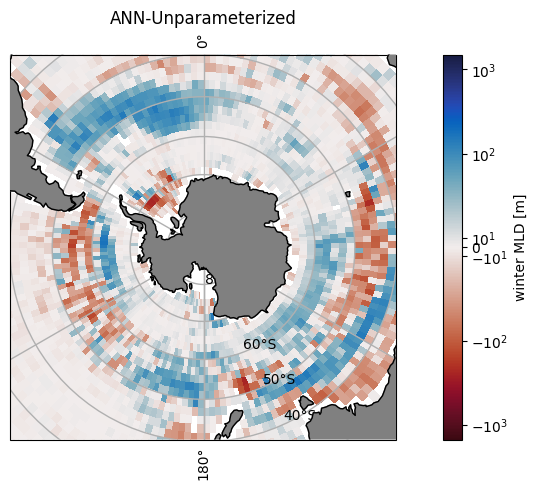

In [44]:
plot(MLD_winter_ann-MLD_winter_ctrl, regrid=regridder_2x2, vmax=None,vmin=None, cmap=cmocean.cm.balance_r, polar='South', gridlines=True, land=True, norm=norm,
    label='winter MLD [m]')
plt.title('ANN-Unparameterized')

# SST biases in Polar coordinates

In [22]:
sst_obs = ds['ANN'].woa_temp.isel(zl=0).rename({'xh': 'lon', 'yh': 'lat'}).compute()
sst_ctrl = ds['unparameterized'].thetao.isel(zl=0).rename({'xh': 'lon', 'yh': 'lat'}).sel(time=slice('1981','2007')).mean('time').compute()
sst_ann = ds['ANN'].thetao.isel(zl=0).rename({'xh': 'lon', 'yh': 'lat'}).sel(time=slice('1981','2007')).mean('time').compute()

Text(0.5, 1.0, 'WOA')

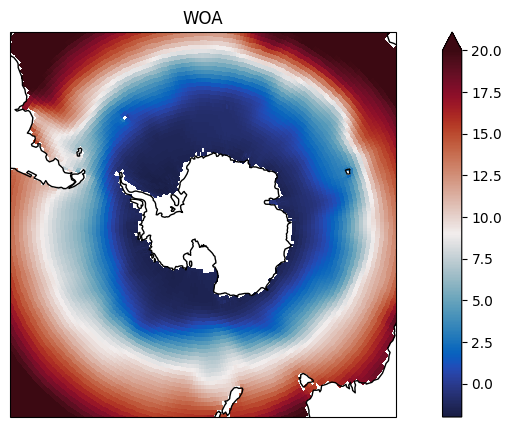

In [23]:
plot(sst_obs, lambda x:x, polar='South', vmin=-2, vmax=20, cmap=cmocean.cm.balance)
plt.title('WOA')

Text(0.5, 1.0, 'Unparameterized')

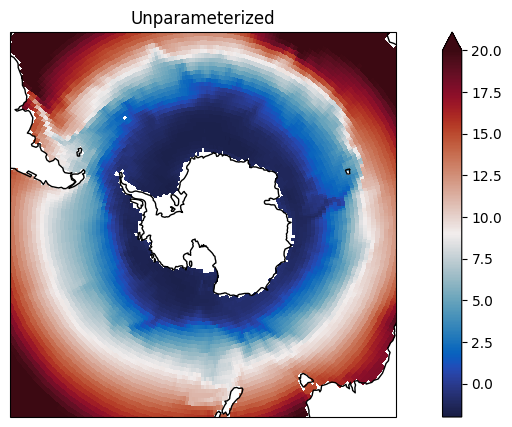

In [24]:
plot(sst_ctrl, lambda x:x, polar='South', vmin=-2, vmax=20, cmap=cmocean.cm.balance)
plt.title('Unparameterized')

Text(0.5, 1.0, 'ANN')

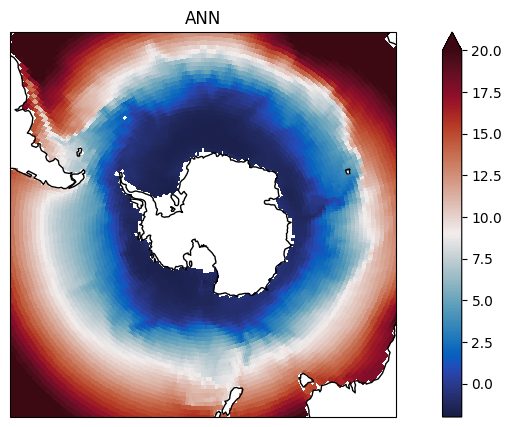

In [26]:
plot(sst_ann, lambda x:x, polar='South', vmin=-2, vmax=20, cmap=cmocean.cm.balance)
plt.title('ANN')

Text(0.5, 1.0, 'ANN-Unparameterized')

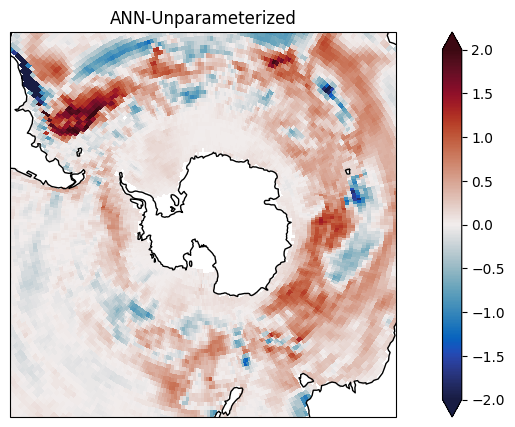

In [29]:
plot(sst_ann-sst_ctrl, lambda x:x, polar='South', vmin=-2, vmax=2, cmap=cmocean.cm.balance)
plt.title('ANN-Unparameterized')

Text(0.5, 1.0, 'Unparameterized-obs')

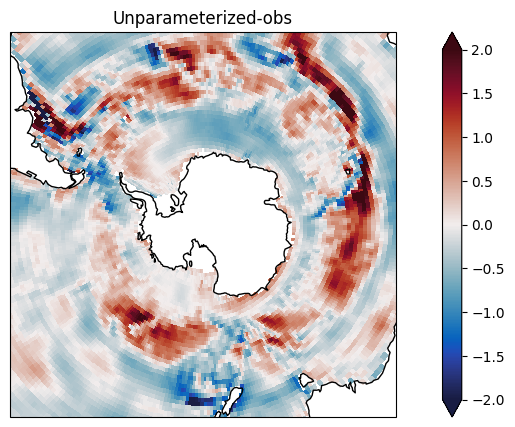

In [31]:
plot(sst_ctrl-sst_obs, lambda x:x, polar='South', vmin=-2, vmax=2, cmap=cmocean.cm.balance)
plt.title('Unparameterized-obs')

# AMOC from velocities

In [3]:
data = xr.Dataset()
exp = ds['unparameterized']
data['umo'] = exp.ocean_annual_z.umo
data['vmo'] = exp.ocean_annual_z.vmo
data['z_i'] = exp.ocean_annual_z.zi.rename({'zi':'z_i'})
dsgrid = exp.param
data = data.rename({'zl': 'z_l'})

In [4]:
from xoverturning import calcmoc

In [5]:
amoc_umo = calcmoc(data, dsgrid=dsgrid, basin='atl-arc')

generating basin codes


In [19]:
data_new = xr.Dataset()
data_new['umo'] = exp.ocean_annual_z.uo * 1e+3 * exp.param.dxCu * exp.dz
data_new['vmo'] = exp.ocean_annual_z.vo * 1e+3 * exp.param.dyCv * exp.dz
data_new['z_i'] = exp.ocean_annual_z.zi.rename({'zi':'z_i'})
data_new = data_new.rename({'zl': 'z_l'})

In [20]:
amoc_uo = calcmoc(data_new, dsgrid=dsgrid, basin='atl-arc')

generating basin codes


Text(0.5, 1.0, 'AMOC from velocity')

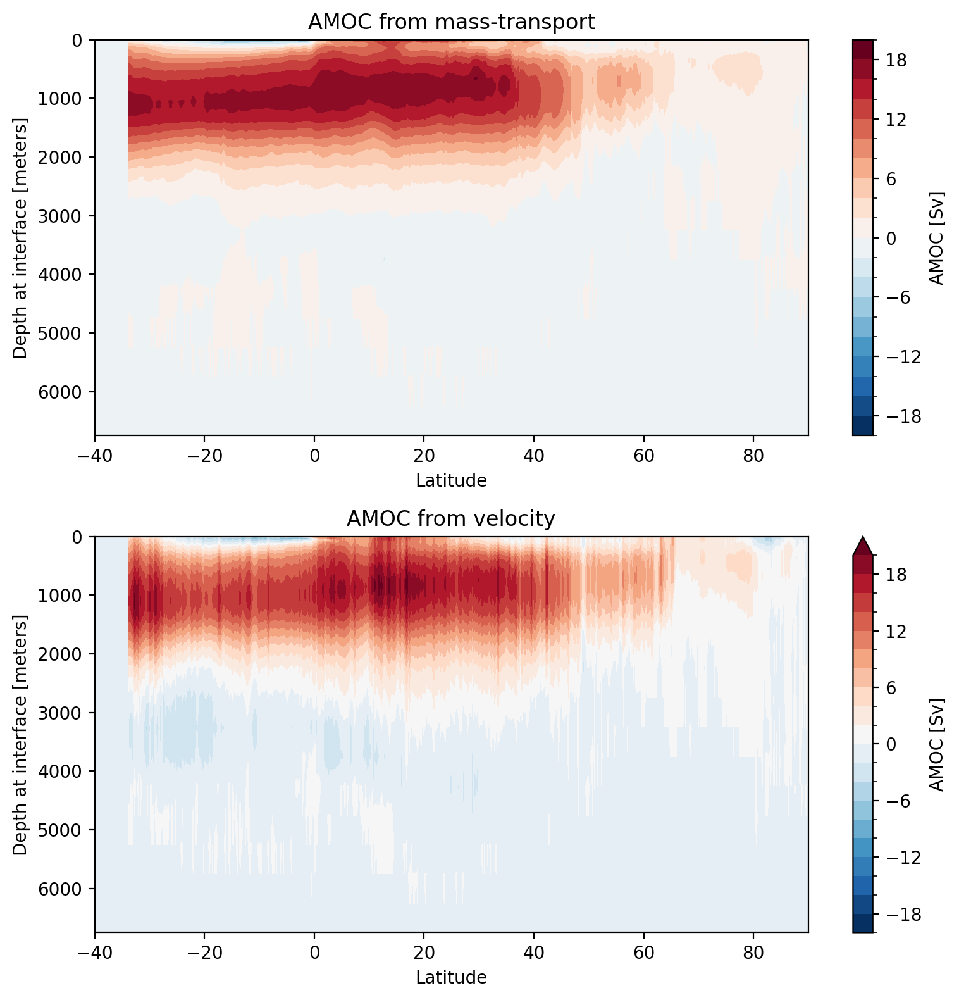

In [23]:
plt.figure(figsize=(8,8), dpi=200)
plt.subplot(2,1,1)
#amoc_umo[-1].plot.contour(levels=np.arange(-20,22,2), colors='k', linewidth=0.05)
amoc_umo[-1].plot.contourf(levels=np.arange(-20,22,2), cbar_kwargs={'label': 'AMOC [Sv]'})
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlabel('Latitude')
plt.xlim([-40,None])
plt.title('AMOC from mass-transport')

plt.subplot(2,1,2)
#amoc_uo[-1].plot.contour(levels=np.arange(-20,22,2), colors='k', linewidth=0.05)
amoc_uo[-1].plot.contourf(levels=np.arange(-20,22,2), cbar_kwargs={'label': 'AMOC [Sv]'})
plt.gca().invert_yaxis()
plt.tight_layout()
plt.xlabel('Latitude')
plt.xlim([-40,None])
plt.title('AMOC from velocity')

In [25]:
AMOC_mask = exp.AMOC_mask

generating basin codes


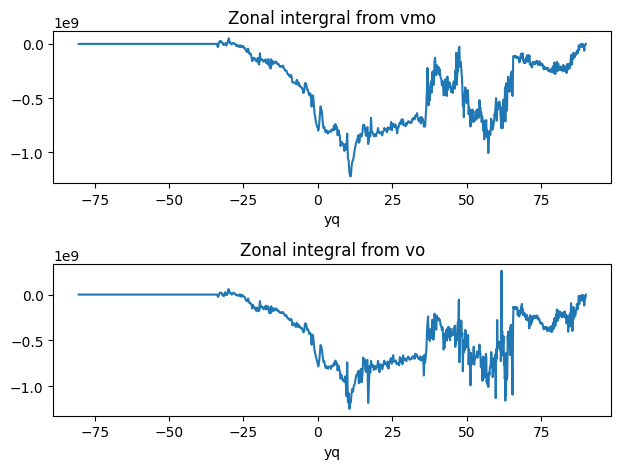

In [35]:
plt.subplot(2,1,1)
(data['vmo'] * AMOC_mask).isel(time=-1).sum('xh').isel(z_l=20).plot()
plt.title('Zonal intergral from vmo')
plt.subplot(2,1,2)
(data_new['vmo'] * AMOC_mask).isel(time=-1).sum('xh').isel(z_l=20).plot()
plt.title('Zonal integral from vo')
plt.tight_layout()

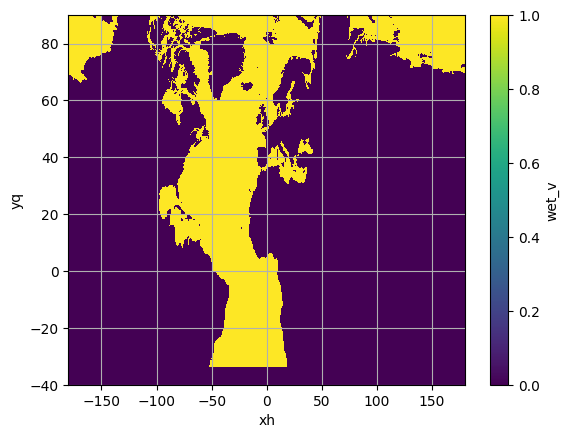

In [41]:
AMOC_mask.plot()
plt.ylim([-40,90])
plt.grid()